**AI project 1**
To understand the features please check:
https://pyradiomics.readthedocs.io/en/latest/features.html#radiomics.firstorder.RadiomicsFirstOrder

The general steps to work with this project are:

I. Preprocessing (Cleaning)
We have already processed data, but still is needed to check how clean the data is.
    . Check for nulls.
    . Check for blank spaces.
    . Check for duplicates.
    . Check for ctagorical values.
    . Normalize: Here we used 3 ways; 1 using the formular of scaler manually, 2 using the mean, 3 using the library scalerminmax from sklearn.

II. Splitting the sets into: Training set, Validation set, Test set.

III. Training Models with all the featuresvalidating the data with fast imrpovements and : Logistic Regression, Decision Tree Classifier, Random Forest Classifier, SVM, Bayesian Classifier and Neural Network.

IV. Apply Feature Selection
We were checking different methodologies because we have continious samples, so, as a first try we will normalize the data if it is needed, then we will train a Model with all the data and filtered data to compair the results (the filter metho will be coefficient correlation).

V. Training Models with feature selected, now after doing the feature selection is possible to visualize the data because we will have shorter amount of features, so we can see some co-relations.

VI. Validate the models

VII. Improve the results by using SearchGrid

VIII. Dimentionally Reduction PCA

IV. Training Models after grouping by ID and obtaining the mean of each feature

In [3]:
# Importing some packages / libraries that we will use during the project.
import os #provides functions for interacting with the operating system
import numpy as np 
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib

#For plotting.
from matplotlib import pyplot as plt
import matplotlib.colors as mcolors
import plotly.express as px
import seaborn as sns
%matplotlib inline

#For preprocessing and training the model.
from sklearn import preprocessing
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn import svm
from sklearn.ensemble import RandomForestClassifier

#For feature selection
from sklearn.feature_selection import VarianceThreshold

#For validate the results.
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from sklearn.metrics import classification_report 
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score, explained_variance_score, confusion_matrix, accuracy_score, classification_report, log_loss

#For NN
#import tensorflow as tf
#%tensorflow_version 1.x
#import keras.backend as K
#from keras.models import Sequential
#from keras.layers import Dense
#from keras.optimizers import Adam
#from keras.callbacks import EarlyStopping
#from keras.utils import to_categorical
#import keras
#from keras.layers import Dense, Activation, Dropout

#Extra
from math import sqrt


In [4]:
#from google.colab import drive
#drive.mount('/content/drive')

In [5]:
#Reading the dataset.
df = pd.read_csv('Reduced Features for TAI project.csv')

In [6]:
df

,Patient ID,original_shape_Elongation,original_firstorder_Kurtosis,original_firstorder_Skewness,wavelet-LHL_glrlm_RunVariance,wavelet2-LHL_gldm_LargeDependenceEmphasis,wavelet2-LLH_gldm_LargeDependenceEmphasis,wavelet-LHL_gldm_LargeDependenceEmphasis,wavelet2-LHL_gldm_DependenceVariance,wavelet2-LHL_glrlm_RunVariance,...,wavelet-LLL_glszm_LargeAreaLowGrayLevelEmphasis,wavelet2-HHH_firstorder_RootMeanSquared,wavelet2-LLH_firstorder_Kurtosis,wavelet-HHL_glcm_Imc2,wavelet2-LHH_firstorder_RobustMeanAbsoluteDeviation,original_shape_SphericalDisproportion,wavelet2-HHL_glcm_Idmn,wavelet2-LHH_firstorder_RootMeanSquared,wavelet2-HLL_firstorder_Maximum,Label
0,1,0.661690,2.817688,0.769536,7.257078,3381.734540,3715.077716,3546.818663,634.748331,6.682128,...,4005.210235,0.408974,2.949406,0.231474,0.473838,1.572473,0.983853,0.875074,142.866201,0
1,1,0.750849,2.084800,0.442780,3.137745,2653.808184,1443.697357,2297.305200,616.359443,4.095513,...,32.058217,0.282009,2.790798,0.010531,0.401979,1.178144,0.905124,0.696716,21.693040,0
2,1,0.619781,2.590759,0.384512,7.005413,3551.125894,3568.780890,3342.865490,426.661231,8.535867,...,63032.030210,0.442902,3.211156,0.276207,0.446076,1.615550,0.993054,0.832938,163.039718,0
3,2,0.388733,2.932863,0.738215,2.178815,1564.039548,1370.065913,1839.930320,318.122386,1.939531,...,147.649047,0.330143,3.054401,0.023870,0.399957,1.306885,0.911141,0.727764,22.979554,0
4,2,0.820531,2.814081,0.773252,1.316850,1377.981413,1005.602230,1164.799257,325.473446,1.726775,...,65.872763,0.278449,2.074076,0.016973,0.350459,1.165727,0.906515,0.606753,24.490320,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3557,96,0.225097,3.145095,0.887252,0.507042,113.521739,63.289855,158.304348,21.194707,0.420766,...,22.156250,0.148424,2.383944,0.025038,0.236198,1.412431,0.924402,0.649229,27.270149,1
3558,96,0.503842,2.484876,0.655281,4.641217,2475.349595,2771.461923,2684.326511,574.123960,4.591888,...,450.172765,0.403421,3.311709,0.546492,0.400437,1.494975,0.992242,0.734152,288.610250,1
3559,96,0.454726,3.363199,1.026167,6.014596,3310.430153,1430.379898,3536.925043,548.184562,5.595325,...,336.564815,0.114790,3.124013,0.028680,0.319474,1.609656,0.895515,0.566488,14.823064,1
3560,96,0.624101,2.205947,0.349004,1.626775,921.056338,280.690141,1045.957746,148.842690,1.583895,...,14.416448,0.131801,2.174953,0.072674,0.254557,1.280580,0.895171,0.542009,15.171972,1


# I. Preprocessing
As we defined before, we will check how clean is the dataset.
1. Looking for nulls.
2. Looking for blank spaces.
3. Looking for repetitive columns (duplicates).
4. Checking for categorical features.

In [7]:
#1. To look for nulls we making a first visual inspection
# We will get a True when the data is null or we can use the next command df.isnull() to have the same result.
pd.isnull(df) 

,Patient ID,original_shape_Elongation,original_firstorder_Kurtosis,original_firstorder_Skewness,wavelet-LHL_glrlm_RunVariance,wavelet2-LHL_gldm_LargeDependenceEmphasis,wavelet2-LLH_gldm_LargeDependenceEmphasis,wavelet-LHL_gldm_LargeDependenceEmphasis,wavelet2-LHL_gldm_DependenceVariance,wavelet2-LHL_glrlm_RunVariance,...,wavelet-LLL_glszm_LargeAreaLowGrayLevelEmphasis,wavelet2-HHH_firstorder_RootMeanSquared,wavelet2-LLH_firstorder_Kurtosis,wavelet-HHL_glcm_Imc2,wavelet2-LHH_firstorder_RobustMeanAbsoluteDeviation,original_shape_SphericalDisproportion,wavelet2-HHL_glcm_Idmn,wavelet2-LHH_firstorder_RootMeanSquared,wavelet2-HLL_firstorder_Maximum,Label
0,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
1,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
3,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
4,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3557,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
3558,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
3559,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
3560,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False


In [8]:
#Another way to check nulls is to count: how many nulls we have per column?
df.isnull().sum().head(50)


Patient ID                                                      0
original_shape_Elongation                                       0
original_firstorder_Kurtosis                                    0
original_firstorder_Skewness                                    0
wavelet-LHL_glrlm_RunVariance                                   0
wavelet2-LHL_gldm_LargeDependenceEmphasis                       0
wavelet2-LLH_gldm_LargeDependenceEmphasis                       0
wavelet-LHL_gldm_LargeDependenceEmphasis                        0
wavelet2-LHL_gldm_DependenceVariance                            0
wavelet2-LHL_glrlm_RunVariance                                  0
wavelet-LHL_glrlm_LongRunEmphasis                               0
wavelet-LHH_glrlm_LongRunEmphasis                               0
wavelet-LHH_glrlm_RunPercentage                                 0
wavelet2-LLH_glrlm_RunVariance                                  0
wavelet-LHH_glrlm_RunLengthNonUniformityNormalized              0
wavelet-HH

In [9]:
#We can also check how many nulls we have per row.
df.isnull().sum(axis=1)

0       0
1       0
2       0
3       0
4       0
       ..
3557    0
3558    0
3559    0
3560    0
3561    0
Length: 3562, dtype: int64

In [10]:
#Finally we check the complete dataframe for finding nulls 
#The tests before allowed us to practice and undertand more the data.
df.isnull().sum().sum()
#So, yes, it is proved, there is no null spaces.

0

In [11]:
#Another way to check nulls is to loop all the columns and create another dataframe with nulls,
#If there is not nulls "dfnulls" will be empty.
mask = False
for col in df.columns: 
    mask = mask | df[col].isnull()
dfnulls = df[mask]
dfnulls

,Patient ID,original_shape_Elongation,original_firstorder_Kurtosis,original_firstorder_Skewness,wavelet-LHL_glrlm_RunVariance,wavelet2-LHL_gldm_LargeDependenceEmphasis,wavelet2-LLH_gldm_LargeDependenceEmphasis,wavelet-LHL_gldm_LargeDependenceEmphasis,wavelet2-LHL_gldm_DependenceVariance,wavelet2-LHL_glrlm_RunVariance,...,wavelet-LLL_glszm_LargeAreaLowGrayLevelEmphasis,wavelet2-HHH_firstorder_RootMeanSquared,wavelet2-LLH_firstorder_Kurtosis,wavelet-HHL_glcm_Imc2,wavelet2-LHH_firstorder_RobustMeanAbsoluteDeviation,original_shape_SphericalDisproportion,wavelet2-HHL_glcm_Idmn,wavelet2-LHH_firstorder_RootMeanSquared,wavelet2-HLL_firstorder_Maximum,Label


In [12]:
#.Looking for repetitive features.
#Now, it is time to check how many features we have.
#Checking the info we can see that there are 152 columns, but in the description of the problem just 150 columns are mentioned, so we will check this deeper.
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3562 entries, 0 to 3561
Columns: 152 entries, Patient ID to Label
dtypes: float64(150), int64(2)
memory usage: 4.1 MB


In [13]:
#We need to check if there are duplicates, using the function ".duplicated" we are comparing the features names to check if there are some duplicates, but
# we realized that is putting 1 at the end of the name when finds a duplicated, so will not give exact results.
df.columns.duplicated() 


array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False,

In [14]:
#The next code to find nulls in the features will show how ".1" was added at the end of a feature name when finding duplicates.
# Duplicated features are: original_kurtosis_Skewness.1, original_firstorder_Skewness.1
columns = df.columns
columns
for column in columns:
  if not column:
    print("null")
  else:
    print(column)


Patient ID
original_shape_Elongation
original_firstorder_Kurtosis
original_firstorder_Skewness
wavelet-LHL_glrlm_RunVariance
wavelet2-LHL_gldm_LargeDependenceEmphasis
wavelet2-LLH_gldm_LargeDependenceEmphasis
wavelet-LHL_gldm_LargeDependenceEmphasis
wavelet2-LHL_gldm_DependenceVariance
wavelet2-LHL_glrlm_RunVariance
wavelet-LHL_glrlm_LongRunEmphasis
wavelet-LHH_glrlm_LongRunEmphasis
wavelet-LHH_glrlm_RunPercentage
wavelet2-LLH_glrlm_RunVariance
wavelet-LHH_glrlm_RunLengthNonUniformityNormalized
wavelet-HHH_glrlm_LongRunEmphasis
wavelet-LHH_glrlm_RunVariance
wavelet2-LLH_glrlm_LongRunEmphasis
wavelet2-LHL_glrlm_LongRunEmphasis
wavelet-HHH_glrlm_RunVariance
wavelet2-LHH_glrlm_LongRunEmphasis
wavelet2-LHH_glrlm_RunPercentage
wavelet-LHL_glrlm_RunPercentage
wavelet-HHH_glrlm_RunLengthNonUniformityNormalized
wavelet2-HHH_glrlm_RunLengthNonUniformityNormalized
wavelet2-HHH_glrlm_RunPercentage
wavelet-LHH_glrlm_LongRunLowGrayLevelEmphasis
wavelet2-LLH_glrlm_RunPercentage
wavelet-LHH_glrlm_Sho

In [15]:
#The next code is another way to find duplicate features,but as long as df.columns put ".1" at the end when name features were duplicated, 
#this method will not work, it is important to be aware of this detail.
for i in range(len(columns)):
  for j in range(len(columns)-1):
     if((columns[i]==columns[j]) and i!=j):
      print(columns[i])
      print(columns[j])
         
    

In [16]:
#So, finally
#To recognize the duplicates we will use nested loops (not taking the variable columns anymore as we explain lines before).

duplicates = []
for col in range(df.shape[1]):
    contents = df.iloc[:, col]
    
    for comp in range(col + 1, df.shape[1]):
        if contents.equals(df.iloc[:, comp]):
            duplicates.append(comp)
            if (duplicates):
              print(contents)
duplicates = np.unique(duplicates).tolist()
#2 columns are duplicated .
  


0       2.817688
1       2.084800
2       2.590759
3       2.932863
4       2.814081
          ...   
3557    3.145095
3558    2.484876
3559    3.363199
3560    2.205947
3561    2.317722
Name: original_firstorder_Kurtosis, Length: 3562, dtype: float64
0       0.769536
1       0.442780
2       0.384512
3       0.738215
4       0.773252
          ...   
3557    0.887252
3558    0.655281
3559    1.026167
3560    0.349004
3561    0.496575
Name: original_firstorder_Skewness, Length: 3562, dtype: float64


In [17]:
#deleting duplicates
df=df.drop(df.columns[duplicates], axis=1)
df_Mean=df#save for later
df

,Patient ID,original_shape_Elongation,original_firstorder_Kurtosis,original_firstorder_Skewness,wavelet-LHL_glrlm_RunVariance,wavelet2-LHL_gldm_LargeDependenceEmphasis,wavelet2-LLH_gldm_LargeDependenceEmphasis,wavelet-LHL_gldm_LargeDependenceEmphasis,wavelet2-LHL_gldm_DependenceVariance,wavelet2-LHL_glrlm_RunVariance,...,wavelet-LLL_glszm_LargeAreaLowGrayLevelEmphasis,wavelet2-HHH_firstorder_RootMeanSquared,wavelet2-LLH_firstorder_Kurtosis,wavelet-HHL_glcm_Imc2,wavelet2-LHH_firstorder_RobustMeanAbsoluteDeviation,original_shape_SphericalDisproportion,wavelet2-HHL_glcm_Idmn,wavelet2-LHH_firstorder_RootMeanSquared,wavelet2-HLL_firstorder_Maximum,Label
0,1,0.661690,2.817688,0.769536,7.257078,3381.734540,3715.077716,3546.818663,634.748331,6.682128,...,4005.210235,0.408974,2.949406,0.231474,0.473838,1.572473,0.983853,0.875074,142.866201,0
1,1,0.750849,2.084800,0.442780,3.137745,2653.808184,1443.697357,2297.305200,616.359443,4.095513,...,32.058217,0.282009,2.790798,0.010531,0.401979,1.178144,0.905124,0.696716,21.693040,0
2,1,0.619781,2.590759,0.384512,7.005413,3551.125894,3568.780890,3342.865490,426.661231,8.535867,...,63032.030210,0.442902,3.211156,0.276207,0.446076,1.615550,0.993054,0.832938,163.039718,0
3,2,0.388733,2.932863,0.738215,2.178815,1564.039548,1370.065913,1839.930320,318.122386,1.939531,...,147.649047,0.330143,3.054401,0.023870,0.399957,1.306885,0.911141,0.727764,22.979554,0
4,2,0.820531,2.814081,0.773252,1.316850,1377.981413,1005.602230,1164.799257,325.473446,1.726775,...,65.872763,0.278449,2.074076,0.016973,0.350459,1.165727,0.906515,0.606753,24.490320,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3557,96,0.225097,3.145095,0.887252,0.507042,113.521739,63.289855,158.304348,21.194707,0.420766,...,22.156250,0.148424,2.383944,0.025038,0.236198,1.412431,0.924402,0.649229,27.270149,1
3558,96,0.503842,2.484876,0.655281,4.641217,2475.349595,2771.461923,2684.326511,574.123960,4.591888,...,450.172765,0.403421,3.311709,0.546492,0.400437,1.494975,0.992242,0.734152,288.610250,1
3559,96,0.454726,3.363199,1.026167,6.014596,3310.430153,1430.379898,3536.925043,548.184562,5.595325,...,336.564815,0.114790,3.124013,0.028680,0.319474,1.609656,0.895515,0.566488,14.823064,1
3560,96,0.624101,2.205947,0.349004,1.626775,921.056338,280.690141,1045.957746,148.842690,1.583895,...,14.416448,0.131801,2.174953,0.072674,0.254557,1.280580,0.895171,0.542009,15.171972,1


In [18]:
#Now, it is time to check numerical and categorical values (If we have categorical value we will need to make more procedures ).
numeric_cols=df.select_dtypes(include=[np.number]).columns.tolist()[:-1]
categorical_cols=df.select_dtypes('object').columns.tolist()[:-1]
categorical_cols

[]

In [19]:
numeric_cols

['Patient ID',
 'original_shape_Elongation',
 'original_firstorder_Kurtosis',
 'original_firstorder_Skewness',
 'wavelet-LHL_glrlm_RunVariance',
 'wavelet2-LHL_gldm_LargeDependenceEmphasis',
 'wavelet2-LLH_gldm_LargeDependenceEmphasis',
 'wavelet-LHL_gldm_LargeDependenceEmphasis',
 'wavelet2-LHL_gldm_DependenceVariance',
 'wavelet2-LHL_glrlm_RunVariance',
 'wavelet-LHL_glrlm_LongRunEmphasis',
 'wavelet-LHH_glrlm_LongRunEmphasis',
 'wavelet-LHH_glrlm_RunPercentage',
 'wavelet2-LLH_glrlm_RunVariance',
 'wavelet-LHH_glrlm_RunLengthNonUniformityNormalized',
 'wavelet-HHH_glrlm_LongRunEmphasis',
 'wavelet-LHH_glrlm_RunVariance',
 'wavelet2-LLH_glrlm_LongRunEmphasis',
 'wavelet2-LHL_glrlm_LongRunEmphasis',
 'wavelet-HHH_glrlm_RunVariance',
 'wavelet2-LHH_glrlm_LongRunEmphasis',
 'wavelet2-LHH_glrlm_RunPercentage',
 'wavelet-LHL_glrlm_RunPercentage',
 'wavelet-HHH_glrlm_RunLengthNonUniformityNormalized',
 'wavelet2-HHH_glrlm_RunLengthNonUniformityNormalized',
 'wavelet2-HHH_glrlm_RunPercentag

In [20]:
#We do not have categorical values.

In [21]:
df.dtypes

Patient ID                                   int64
original_shape_Elongation                  float64
original_firstorder_Kurtosis               float64
original_firstorder_Skewness               float64
wavelet-LHL_glrlm_RunVariance              float64
                                            ...   
original_shape_SphericalDisproportion      float64
wavelet2-HHL_glcm_Idmn                     float64
wavelet2-LHH_firstorder_RootMeanSquared    float64
wavelet2-HLL_firstorder_Maximum            float64
Label                                        int64
Length: 150, dtype: object

In [22]:
#checking some detailed data of the dataframe.
df[numeric_cols].describe()

,Patient ID,original_shape_Elongation,original_firstorder_Kurtosis,original_firstorder_Skewness,wavelet-LHL_glrlm_RunVariance,wavelet2-LHL_gldm_LargeDependenceEmphasis,wavelet2-LLH_gldm_LargeDependenceEmphasis,wavelet-LHL_gldm_LargeDependenceEmphasis,wavelet2-LHL_gldm_DependenceVariance,wavelet2-LHL_glrlm_RunVariance,...,wavelet-HHH_glrlm_LongRunHighGrayLevelEmphasis,wavelet-LLL_glszm_LargeAreaLowGrayLevelEmphasis,wavelet2-HHH_firstorder_RootMeanSquared,wavelet2-LLH_firstorder_Kurtosis,wavelet-HHL_glcm_Imc2,wavelet2-LHH_firstorder_RobustMeanAbsoluteDeviation,original_shape_SphericalDisproportion,wavelet2-HHL_glcm_Idmn,wavelet2-LHH_firstorder_RootMeanSquared,wavelet2-HLL_firstorder_Maximum
count,3562.000000,3562.000000,3562.000000,3562.000000,3562.000000,3562.000000,3562.000000,3562.000000,3562.000000,3562.000000,...,3562.000000,3562.000000,3562.000000,3562.000000,3562.000000,3562.000000,3562.000000,3562.000000,3562.000000,3562.000000
mean,43.568782,0.666190,2.462975,0.590587,4.212117,1497.921542,1594.268004,2119.089859,271.458163,2.968610,...,9.493928,263.808079,0.351824,3.164037,0.159556,0.458397,1.292847,0.931269,0.905466,73.400175
std,24.574284,0.168063,0.546251,0.272699,4.286353,1289.535822,1387.119079,1528.700938,218.219184,3.454322,...,8.463617,2184.304828,0.216732,1.182988,0.162182,0.243215,0.247532,0.035136,0.512119,81.520035
min,1.000000,0.039069,0.000000,-1.005865,0.083283,1.000000,1.000000,1.000000,0.000000,0.054849,...,2.040067,0.030881,0.058536,1.284810,0.000000,0.122810,0.907201,0.811843,0.234128,3.099939
25%,28.000000,0.550945,2.153519,0.450615,0.963731,316.233814,327.236986,637.213037,54.969021,0.654501,...,6.113958,10.276716,0.191192,2.531290,0.043387,0.322079,1.154897,0.902421,0.628734,22.119894
50%,41.000000,0.677985,2.371766,0.580983,2.686606,1247.979233,1297.284496,2121.746770,249.695632,1.718228,...,8.837889,31.876325,0.295743,2.917387,0.086336,0.410345,1.224399,0.920535,0.801215,35.270240
75%,63.000000,0.793857,2.665746,0.726457,6.188729,2428.843419,2579.808868,3397.403762,453.547995,3.987678,...,11.523476,111.915767,0.468013,3.432697,0.248412,0.530553,1.356257,0.962220,1.035546,102.038460
max,96.000000,1.000000,8.111111,2.666667,29.198575,6454.319835,6484.443965,6308.111352,913.448742,31.799360,...,295.617964,99073.022880,2.957963,22.889047,0.929873,5.265915,3.486119,1.000000,9.730689,675.982582


In [23]:
#Find the min and max value of each column to see if it is necesarry normalize to avoid outliers.
def minMax(x):
    return pd.Series(index=['min','max'],data=[x.min(),x.max()])
df.apply(minMax)


,Patient ID,original_shape_Elongation,original_firstorder_Kurtosis,original_firstorder_Skewness,wavelet-LHL_glrlm_RunVariance,wavelet2-LHL_gldm_LargeDependenceEmphasis,wavelet2-LLH_gldm_LargeDependenceEmphasis,wavelet-LHL_gldm_LargeDependenceEmphasis,wavelet2-LHL_gldm_DependenceVariance,wavelet2-LHL_glrlm_RunVariance,...,wavelet-LLL_glszm_LargeAreaLowGrayLevelEmphasis,wavelet2-HHH_firstorder_RootMeanSquared,wavelet2-LLH_firstorder_Kurtosis,wavelet-HHL_glcm_Imc2,wavelet2-LHH_firstorder_RobustMeanAbsoluteDeviation,original_shape_SphericalDisproportion,wavelet2-HHL_glcm_Idmn,wavelet2-LHH_firstorder_RootMeanSquared,wavelet2-HLL_firstorder_Maximum,Label
min,1,0.039069,0.000000,-1.005865,0.083283,1.000000,1.000000,1.000000,0.000000,0.054849,...,0.030881,0.058536,1.284810,0.000000,0.122810,0.907201,0.811843,0.234128,3.099939,0
max,96,1.000000,8.111111,2.666667,29.198575,6454.319835,6484.443965,6308.111352,913.448742,31.799360,...,99073.022880,2.957963,22.889047,0.929873,5.265915,3.486119,1.000000,9.730689,675.982582,1


In [24]:
# As we saw the samples are hihgly dispersed in most of the cases, so we decided to normalize all the features except the patient ID. 
#First, splitting the dataframe to take out the patient ID
df_rest = df.iloc[:, 1:]
df_rest

,original_shape_Elongation,original_firstorder_Kurtosis,original_firstorder_Skewness,wavelet-LHL_glrlm_RunVariance,wavelet2-LHL_gldm_LargeDependenceEmphasis,wavelet2-LLH_gldm_LargeDependenceEmphasis,wavelet-LHL_gldm_LargeDependenceEmphasis,wavelet2-LHL_gldm_DependenceVariance,wavelet2-LHL_glrlm_RunVariance,wavelet-LHL_glrlm_LongRunEmphasis,...,wavelet-LLL_glszm_LargeAreaLowGrayLevelEmphasis,wavelet2-HHH_firstorder_RootMeanSquared,wavelet2-LLH_firstorder_Kurtosis,wavelet-HHL_glcm_Imc2,wavelet2-LHH_firstorder_RobustMeanAbsoluteDeviation,original_shape_SphericalDisproportion,wavelet2-HHL_glcm_Idmn,wavelet2-LHH_firstorder_RootMeanSquared,wavelet2-HLL_firstorder_Maximum,Label
0,0.661690,2.817688,0.769536,7.257078,3381.734540,3715.077716,3546.818663,634.748331,6.682128,16.208843,...,4005.210235,0.408974,2.949406,0.231474,0.473838,1.572473,0.983853,0.875074,142.866201,0
1,0.750849,2.084800,0.442780,3.137745,2653.808184,1443.697357,2297.305200,616.359443,4.095513,8.438487,...,32.058217,0.282009,2.790798,0.010531,0.401979,1.178144,0.905124,0.696716,21.693040,0
2,0.619781,2.590759,0.384512,7.005413,3551.125894,3568.780890,3342.865490,426.661231,8.535867,15.858577,...,63032.030210,0.442902,3.211156,0.276207,0.446076,1.615550,0.993054,0.832938,163.039718,0
3,0.388733,2.932863,0.738215,2.178815,1564.039548,1370.065913,1839.930320,318.122386,1.939531,7.685345,...,147.649047,0.330143,3.054401,0.023870,0.399957,1.306885,0.911141,0.727764,22.979554,0
4,0.820531,2.814081,0.773252,1.316850,1377.981413,1005.602230,1164.799257,325.473446,1.726775,4.956038,...,65.872763,0.278449,2.074076,0.016973,0.350459,1.165727,0.906515,0.606753,24.490320,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3557,0.225097,3.145095,0.887252,0.507042,113.521739,63.289855,158.304348,21.194707,0.420766,3.084912,...,22.156250,0.148424,2.383944,0.025038,0.236198,1.412431,0.924402,0.649229,27.270149,1
3558,0.503842,2.484876,0.655281,4.641217,2475.349595,2771.461923,2684.326511,574.123960,4.591888,11.341994,...,450.172765,0.403421,3.311709,0.546492,0.400437,1.494975,0.992242,0.734152,288.610250,1
3559,0.454726,3.363199,1.026167,6.014596,3310.430153,1430.379898,3536.925043,548.184562,5.595325,17.657257,...,336.564815,0.114790,3.124013,0.028680,0.319474,1.609656,0.895515,0.566488,14.823064,1
3560,0.624101,2.205947,0.349004,1.626775,921.056338,280.690141,1045.957746,148.842690,1.583895,6.464167,...,14.416448,0.131801,2.174953,0.072674,0.254557,1.280580,0.895171,0.542009,15.171972,1


In [25]:
#Here we are taking out the target, to avoid affecting by normalization. 
numeric_cols=df_rest.select_dtypes(include=[np.number]).columns.tolist()[:-1]
categorical_cols=df_rest.select_dtypes('object').columns.tolist()[:-1] #In case of having caterogical values this would help a lot.
df_rest[numeric_cols] #Being sures that we will have the right numerical inputs before normalizing and training.

,original_shape_Elongation,original_firstorder_Kurtosis,original_firstorder_Skewness,wavelet-LHL_glrlm_RunVariance,wavelet2-LHL_gldm_LargeDependenceEmphasis,wavelet2-LLH_gldm_LargeDependenceEmphasis,wavelet-LHL_gldm_LargeDependenceEmphasis,wavelet2-LHL_gldm_DependenceVariance,wavelet2-LHL_glrlm_RunVariance,wavelet-LHL_glrlm_LongRunEmphasis,...,wavelet-HHH_glrlm_LongRunHighGrayLevelEmphasis,wavelet-LLL_glszm_LargeAreaLowGrayLevelEmphasis,wavelet2-HHH_firstorder_RootMeanSquared,wavelet2-LLH_firstorder_Kurtosis,wavelet-HHL_glcm_Imc2,wavelet2-LHH_firstorder_RobustMeanAbsoluteDeviation,original_shape_SphericalDisproportion,wavelet2-HHL_glcm_Idmn,wavelet2-LHH_firstorder_RootMeanSquared,wavelet2-HLL_firstorder_Maximum
0,0.661690,2.817688,0.769536,7.257078,3381.734540,3715.077716,3546.818663,634.748331,6.682128,16.208843,...,13.110078,4005.210235,0.408974,2.949406,0.231474,0.473838,1.572473,0.983853,0.875074,142.866201
1,0.750849,2.084800,0.442780,3.137745,2653.808184,1443.697357,2297.305200,616.359443,4.095513,8.438487,...,10.093049,32.058217,0.282009,2.790798,0.010531,0.401979,1.178144,0.905124,0.696716,21.693040
2,0.619781,2.590759,0.384512,7.005413,3551.125894,3568.780890,3342.865490,426.661231,8.535867,15.858577,...,15.769474,63032.030210,0.442902,3.211156,0.276207,0.446076,1.615550,0.993054,0.832938,163.039718
3,0.388733,2.932863,0.738215,2.178815,1564.039548,1370.065913,1839.930320,318.122386,1.939531,7.685345,...,8.035637,147.649047,0.330143,3.054401,0.023870,0.399957,1.306885,0.911141,0.727764,22.979554
4,0.820531,2.814081,0.773252,1.316850,1377.981413,1005.602230,1164.799257,325.473446,1.726775,4.956038,...,7.530571,65.872763,0.278449,2.074076,0.016973,0.350459,1.165727,0.906515,0.606753,24.490320
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3557,0.225097,3.145095,0.887252,0.507042,113.521739,63.289855,158.304348,21.194707,0.420766,3.084912,...,4.661980,22.156250,0.148424,2.383944,0.025038,0.236198,1.412431,0.924402,0.649229,27.270149
3558,0.503842,2.484876,0.655281,4.641217,2475.349595,2771.461923,2684.326511,574.123960,4.591888,11.341994,...,14.885005,450.172765,0.403421,3.311709,0.546492,0.400437,1.494975,0.992242,0.734152,288.610250
3559,0.454726,3.363199,1.026167,6.014596,3310.430153,1430.379898,3536.925043,548.184562,5.595325,17.657257,...,9.323565,336.564815,0.114790,3.124013,0.028680,0.319474,1.609656,0.895515,0.566488,14.823064
3560,0.624101,2.205947,0.349004,1.626775,921.056338,280.690141,1045.957746,148.842690,1.583895,6.464167,...,5.706850,14.416448,0.131801,2.174953,0.072674,0.254557,1.280580,0.895171,0.542009,15.171972


Comparing normalization with: Formula, Mean and Scaler function from Sklearn.

In [26]:
#Normalizing data with formula
normalized_df=(df_rest[numeric_cols]-df_rest[numeric_cols].min())/(df_rest[numeric_cols].max()-df_rest[numeric_cols].min())
normalized_df

,original_shape_Elongation,original_firstorder_Kurtosis,original_firstorder_Skewness,wavelet-LHL_glrlm_RunVariance,wavelet2-LHL_gldm_LargeDependenceEmphasis,wavelet2-LLH_gldm_LargeDependenceEmphasis,wavelet-LHL_gldm_LargeDependenceEmphasis,wavelet2-LHL_gldm_DependenceVariance,wavelet2-LHL_glrlm_RunVariance,wavelet-LHL_glrlm_LongRunEmphasis,...,wavelet-HHH_glrlm_LongRunHighGrayLevelEmphasis,wavelet-LLL_glszm_LargeAreaLowGrayLevelEmphasis,wavelet2-HHH_firstorder_RootMeanSquared,wavelet2-LLH_firstorder_Kurtosis,wavelet-HHL_glcm_Imc2,wavelet2-LHH_firstorder_RobustMeanAbsoluteDeviation,original_shape_SphericalDisproportion,wavelet2-HHL_glcm_Idmn,wavelet2-LHH_firstorder_RootMeanSquared,wavelet2-HLL_firstorder_Maximum
0,0.647935,0.347386,0.483427,0.246393,0.523875,0.572856,0.562194,0.694892,0.208769,0.213138,...,0.037707,0.040427,0.120865,0.077050,0.248931,0.068252,0.257965,0.914185,0.067492,0.207713
1,0.740719,0.257030,0.394454,0.104909,0.411077,0.222520,0.364082,0.674761,0.127287,0.102379,...,0.027430,0.000323,0.077075,0.069708,0.011325,0.054280,0.105061,0.495763,0.048711,0.027632
2,0.604322,0.319409,0.378588,0.237749,0.550124,0.550291,0.529857,0.467088,0.267165,0.208145,...,0.046766,0.636218,0.132566,0.089165,0.297037,0.062854,0.274669,0.963087,0.063055,0.237693
3,0.363880,0.361586,0.474899,0.071974,0.242207,0.211163,0.291565,0.348265,0.059370,0.091643,...,0.020422,0.001490,0.093676,0.081909,0.025670,0.053887,0.154981,0.527741,0.051980,0.029544
4,0.813234,0.346942,0.484439,0.042368,0.213376,0.154949,0.184522,0.356313,0.052668,0.052740,...,0.018702,0.000665,0.075847,0.036533,0.018253,0.044263,0.100246,0.503155,0.039238,0.031789
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3557,0.193591,0.387751,0.515480,0.014555,0.017436,0.009608,0.024941,0.023203,0.011527,0.026068,...,0.008931,0.000223,0.031002,0.050876,0.026926,0.022047,0.195908,0.598221,0.043711,0.035920
3558,0.483669,0.306355,0.452316,0.156548,0.383423,0.427313,0.425445,0.628523,0.142924,0.143765,...,0.043753,0.004544,0.118949,0.093819,0.587706,0.053980,0.227915,0.958770,0.052653,0.424309
3559,0.432556,0.414641,0.553306,0.203718,0.512826,0.220466,0.560625,0.600126,0.174533,0.233783,...,0.024809,0.003397,0.019402,0.085132,0.030843,0.038238,0.272384,0.444693,0.034998,0.017422
3560,0.608817,0.271966,0.368920,0.053013,0.142571,0.043139,0.165679,0.162946,0.048167,0.074237,...,0.012490,0.000145,0.025269,0.041202,0.078155,0.025616,0.144781,0.442866,0.032420,0.017941


In [27]:
#Normalizing data with the mean, although we found that this another way to do it the results are nevative in some cells.
normalized_df1=(df_rest[numeric_cols]-df_rest[numeric_cols].mean())/df_rest[numeric_cols].std()
normalized_df1


,original_shape_Elongation,original_firstorder_Kurtosis,original_firstorder_Skewness,wavelet-LHL_glrlm_RunVariance,wavelet2-LHL_gldm_LargeDependenceEmphasis,wavelet2-LLH_gldm_LargeDependenceEmphasis,wavelet-LHL_gldm_LargeDependenceEmphasis,wavelet2-LHL_gldm_DependenceVariance,wavelet2-LHL_glrlm_RunVariance,wavelet-LHL_glrlm_LongRunEmphasis,...,wavelet-HHH_glrlm_LongRunHighGrayLevelEmphasis,wavelet-LLL_glszm_LargeAreaLowGrayLevelEmphasis,wavelet2-HHH_firstorder_RootMeanSquared,wavelet2-LLH_firstorder_Kurtosis,wavelet-HHL_glcm_Imc2,wavelet2-LHH_firstorder_RobustMeanAbsoluteDeviation,original_shape_SphericalDisproportion,wavelet2-HHL_glcm_Idmn,wavelet2-LHH_firstorder_RootMeanSquared,wavelet2-HLL_firstorder_Maximum
0,-0.026774,0.649358,0.656216,0.710385,1.460846,1.528931,0.933949,1.664795,1.075035,0.562085,...,0.427258,1.712857,0.263693,-0.181432,0.443441,0.063486,1.129655,1.496586,-0.059347,0.852134
1,0.503735,-0.692311,-0.542013,-0.250649,0.896359,-0.108549,0.116580,1.580527,0.326230,-0.318952,...,0.070788,-0.106098,-0.322124,-0.315505,-0.918873,-0.231966,-0.463389,-0.744101,-0.407622,-0.634287
2,-0.276141,0.233928,-0.755685,0.651672,1.592204,1.423463,0.800533,0.711226,1.611679,0.522370,...,0.741473,28.736018,0.420237,0.039830,0.719258,-0.050659,1.303684,1.758461,-0.141624,1.099601
3,-1.650908,0.860205,0.541361,-0.474366,0.051273,-0.161631,-0.182612,0.213841,-0.297910,-0.404346,...,-0.172301,-0.053179,-0.100036,-0.092677,-0.836625,-0.240280,0.056711,-0.572854,-0.346995,-0.618506
4,0.918350,0.642756,0.669842,-0.675462,-0.093010,-0.424380,-0.624249,0.247528,-0.359502,-0.713807,...,-0.231976,-0.090617,-0.338550,-0.921363,-0.879153,-0.443797,-0.513550,-0.704513,-0.583289,-0.599973
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3557,-2.624565,1.248730,1.087886,-0.864389,-1.073564,-1.103711,-1.282648,-1.146844,-0.737581,-0.925964,...,-0.570908,-0.110631,-0.938486,-0.659426,-0.829424,-0.913591,0.483105,-0.195426,-0.500346,-0.565873
3558,-0.965991,0.040093,0.237240,0.100109,0.757969,0.848661,0.369750,1.386981,0.469927,0.010260,...,0.636971,0.085320,0.238069,0.124829,2.385812,-0.238310,0.816573,1.735344,-0.334521,2.639965
3559,-1.258240,1.648004,1.597297,0.420516,1.405551,-0.118150,0.927477,1.268112,0.760414,0.726312,...,-0.020129,0.033309,-1.093673,-0.033834,-0.806968,-0.571193,1.279873,-1.017584,-0.661913,-0.718561
3560,-0.250437,-0.470533,-0.885894,-0.603157,-0.447343,-0.946983,-0.701990,-0.561891,-0.400864,-0.542809,...,-0.447454,-0.114174,-1.015187,-0.836090,-0.535705,-0.838106,-0.049558,-1.027371,-0.709713,-0.714281


In [28]:
#Normalizing with MinMaxScaler
from sklearn.preprocessing import MinMaxScaler
#?MinMaxScaler #MinMaxKiller
scaler=MinMaxScaler()


In [29]:
scaler.fit(df_rest[numeric_cols])
print('Minimun:')
list(scaler.data_min_)

Minimun:


[0.039069481,
 0.0,
 -1.005865034,
 0.083282609,
 1.0,
 1.0,
 1.0,
 0.0,
 0.054848871,
 1.256063403,
 1.242668621,
 0.591714057,
 0.043978112,
 0.260873676,
 1.241962784,
 0.074346423,
 1.138310978,
 1.169978542,
 0.074149151,
 1.224794964,
 0.447954175,
 0.205851852,
 0.259473455,
 0.199745732,
 0.474746943,
 0.181023865,
 0.230206996,
 0.452364026,
 0.180402518,
 0.097618875,
 0.347117296,
 0.163634848,
 0.023004766,
 0.377837776,
 0.542631658,
 0.260196505,
 0.132169128,
 0.089431474,
 0.041256291,
 1.142833947,
 0.323689643,
 0.106866347,
 0.16699449,
 0.07925219,
 0.092229114,
 1.818181818,
 0.200007303,
 0.251509108,
 0.127891231,
 8.2,
 0.797722406,
 0.27527163,
 1.255905563,
 0.294170935,
 0.308837752,
 1.194673644,
 0.415369028,
 0.082043457,
 0.143128165,
 0.005008619,
 0.107257868,
 0.089784755,
 0.030834974,
 0.100538426,
 0.036237224,
 0.143833192,
 0.204007295,
 0.145650491,
 0.004682234,
 0.090344365,
 0.952273977,
 0.226367679,
 1.319512114,
 0.83495156,
 0.158352437,
 

In [30]:
print('Maximun:')
list(scaler.data_max_)

Maximun:


[1.0,
 8.111111111,
 2.666666667,
 29.19857454,
 6454.319835,
 6484.443965,
 6308.111352,
 913.4487421,
 31.7993602,
 71.41160936,
 9.146342324,
 1.302551749,
 42.68815277,
 0.851307155,
 9.685075321,
 4.308839699,
 80.5453299,
 81.95197195,
 4.228855538,
 17.08788702,
 1.319061475,
 1.287167134,
 0.896791006,
 0.84042849,
 1.269432968,
 5.144377939,
 1.335288212,
 0.939332845,
 0.898237311,
 1.265152342,
 0.958881755,
 1.0,
 24.64297141,
 0.93349039,
 1.287167134,
 1.220767081,
 0.780363463,
 0.922770061,
 0.91708101,
 37.72645379,
 0.904764514,
 0.922265217,
 5.850159414,
 0.853357632,
 0.891170951,
 7625.933059,
 1.345324657,
 1.339090066,
 0.923788619,
 158649.7908,
 4.91997712,
 3934.00346,
 41.24994551,
 1.355814551,
 1.304036803,
 3.335708016,
 0.956522408,
 0.909709202,
 4.986493992,
 21.91091064,
 2.727469561,
 2.51109815,
 3297.60587,
 0.968177281,
 29.95849386,
 6.491364538,
 0.969140718,
 4.390209302,
 0.857100635,
 0.939991525,
 3.380427545,
 0.967242756,
 32.69392304,
 3.

In [31]:

df_rest[numeric_cols]=scaler.transform(df_rest[numeric_cols])

In [32]:
#We can see that using the formula and the scamler function provides the same results.
df_rest[numeric_cols]

,original_shape_Elongation,original_firstorder_Kurtosis,original_firstorder_Skewness,wavelet-LHL_glrlm_RunVariance,wavelet2-LHL_gldm_LargeDependenceEmphasis,wavelet2-LLH_gldm_LargeDependenceEmphasis,wavelet-LHL_gldm_LargeDependenceEmphasis,wavelet2-LHL_gldm_DependenceVariance,wavelet2-LHL_glrlm_RunVariance,wavelet-LHL_glrlm_LongRunEmphasis,...,wavelet-HHH_glrlm_LongRunHighGrayLevelEmphasis,wavelet-LLL_glszm_LargeAreaLowGrayLevelEmphasis,wavelet2-HHH_firstorder_RootMeanSquared,wavelet2-LLH_firstorder_Kurtosis,wavelet-HHL_glcm_Imc2,wavelet2-LHH_firstorder_RobustMeanAbsoluteDeviation,original_shape_SphericalDisproportion,wavelet2-HHL_glcm_Idmn,wavelet2-LHH_firstorder_RootMeanSquared,wavelet2-HLL_firstorder_Maximum
0,0.647935,0.347386,0.483427,0.246393,0.523875,0.572856,0.562194,0.694892,0.208769,0.213138,...,0.037707,0.040427,0.120865,0.077050,0.248931,0.068252,0.257965,0.914185,0.067492,0.207713
1,0.740719,0.257030,0.394454,0.104909,0.411077,0.222520,0.364082,0.674761,0.127287,0.102379,...,0.027430,0.000323,0.077075,0.069708,0.011325,0.054280,0.105061,0.495763,0.048711,0.027632
2,0.604322,0.319409,0.378588,0.237749,0.550124,0.550291,0.529857,0.467088,0.267165,0.208145,...,0.046766,0.636218,0.132566,0.089165,0.297037,0.062854,0.274669,0.963087,0.063055,0.237693
3,0.363880,0.361586,0.474899,0.071974,0.242207,0.211163,0.291565,0.348265,0.059370,0.091643,...,0.020422,0.001490,0.093676,0.081909,0.025670,0.053887,0.154981,0.527741,0.051980,0.029544
4,0.813234,0.346942,0.484439,0.042368,0.213376,0.154949,0.184522,0.356313,0.052668,0.052740,...,0.018702,0.000665,0.075847,0.036533,0.018253,0.044263,0.100246,0.503155,0.039238,0.031789
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3557,0.193591,0.387751,0.515480,0.014555,0.017436,0.009608,0.024941,0.023203,0.011527,0.026068,...,0.008931,0.000223,0.031002,0.050876,0.026926,0.022047,0.195908,0.598221,0.043711,0.035920
3558,0.483669,0.306355,0.452316,0.156548,0.383423,0.427313,0.425445,0.628523,0.142924,0.143765,...,0.043753,0.004544,0.118949,0.093819,0.587706,0.053980,0.227915,0.958770,0.052653,0.424309
3559,0.432556,0.414641,0.553306,0.203718,0.512826,0.220466,0.560625,0.600126,0.174533,0.233783,...,0.024809,0.003397,0.019402,0.085132,0.030843,0.038238,0.272384,0.444693,0.034998,0.017422
3560,0.608817,0.271966,0.368920,0.053013,0.142571,0.043139,0.165679,0.162946,0.048167,0.074237,...,0.012490,0.000145,0.025269,0.041202,0.078155,0.025616,0.144781,0.442866,0.032420,0.017941


In [33]:
#Lets see some details of the dataset that we will use from now, so far the min a max value looks between 0 and 1.
df_rest[numeric_cols].describe()

,original_shape_Elongation,original_firstorder_Kurtosis,original_firstorder_Skewness,wavelet-LHL_glrlm_RunVariance,wavelet2-LHL_gldm_LargeDependenceEmphasis,wavelet2-LLH_gldm_LargeDependenceEmphasis,wavelet-LHL_gldm_LargeDependenceEmphasis,wavelet2-LHL_gldm_DependenceVariance,wavelet2-LHL_glrlm_RunVariance,wavelet-LHL_glrlm_LongRunEmphasis,...,wavelet-HHH_glrlm_LongRunHighGrayLevelEmphasis,wavelet-LLL_glszm_LargeAreaLowGrayLevelEmphasis,wavelet2-HHH_firstorder_RootMeanSquared,wavelet2-LLH_firstorder_Kurtosis,wavelet-HHL_glcm_Imc2,wavelet2-LHH_firstorder_RobustMeanAbsoluteDeviation,original_shape_SphericalDisproportion,wavelet2-HHL_glcm_Idmn,wavelet2-LHH_firstorder_RootMeanSquared,wavelet2-HLL_firstorder_Maximum
count,3562.000000,3562.000000,3562.000000,3562.000000,3562.000000,3562.000000,3562.000000,3562.000000,3562.000000,3562.000000,...,3562.000000,3562.000000,3562.000000,3562.000000,3562.000000,3562.000000,3562.000000,3562.000000,3562.000000,3562.000000
mean,0.652618,0.303655,0.434701,0.141810,0.231961,0.245744,0.335826,0.297179,0.091788,0.142475,...,0.025390,0.002662,0.101154,0.086984,0.171589,0.065250,0.149538,0.634715,0.070693,0.104476
std,0.174896,0.067346,0.074254,0.147220,0.199825,0.213948,0.242377,0.238896,0.108816,0.125714,...,0.028829,0.022047,0.074750,0.054757,0.174413,0.047290,0.095983,0.186738,0.053927,0.121150
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.532688,0.265502,0.396587,0.030240,0.048848,0.050318,0.100872,0.060177,0.018890,0.043682,...,0.013877,0.000103,0.045753,0.057696,0.046659,0.038745,0.096046,0.481399,0.041553,0.028266
50%,0.664892,0.292409,0.432086,0.089414,0.193231,0.199938,0.336247,0.273355,0.052399,0.109355,...,0.023155,0.000321,0.081812,0.075567,0.092847,0.055907,0.122996,0.577666,0.059715,0.047810
75%,0.785476,0.328654,0.471697,0.209699,0.376216,0.397753,0.538504,0.496523,0.123890,0.208224,...,0.032303,0.001129,0.141227,0.099420,0.267146,0.079279,0.174125,0.799209,0.084390,0.147037
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [34]:
df_rest[numeric_cols]

,original_shape_Elongation,original_firstorder_Kurtosis,original_firstorder_Skewness,wavelet-LHL_glrlm_RunVariance,wavelet2-LHL_gldm_LargeDependenceEmphasis,wavelet2-LLH_gldm_LargeDependenceEmphasis,wavelet-LHL_gldm_LargeDependenceEmphasis,wavelet2-LHL_gldm_DependenceVariance,wavelet2-LHL_glrlm_RunVariance,wavelet-LHL_glrlm_LongRunEmphasis,...,wavelet-HHH_glrlm_LongRunHighGrayLevelEmphasis,wavelet-LLL_glszm_LargeAreaLowGrayLevelEmphasis,wavelet2-HHH_firstorder_RootMeanSquared,wavelet2-LLH_firstorder_Kurtosis,wavelet-HHL_glcm_Imc2,wavelet2-LHH_firstorder_RobustMeanAbsoluteDeviation,original_shape_SphericalDisproportion,wavelet2-HHL_glcm_Idmn,wavelet2-LHH_firstorder_RootMeanSquared,wavelet2-HLL_firstorder_Maximum
0,0.647935,0.347386,0.483427,0.246393,0.523875,0.572856,0.562194,0.694892,0.208769,0.213138,...,0.037707,0.040427,0.120865,0.077050,0.248931,0.068252,0.257965,0.914185,0.067492,0.207713
1,0.740719,0.257030,0.394454,0.104909,0.411077,0.222520,0.364082,0.674761,0.127287,0.102379,...,0.027430,0.000323,0.077075,0.069708,0.011325,0.054280,0.105061,0.495763,0.048711,0.027632
2,0.604322,0.319409,0.378588,0.237749,0.550124,0.550291,0.529857,0.467088,0.267165,0.208145,...,0.046766,0.636218,0.132566,0.089165,0.297037,0.062854,0.274669,0.963087,0.063055,0.237693
3,0.363880,0.361586,0.474899,0.071974,0.242207,0.211163,0.291565,0.348265,0.059370,0.091643,...,0.020422,0.001490,0.093676,0.081909,0.025670,0.053887,0.154981,0.527741,0.051980,0.029544
4,0.813234,0.346942,0.484439,0.042368,0.213376,0.154949,0.184522,0.356313,0.052668,0.052740,...,0.018702,0.000665,0.075847,0.036533,0.018253,0.044263,0.100246,0.503155,0.039238,0.031789
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3557,0.193591,0.387751,0.515480,0.014555,0.017436,0.009608,0.024941,0.023203,0.011527,0.026068,...,0.008931,0.000223,0.031002,0.050876,0.026926,0.022047,0.195908,0.598221,0.043711,0.035920
3558,0.483669,0.306355,0.452316,0.156548,0.383423,0.427313,0.425445,0.628523,0.142924,0.143765,...,0.043753,0.004544,0.118949,0.093819,0.587706,0.053980,0.227915,0.958770,0.052653,0.424309
3559,0.432556,0.414641,0.553306,0.203718,0.512826,0.220466,0.560625,0.600126,0.174533,0.233783,...,0.024809,0.003397,0.019402,0.085132,0.030843,0.038238,0.272384,0.444693,0.034998,0.017422
3560,0.608817,0.271966,0.368920,0.053013,0.142571,0.043139,0.165679,0.162946,0.048167,0.074237,...,0.012490,0.000145,0.025269,0.041202,0.078155,0.025616,0.144781,0.442866,0.032420,0.017941


In [35]:
#Check once again the dataset before deeper process.
df_rest

,original_shape_Elongation,original_firstorder_Kurtosis,original_firstorder_Skewness,wavelet-LHL_glrlm_RunVariance,wavelet2-LHL_gldm_LargeDependenceEmphasis,wavelet2-LLH_gldm_LargeDependenceEmphasis,wavelet-LHL_gldm_LargeDependenceEmphasis,wavelet2-LHL_gldm_DependenceVariance,wavelet2-LHL_glrlm_RunVariance,wavelet-LHL_glrlm_LongRunEmphasis,...,wavelet-LLL_glszm_LargeAreaLowGrayLevelEmphasis,wavelet2-HHH_firstorder_RootMeanSquared,wavelet2-LLH_firstorder_Kurtosis,wavelet-HHL_glcm_Imc2,wavelet2-LHH_firstorder_RobustMeanAbsoluteDeviation,original_shape_SphericalDisproportion,wavelet2-HHL_glcm_Idmn,wavelet2-LHH_firstorder_RootMeanSquared,wavelet2-HLL_firstorder_Maximum,Label
0,0.647935,0.347386,0.483427,0.246393,0.523875,0.572856,0.562194,0.694892,0.208769,0.213138,...,0.040427,0.120865,0.077050,0.248931,0.068252,0.257965,0.914185,0.067492,0.207713,0
1,0.740719,0.257030,0.394454,0.104909,0.411077,0.222520,0.364082,0.674761,0.127287,0.102379,...,0.000323,0.077075,0.069708,0.011325,0.054280,0.105061,0.495763,0.048711,0.027632,0
2,0.604322,0.319409,0.378588,0.237749,0.550124,0.550291,0.529857,0.467088,0.267165,0.208145,...,0.636218,0.132566,0.089165,0.297037,0.062854,0.274669,0.963087,0.063055,0.237693,0
3,0.363880,0.361586,0.474899,0.071974,0.242207,0.211163,0.291565,0.348265,0.059370,0.091643,...,0.001490,0.093676,0.081909,0.025670,0.053887,0.154981,0.527741,0.051980,0.029544,0
4,0.813234,0.346942,0.484439,0.042368,0.213376,0.154949,0.184522,0.356313,0.052668,0.052740,...,0.000665,0.075847,0.036533,0.018253,0.044263,0.100246,0.503155,0.039238,0.031789,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3557,0.193591,0.387751,0.515480,0.014555,0.017436,0.009608,0.024941,0.023203,0.011527,0.026068,...,0.000223,0.031002,0.050876,0.026926,0.022047,0.195908,0.598221,0.043711,0.035920,1
3558,0.483669,0.306355,0.452316,0.156548,0.383423,0.427313,0.425445,0.628523,0.142924,0.143765,...,0.004544,0.118949,0.093819,0.587706,0.053980,0.227915,0.958770,0.052653,0.424309,1
3559,0.432556,0.414641,0.553306,0.203718,0.512826,0.220466,0.560625,0.600126,0.174533,0.233783,...,0.003397,0.019402,0.085132,0.030843,0.038238,0.272384,0.444693,0.034998,0.017422,1
3560,0.608817,0.271966,0.368920,0.053013,0.142571,0.043139,0.165679,0.162946,0.048167,0.074237,...,0.000145,0.025269,0.041202,0.078155,0.025616,0.144781,0.442866,0.032420,0.017941,1


# II.Split the data

# Scenarios

# Scenario 1: Working with all the features

Splitting the set into: Training, validation and Test set.
As long as we do not have sucha a huge dataset, we can take between 60% and 80% for training set, it is recomended to take a higher training datasets when having big datasets, for this case we will use 75%.

In [36]:
train_val_df, test_df=train_test_split(df_rest,test_size=0.25,random_state=42)
#with random_state every time that run will pick the same data to know if we are really improving in performance
#even making run many times.
train_df, val_df=train_test_split(train_val_df,test_size=0.25,random_state=42)
print('train_df shape:',train_df.shape)
print('val_df shape:',val_df.shape)
print('test_df shape:',test_df.shape)

train_df shape: (2003, 149)
val_df shape: (668, 149)
test_df shape: (891, 149)


In [37]:
input_cols=list(train_df.columns)[0:-1]#Taking out the label to confirm that we will not be an input data and provoque overfitting.
target_col='Label'
print(input_cols)#Just checking once again the features.

['original_shape_Elongation', 'original_firstorder_Kurtosis', 'original_firstorder_Skewness', 'wavelet-LHL_glrlm_RunVariance', 'wavelet2-LHL_gldm_LargeDependenceEmphasis', 'wavelet2-LLH_gldm_LargeDependenceEmphasis', 'wavelet-LHL_gldm_LargeDependenceEmphasis', 'wavelet2-LHL_gldm_DependenceVariance', 'wavelet2-LHL_glrlm_RunVariance', 'wavelet-LHL_glrlm_LongRunEmphasis', 'wavelet-LHH_glrlm_LongRunEmphasis', 'wavelet-LHH_glrlm_RunPercentage', 'wavelet2-LLH_glrlm_RunVariance', 'wavelet-LHH_glrlm_RunLengthNonUniformityNormalized', 'wavelet-HHH_glrlm_LongRunEmphasis', 'wavelet-LHH_glrlm_RunVariance', 'wavelet2-LLH_glrlm_LongRunEmphasis', 'wavelet2-LHL_glrlm_LongRunEmphasis', 'wavelet-HHH_glrlm_RunVariance', 'wavelet2-LHH_glrlm_LongRunEmphasis', 'wavelet2-LHH_glrlm_RunPercentage', 'wavelet-LHL_glrlm_RunPercentage', 'wavelet-HHH_glrlm_RunLengthNonUniformityNormalized', 'wavelet2-HHH_glrlm_RunLengthNonUniformityNormalized', 'wavelet2-HHH_glrlm_RunPercentage', 'wavelet-LHH_glrlm_LongRunLowGrayLe

In [38]:
#We will copy the datasets to modify them without any concern.
train_inputs_LR=train_df[input_cols].copy()
train_targets_LR=train_df[target_col].copy()

val_inputs_LR=val_df[input_cols].copy()
val_targets_LR=val_df[target_col].copy()

test_inputs_LR=test_df[input_cols].copy()
test_targets_LR=test_df[target_col].copy()


# III. Train the models and validate them

# A basic Logistic regression model with some tested hyperparameters, but later we will tunn this Model.

In [39]:
model_LR=LogisticRegression(solver='liblinear', penalty = 'l2', C = 100)#We tried with Penalty=L1 and C=400 (some combinations), but the best results making a fast try is penalty=L2 and iterations 100.
#When trying not using any hyperparameter, in order to have a basic model and then make the tunning, the version of sklearn seems to not support
#the iterations.
model_LR.fit(train_inputs_LR[numeric_cols],train_targets_LR)

LogisticRegression(C=100, solver='liblinear')

In [40]:
print(model_LR.coef_.tolist())#the weights assigned for each feature, some are negatives because they have negative co-relation with the tarhet value
#Some of them are positives, so they have more impact in the target.

[[-1.501079200534518, -7.0889407581904385, 1.8093833468338822, 5.855636403324001, 2.146265211824609, 0.11872853160421312, -0.6231033375961468, -1.3288642161801394, -9.819846809224956, 0.6919259120130962, 15.82876817863821, -5.931979488342202, 2.285400742381892, 9.539489763325312, 0.7086826419533806, -7.2672182216101975, -4.329496706692797, 7.426936778396431, -0.5197079552890023, -9.580907428807574, -3.371309178070484, 2.4007235154363142, 1.678065390983886, 1.7102492291980835, 1.7571907278017653, 0.5782799384938656, 2.0900717034106426, -6.994638840633347, 3.591039912854546, 1.1193680518592686, -1.660557432147321, 0.18166866946771623, 1.4657903524000093, -2.1274670428831186, -3.2055320296045333, 0.6482904842364605, 0.5096816230077454, 1.1631125089708938, -2.409317247318716, 1.6217621241658255, -0.21033765444928593, -10.163569540573794, -3.666556043218876, 0.7750337766120196, -2.691399850084472, 3.139721423693017, -4.237886395738653, 5.7159285554228, -4.210575667312827, 2.929073328649646,

In [41]:
print(model_LR.intercept_)

[11.74018123]


In [42]:
n=len(model_LR.coef_.tolist())
weight_df_LR=pd.DataFrame({
    'feature':(numeric_cols),
    'weight':model_LR.coef_.tolist()[0]
})

In [43]:
weight_df_LR.sort_values(by='weight').head(15)

,feature,weight
67,wavelet-LHH_firstorder_MeanAbsoluteDeviation,-14.809778
75,log-sigma-3-0-mm-3D_glrlm_LongRunLowGrayLevelE...,-11.040948
41,wavelet-HHL_glrlm_RunLengthNonUniformityNormal...,-10.163570
8,wavelet2-LHL_glrlm_RunVariance,-9.819847
58,wavelet-HHH_firstorder_InterquartileRange,-9.620732
19,wavelet2-LHH_glrlm_LongRunEmphasis,-9.580907
78,wavelet-LHH_firstorder_RootMeanSquared,-7.783261
110,wavelet-LHH_glrlm_LongRunHighGrayLevelEmphasis,-7.745794
122,wavelet2-HHH_firstorder_InterquartileRange,-7.621996
15,wavelet-LHH_glrlm_RunVariance,-7.267218


In [44]:
weight_df_LR.sort_values(by='weight').tail(15)


,feature,weight
57,wavelet2-LHL_glrlm_RunLengthNonUniformityNorma...,4.500098
111,wavelet2-LHH_glrlm_LongRunHighGrayLevelEmphasis,5.276047
47,wavelet2-HHL_glrlm_RunPercentage,5.715929
134,log-sigma-3-0-mm-3D_gldm_SmallDependenceHighGr...,5.746593
65,wavelet-LHH_firstorder_InterquartileRange,5.781547
3,wavelet-LHL_glrlm_RunVariance,5.855636
91,original_glszm_LargeAreaLowGrayLevelEmphasis,5.860758
17,wavelet2-LHL_glrlm_LongRunEmphasis,7.426937
53,wavelet-HHL_glrlm_RunPercentage,7.641649
124,wavelet2-LHL_firstorder_Maximum,8.347547


In [45]:
#Just to manage the data better.
weight_df_LR.sort_values(by='weight').head(25).to_csv('LR_Negative_correlated.csv')
weight_df_LR.sort_values(by='weight').tail(25).to_csv('LR_Positive_correlated.csv')

<Axes: xlabel='weight', ylabel='feature'>

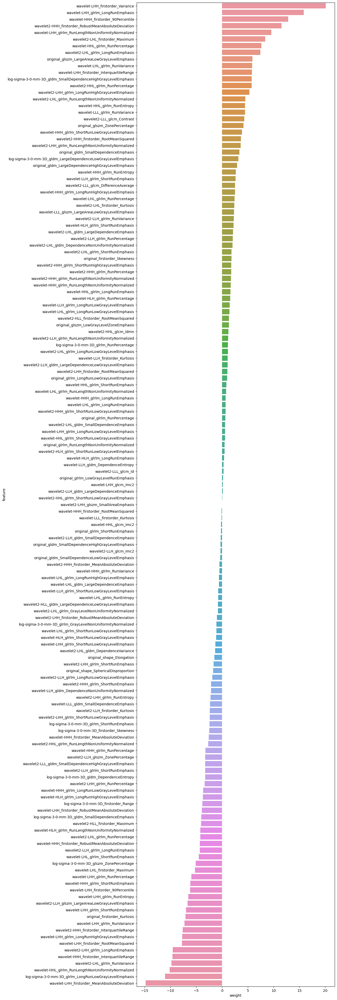

In [46]:
#Time to plot the weight of the features with the target.
plt.figure(figsize=(10,50))
sns.barplot(data=weight_df_LR.sort_values('weight',ascending=False),x='weight',y='feature')

In [47]:
#Make predictions and evaluating the model
X_train_LR=train_inputs_LR[numeric_cols]
X_val_LR=val_inputs_LR[numeric_cols]
X_test_LR=test_inputs_LR[numeric_cols]

In [48]:
train_preds_LR=model_LR.predict(X_train_LR)#Evaluate by providing only inputs of train set.

In [49]:
list(train_preds_LR)#List of predictions "Y" according train dataset.

[0,
 1,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 0,
 0,
 0,
 1,
 0,
 1,
 0,
 0,
 1,
 1,
 1,
 0,
 0,
 0,
 1,
 1,
 0,
 0,
 1,
 0,
 1,
 0,
 0,
 0,
 0,
 1,
 1,
 1,
 1,
 0,
 0,
 1,
 1,
 0,
 1,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 0,
 0,
 0,
 1,
 0,
 0,
 1,
 0,
 1,
 1,
 1,
 0,
 0,
 0,
 1,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 0,
 0,
 1,
 0,
 0,
 1,
 0,
 0,
 0,
 1,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 0,
 1,
 0,
 0,
 0,
 1,
 0,
 0,
 0,
 0,
 1,
 1,
 0,
 1,
 0,
 1,
 1,
 1,
 1,
 0,
 0,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 0,
 0,
 1,
 0,
 0,
 1,
 0,
 1,
 0,
 0,
 0,
 0,
 0,
 1,
 0,
 0,
 1,
 0,
 1,
 0,
 1,
 1,
 1,
 1,
 0,
 0,
 0,
 1,
 0,
 0,
 0,
 1,
 1,
 1,
 0,
 0,
 0,
 0,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 1,
 1,
 0,
 0,
 0,
 1,
 0,
 0,
 0,
 1,
 1,
 0,
 0,
 0,
 0,
 1,
 0,
 1,
 1,
 0,
 0,
 0,
 1,
 1,
 0,
 0,
 0,
 1,
 0,
 0,
 0,
 0,
 1,
 1,
 1,
 0,
 1,
 1,
 0,
 0,
 1,
 1,
 0,
 0,
 0,
 0,
 1,
 0,
 1,
 0,
 1,
 1,
 1,
 0,
 1,
 1,
 0,
 1,
 1,
 1,
 0,
 1,
 0,
 0,
 0,
 0,
 1,
 1,
 1,
 0,


In [50]:
train_targets_LR#Real "Y" data in training set.

1076    0
2169    1
3331    1
1431    0
470     0
       ..
260     0
294     0
3561    1
1561    0
8       0
Name: Label, Length: 2003, dtype: int64

In [51]:
#Accuracy, count the number of matches divided by the total number

In [52]:
accuracy_score(train_targets_LR,train_preds_LR)#Checking accuracy in training set.

0.7838242636045931

In [53]:
train_probs_LR=model_LR.predict_proba(X_train_LR)#How condifent is the prediction based in training set.
train_probs_LR

array([[0.76267199, 0.23732801],
       [0.14956641, 0.85043359],
       [0.67253851, 0.32746149],
       ...,
       [0.06063482, 0.93936518],
       [0.79779484, 0.20220516],
       [0.46669211, 0.53330789]])

In [54]:
model_LR.classes_

array([0, 1], dtype=int64)

In [55]:
confusion_matrix(train_targets_LR,train_preds_LR, normalize='true')#Confussion matrix for training data.

array([[0.86514886, 0.13485114],
       [0.32404181, 0.67595819]])

In [56]:
val_preds_LR=model_LR.predict(X_val_LR)#Evaluate by providing the validation set
accuracy_score(val_targets_LR,val_preds_LR)

0.7425149700598802

In [57]:
confusion_matrix(val_targets_LR,val_preds_LR, normalize='true')#Confussion matrix for validating data.

array([[0.81843575, 0.18156425],
       [0.34516129, 0.65483871]])

Accuracy for validation set is:  74.25149700598801
Confussion matrix


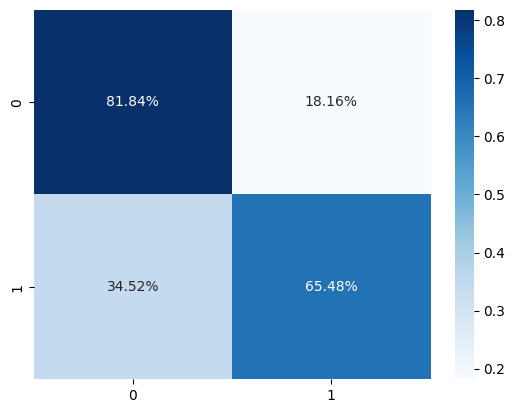

In [58]:
#We got 74% of accuracy for validation test, so lest draw its confussion matrix
print('Accuracy for validation set is: ',(accuracy_score(val_targets_LR,val_preds_LR))*100)
cm = confusion_matrix(val_targets_LR,val_preds_LR, normalize='true')
sns.heatmap(cm,annot=True,fmt=".2%",cmap='Blues')#2 decimals.
print('Confussion matrix')
plt.show()

Accuracy for validation set is:  74.25149700598801
Confussion matrix over all the results is:


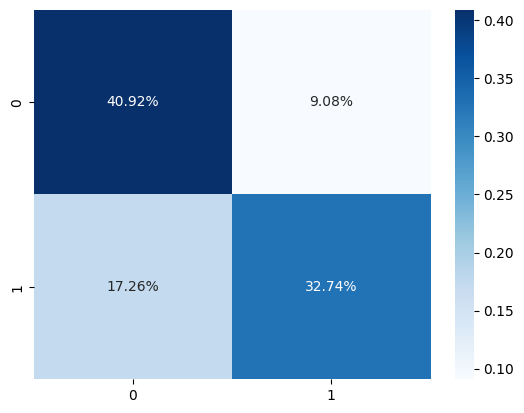

In [59]:
print('Accuracy for validation set is: ',(accuracy_score(val_targets_LR,val_preds_LR))*100)
cm = confusion_matrix(val_targets_LR,val_preds_LR, normalize='true')
sns.heatmap(cm/np.sum(cm),annot=True,fmt=".2%",cmap='Blues')
print('Confussion matrix over all the results is:')
plt.show()

In [60]:
test_preds_LR=model_LR.predict(X_test_LR)#Evaluate by providing the test set
accuracy_score(test_targets_LR,test_preds_LR)

0.7732884399551067

In [61]:
print('Classification Report for LR with all features in validation set')
print(classification_report(val_targets_LR,val_preds_LR))

Classification Report for LR with all features in validation set
              precision    recall  f1-score   support

           0       0.73      0.82      0.77       358
           1       0.76      0.65      0.70       310

    accuracy                           0.74       668
   macro avg       0.74      0.74      0.74       668
weighted avg       0.74      0.74      0.74       668



# A basic Decision Tree classifier model with some tested hyperparameters, but later we will tun this Model.

In [62]:
#We will copy the datasets to modify them
train_inputs_DT=train_df[input_cols].copy()
train_targets_DT=train_df[target_col].copy()

val_inputs_DT=val_df[input_cols].copy()
val_targets_DT=val_df[target_col].copy()

test_inputs_DT=test_df[input_cols].copy()
test_targets_DT=test_df[target_col].copy()

In [63]:
model_DT=DecisionTreeClassifier(random_state=42)
model_DT.fit(train_inputs_DT,train_targets_DT)

DecisionTreeClassifier(random_state=42)

In [64]:
#Make predictions and evaluating the model
X_train_DT=train_inputs_DT[numeric_cols]
X_val_DT=val_inputs_DT[numeric_cols]
X_test_DT=test_inputs_DT[numeric_cols]

In [65]:
#Evaluation
#Just to see again the training data
X_train_DT

,original_shape_Elongation,original_firstorder_Kurtosis,original_firstorder_Skewness,wavelet-LHL_glrlm_RunVariance,wavelet2-LHL_gldm_LargeDependenceEmphasis,wavelet2-LLH_gldm_LargeDependenceEmphasis,wavelet-LHL_gldm_LargeDependenceEmphasis,wavelet2-LHL_gldm_DependenceVariance,wavelet2-LHL_glrlm_RunVariance,wavelet-LHL_glrlm_LongRunEmphasis,...,wavelet-HHH_glrlm_LongRunHighGrayLevelEmphasis,wavelet-LLL_glszm_LargeAreaLowGrayLevelEmphasis,wavelet2-HHH_firstorder_RootMeanSquared,wavelet2-LLH_firstorder_Kurtosis,wavelet-HHL_glcm_Imc2,wavelet2-LHH_firstorder_RobustMeanAbsoluteDeviation,original_shape_SphericalDisproportion,wavelet2-HHL_glcm_Idmn,wavelet2-LHH_firstorder_RootMeanSquared,wavelet2-HLL_firstorder_Maximum
1076,0.622880,0.272104,0.388786,0.032268,0.136765,0.177338,0.108217,0.134203,0.037565,0.044180,...,0.014047,0.000429,0.086034,0.075528,0.046138,0.096027,0.140364,0.655747,0.081255,0.148395
2169,0.424123,0.409872,0.525805,0.118840,0.393973,0.407647,0.416632,0.410673,0.102550,0.162587,...,0.024259,0.004744,0.120236,0.060377,0.164312,0.055836,0.196539,0.626798,0.049094,0.045519
3331,0.652578,0.234036,0.356964,0.055909,0.171279,0.265096,0.270243,0.181593,0.044141,0.114650,...,0.012905,0.000172,0.078030,0.079580,0.021171,0.049502,0.095781,0.683562,0.048451,0.073848
1431,0.659457,0.310805,0.463403,0.164698,0.175966,0.508441,0.489118,0.348108,0.050702,0.149546,...,0.031774,0.000026,0.162313,0.207951,0.667262,0.080573,0.101234,0.872787,0.084706,0.376268
470,0.357212,0.133562,0.352493,0.005842,0.005069,0.002049,0.002990,0.002927,0.008164,0.007330,...,0.004290,0.000058,0.049002,0.123825,0.180219,0.044042,0.113658,0.296206,0.096883,0.020868
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
260,0.523557,0.303288,0.429277,0.298395,0.376567,0.248483,0.602035,0.484933,0.133317,0.253090,...,0.032587,0.000073,0.064193,0.084410,0.051473,0.042662,0.195943,0.505457,0.040365,0.041334
294,0.658457,0.269248,0.429321,0.394308,0.577616,0.345766,0.639937,0.595872,0.317586,0.308642,...,0.038875,0.000204,0.079261,0.119435,0.067151,0.042723,1.000000,0.517183,0.040364,0.090749
3561,0.521882,0.285747,0.409102,0.063549,0.074194,0.060581,0.213431,0.193034,0.027006,0.071904,...,0.019053,0.000018,0.322749,0.060910,0.315901,0.057662,0.188871,0.848516,0.104146,0.237297
1561,0.637498,0.283740,0.411970,0.157610,0.336261,0.128241,0.456233,0.563723,0.099670,0.137463,...,0.026831,0.000067,0.047898,0.069693,0.064656,0.076083,0.152824,0.422274,0.068542,0.029264


In [66]:
train_preds_DT=model_DT.predict(X_train_DT)
train_preds_DT

array([0, 1, 1, ..., 1, 0, 0], dtype=int64)

In [67]:
train_targets_DT

1076    0
2169    1
3331    1
1431    0
470     0
       ..
260     0
294     0
3561    1
1561    0
8       0
Name: Label, Length: 2003, dtype: int64

In [68]:
#To know how many 0 and 1 define the model.
pd.value_counts(train_preds_DT)

0    1142
1     861
dtype: int64

In [69]:
#To know how many 0 and 1 are in the target set.
pd.value_counts(train_targets_DT)

0    1142
1     861
Name: Label, dtype: int64

In [70]:
#Accuracy for training set.
#We can make predictions and compute accuracy in one step using model.score, for educational purposes we will try both in this model.
model_DT.score(X_train_DT,train_targets_DT)

1.0

In [71]:
#Accuracy for training set.
accuracy_score(train_preds_DT,train_targets_DT)

1.0

In [72]:
#The probabilities for each prediction using decision tree, the confidence about the results.
train_probs=model_DT.predict_proba(X_train_DT)
train_probs

array([[1., 0.],
       [0., 1.],
       [0., 1.],
       ...,
       [0., 1.],
       [1., 0.],
       [1., 0.]])

In [73]:
#The training set accuracy is 100% but we can not rely solely on the training set accuracy, just taking the training set could lead 
#to overfitting.
#we must evaluate the model on the validation set too.
model_DT.score(X_val_DT,val_targets_DT)

0.6796407185628742

In [74]:
#Predicting and then checking accuracy in validation set.
val_preds_DT=model_DT.predict(X_val_DT)
accuracy_score(val_preds_DT,val_targets_DT)

0.6796407185628742

In [75]:
#For validation set
print(classification_report(val_targets_DT,val_preds_DT))

              precision    recall  f1-score   support

           0       0.70      0.72      0.71       358
           1       0.66      0.64      0.65       310

    accuracy                           0.68       668
   macro avg       0.68      0.68      0.68       668
weighted avg       0.68      0.68      0.68       668



In [76]:
#Checking the accuracy with testing set.
model_DT.score(X_test_DT,test_targets_DT)

0.6947250280583613

In [77]:
#Predicting and then checcking accuracy.
test_preds_DT=model_DT.predict(X_test_DT)
accuracy_score(test_preds_DT,test_targets_DT)

0.6947250280583613

As long as we have overfitting in training set we will try to apply some prunning  'max_depth=4'.

In [78]:
model_DT=DecisionTreeClassifier(criterion='gini', 
    splitter='best', 
    max_depth=4, 
    min_samples_split=2, 
    min_samples_leaf=1, 
    min_weight_fraction_leaf=0.0, 
    max_features=None, 
    random_state=42, 
    max_leaf_nodes=None, 
    min_impurity_decrease=0.0, 
    class_weight=None, 
    ccp_alpha=0.0)
model_DT.fit(train_inputs_DT,train_targets_DT)

DecisionTreeClassifier(max_depth=4, random_state=42)

In [79]:
#Make predictions and evaluating the model
X_train_DT=train_inputs_DT[numeric_cols]
X_val_DT=val_inputs_DT[numeric_cols]
X_test_DT=test_inputs_DT[numeric_cols]

In [80]:
#Checking the accuracy with training set, we got rid of overfitting.
model_DT.score(X_train_DT,train_targets_DT)

0.7693459810284573

In [81]:
train_preds_DT=model_DT.predict(X_train_DT)
accuracy_score(train_preds_DT,train_targets_DT)

0.7693459810284573

In [82]:
#Checking the accuracy with validation set.
model_DT.score(X_val_DT,val_targets_DT)

0.7035928143712575

In [83]:
#Predicting and then checking accuracy in validation set.
val_preds_DT=model_DT.predict(X_val_DT)
accuracy_score(val_preds_DT,val_targets_DT)

0.7035928143712575

In [84]:
confusion_matrix(val_targets_DT,val_preds_DT, normalize='true')#Confussion matrix for validating data.

array([[0.90223464, 0.09776536],
       [0.52580645, 0.47419355]])

Accuracy for validation set is:  70.35928143712576
Confussion matrix


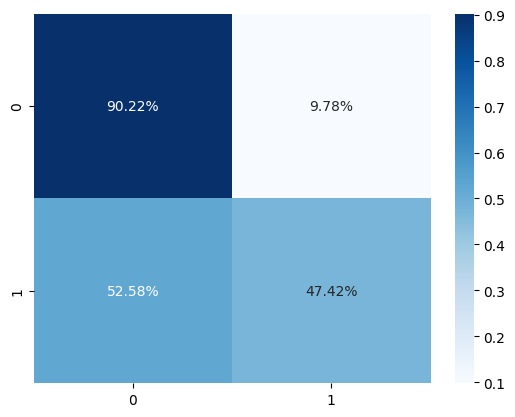

In [85]:
#We got 70% of accuracy for validation test, so lest draw its confussion matrix
print('Accuracy for validation set is: ',(accuracy_score(val_targets_DT,val_preds_DT))*100)
cm = confusion_matrix(val_targets_DT,val_preds_DT, normalize='true')
sns.heatmap(cm,annot=True,fmt=".2%",cmap='Blues')#2 decimals.
print('Confussion matrix')
plt.show()


Accuracy for validation set is:  70.35928143712576
Confussion matrix


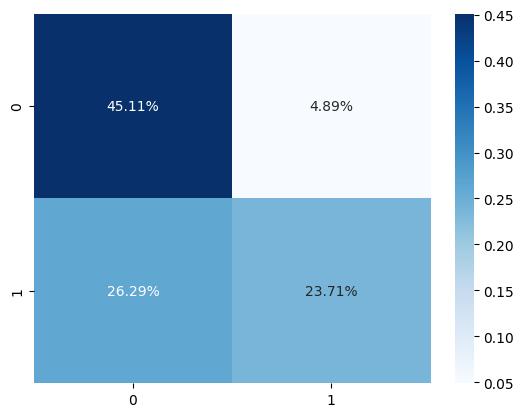

In [86]:

#We got 70% of accuracy for validation test, so lest draw its confussion matrix
print('Accuracy for validation set is: ',(accuracy_score(val_targets_DT,val_preds_DT))*100)
cm = confusion_matrix(val_targets_DT,val_preds_DT, normalize='true')
sns.heatmap(cm/np.sum(cm),annot=True,fmt=".2%",cmap='Blues')#2 decimals.
print('Confussion matrix')
plt.show()


In [87]:
print('Classification Report for DT with all features in validation set after prunning')
print(classification_report(val_targets_DT,model_DT.predict(X_val_DT)))

Classification Report for DT with all features in validation set after prunning
              precision    recall  f1-score   support

           0       0.66      0.90      0.77       358
           1       0.81      0.47      0.60       310

    accuracy                           0.70       668
   macro avg       0.74      0.69      0.68       668
weighted avg       0.73      0.70      0.69       668



In [88]:
#Checking the accuracy with testing set.
model_DT.score(X_test_DT,test_targets_DT)

0.7777777777777778

# Third Model Support Vector Machine

In [89]:
#We will copy the datasets to modify them
train_inputs_SVM=train_df[input_cols].copy()
train_targets_SVM=train_df[target_col].copy()

val_inputs_SVM=val_df[input_cols].copy()
val_targets_SVM=val_df[target_col].copy()

test_inputs_SVM=test_df[input_cols].copy()
test_targets_SVM=test_df[target_col].copy()

In [90]:
#To make predictions and evaluating the model
X_train_SVM=train_inputs_SVM[numeric_cols]
X_val_SVM=val_inputs_SVM[numeric_cols]
X_test_SVM=test_inputs_SVM[numeric_cols]

In [91]:
model_SVM = svm.SVC(kernel='rbf', gamma='auto', C=2)
model_SVM.fit(train_inputs_SVM[numeric_cols],train_targets_SVM)
train_preds_SVM=model_SVM.predict(X_train_SVM)


In [92]:
#For educational purposes we decided to apply prediction and then apply accuracy (2 stepts) for the next models, so
#we can be used with the processes behind.

accuracy_score(train_preds_SVM,train_targets_SVM)

0.6869695456814778

In [93]:
val_preds_SVM=model_SVM.predict(X_val_SVM)
accuracy_score(val_preds_SVM,val_targets_SVM)

0.6826347305389222

In [94]:
#For validation set
print('Classification Report for SVM with all features in validation set before improving')
print(classification_report(val_targets_SVM,val_preds_SVM))

Classification Report for SVM with all features in validation set before improving
              precision    recall  f1-score   support

           0       0.64      0.91      0.75       358
           1       0.80      0.42      0.55       310

    accuracy                           0.68       668
   macro avg       0.72      0.67      0.65       668
weighted avg       0.72      0.68      0.66       668



In [95]:
test_preds_SVM=model_SVM.predict(X_test_SVM)
accuracy_score(test_preds_SVM,test_targets_SVM)

0.691358024691358

Now we will change some hyperparameters to improve the results of SVM.

In [96]:
model_SVM = svm.SVC(kernel='rbf', gamma='auto', C=10)#Testing from 2 till 20 in C we got the best result with C=10, it is not linear so it can be
#poly or rbf, but using rbf we got better results.
model_SVM.fit(train_inputs_SVM[numeric_cols],train_targets_SVM)
train_preds_SVM=model_SVM.predict(X_train_SVM)


In [97]:
accuracy_score(train_preds_SVM,train_targets_SVM)

0.7568647029455816

In [98]:
val_preds_SVM=model_SVM.predict(X_val_SVM)
accuracy_score(val_preds_SVM,val_targets_SVM)

0.7290419161676647

In [99]:
confusion_matrix(val_targets_SVM,val_preds_SVM, normalize='true')#Confussion matrix for validating data.

array([[0.90782123, 0.09217877],
       [0.47741935, 0.52258065]])

Accuracy for validation set is:  72.90419161676647
Confussion matrix


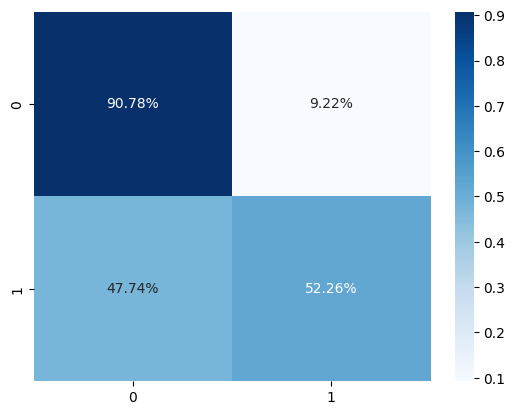

In [100]:
print('Accuracy for validation set is: ',(accuracy_score(val_targets_SVM,val_preds_SVM))*100)
cm = confusion_matrix(val_targets_SVM,val_preds_SVM, normalize='true')
sns.heatmap(cm,annot=True,fmt=".2%",cmap='Blues')#2 decimals.
print('Confussion matrix')
plt.show()


Accuracy for validating set is:  72.90419161676647
Confussion matrix over all the results is:


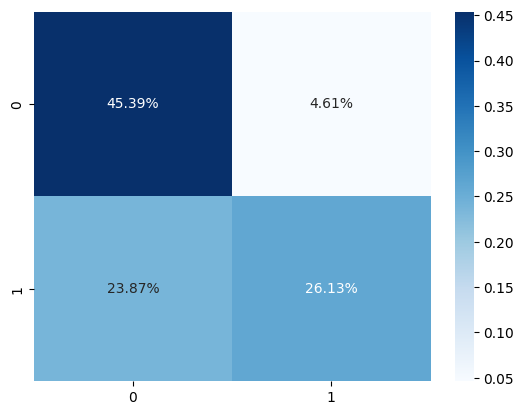

In [101]:
print('Accuracy for validating set is: ',(accuracy_score(val_targets_SVM,model_SVM.predict(X_val_SVM))*100))
cm = confusion_matrix(val_targets_SVM,model_SVM.predict(X_val_SVM), normalize='true')
sns.heatmap(cm/np.sum(cm),annot=True,fmt=".2%",cmap='Blues')
print('Confussion matrix over all the results is:')
plt.show()

In [102]:
print('Classification Report for SVM with all features in validation test')
print(classification_report(val_targets_SVM,model_SVM.predict(X_val_SVM)))

Classification Report for SVM with all features in validation test
              precision    recall  f1-score   support

           0       0.69      0.91      0.78       358
           1       0.83      0.52      0.64       310

    accuracy                           0.73       668
   macro avg       0.76      0.72      0.71       668
weighted avg       0.75      0.73      0.72       668



In [103]:
#Checking the accuracy with testing set.
test_preds_SVM=model_SVM.predict(X_test_SVM)
accuracy_score(test_preds_SVM,test_targets_SVM)

0.7665544332210998

# Random Forest

In [104]:
#We will copy the datasets to modify them
train_inputs_RF=train_df[input_cols].copy()
train_targets_RF=train_df[target_col].copy()

val_inputs_RF=val_df[input_cols].copy()
val_targets_RF=val_df[target_col].copy()

test_inputs_RF=test_df[input_cols].copy()
test_targets_RF=test_df[target_col].copy()

In [105]:
#Make predictions and evaluating the model
X_train_RF=train_inputs_RF[numeric_cols]
X_val_RF=val_inputs_RF[numeric_cols]
X_test_RF=test_inputs_RF[numeric_cols]

In [106]:
model_RF = RandomForestClassifier(random_state=42)      
model_RF.fit(X_train_RF,train_targets_RF)

RandomForestClassifier(random_state=42)

In [107]:
train_preds_RF=model_RF.predict(X_train_RF)
train_preds_RF

array([0, 1, 1, ..., 1, 0, 0], dtype=int64)

In [108]:
accuracy_score(train_preds_RF,train_targets_RF)#Accuracy with training dataset, overfitting.

1.0

In [109]:
val_preds_RF=model_RF.predict(X_val_RF)
accuracy_score(val_preds_RF,val_targets_RF)

0.7574850299401198

In [110]:
#For validation set
print('Classification report for validation set')
print(classification_report(val_targets_RF,val_preds_RF))

Classification report for validation set
              precision    recall  f1-score   support

           0       0.72      0.88      0.80       358
           1       0.82      0.61      0.70       310

    accuracy                           0.76       668
   macro avg       0.77      0.75      0.75       668
weighted avg       0.77      0.76      0.75       668



Accuracy for validating set is:  75.74850299401199


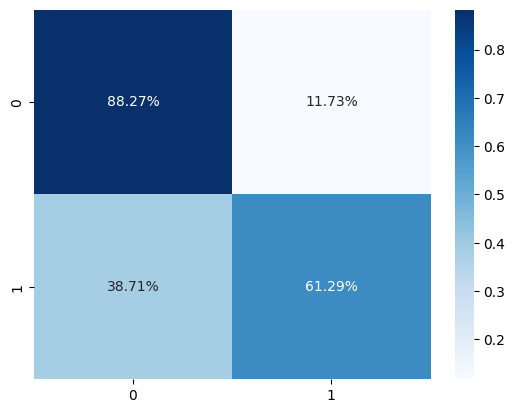

In [111]:
print('Accuracy for validating set is: ',(accuracy_score(val_targets_RF,model_RF.predict(X_val_RF))*100))
cm = confusion_matrix(val_targets_RF,model_RF.predict(X_val_RF), normalize='true')
sns.heatmap(cm,annot=True,fmt=".2%",cmap='Blues')
plt.show()

Accuracy for validating set is:  72.90419161676647
Confussion matrix over all the results is:


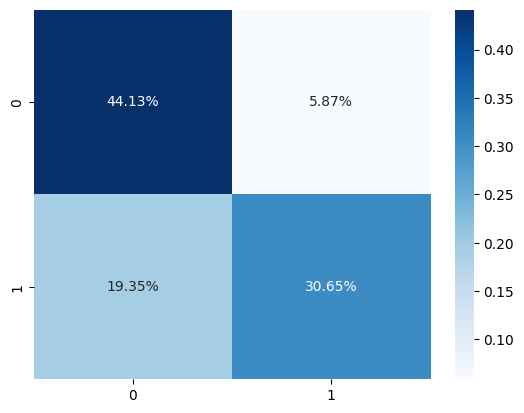

In [112]:
print('Accuracy for validating set is: ',(accuracy_score(val_targets_RF,model_SVM.predict(X_val_RF))*100))
cm = confusion_matrix(val_targets_RF,model_RF.predict(X_val_RF), normalize='true')
sns.heatmap(cm/np.sum(cm),annot=True,fmt=".2%",cmap='Blues')
print('Confussion matrix over all the results is:')
plt.show()

In [113]:
test_preds_RF=model_RF.predict(X_test_RF)
accuracy_score(test_preds_RF,test_targets_RF)


0.7901234567901234

As long as we faced overfitting in training set we will try to get rid of this.

In [114]:
#based on this suggestions: https://stackoverflow.com/questions/20463281/how-do-i-solve-overfitting-in-random-forest-of-python-sklearn
model_RF = RandomForestClassifier(n_estimators=35, max_depth=5,min_samples_split=7, max_leaf_nodes=10, random_state=42)   
model_RF.fit(X_train_RF,train_targets_RF)

RandomForestClassifier(max_depth=5, max_leaf_nodes=10, min_samples_split=7,
                       n_estimators=35, random_state=42)

In [115]:
train_preds_RF=model_RF.predict(X_train_RF)
train_preds_RF

array([0, 1, 0, ..., 0, 0, 0], dtype=int64)

In [116]:
accuracy_score(train_preds_RF,train_targets_RF)#Accuracy with training dataset, overfitting solved.

0.7623564653020469

In [117]:
val_preds_RF=model_RF.predict(X_val_RF)
accuracy_score(val_preds_RF,val_targets_RF)#After trying different hyperparameters manually this was the best results.

0.7290419161676647

In [118]:
#For validation set
print('Classification report for validation set')
print(classification_report(val_targets_RF,val_preds_RF))

Classification report for validation set
              precision    recall  f1-score   support

           0       0.68      0.92      0.78       358
           1       0.84      0.51      0.64       310

    accuracy                           0.73       668
   macro avg       0.76      0.71      0.71       668
weighted avg       0.76      0.73      0.72       668



In [119]:
#As we can see before getting rid of the overfit in training set was offering better acurracy in validation test, therefor we went
#back to the simplest model of RF to draw the confussion matrix.

In [120]:
test_preds_RF=model_RF.predict(X_test_RF)
accuracy_score(test_preds_RF,test_targets_RF)

0.7687991021324355

# Trying with Bayesian Classifier

In [121]:
from sklearn.naive_bayes import GaussianNB
from sklearn import metrics
from sklearn.metrics import confusion_matrix

In [122]:
#We will copy the datasets to modify them
train_inputs_G=train_df[input_cols].copy()
train_targets_G=train_df[target_col].copy()

val_inputs_G=val_df[input_cols].copy()
val_targets_G=val_df[target_col].copy()

test_inputs_G=test_df[input_cols].copy()
test_targets_G=test_df[target_col].copy()

In [123]:
#Make predictions and evaluating the model
X_train_G=train_inputs_G[numeric_cols]
X_val_G=val_inputs_G[numeric_cols]
X_test_G=test_inputs_G[numeric_cols]

In [124]:
model_G = GaussianNB()
model_G.fit(train_inputs_G, train_targets_G) #without feature selection


GaussianNB()

In [125]:
train_preds_G=model_G.predict(X_train_G)
accuracy_score(train_preds_G,train_targets_G)#Accuracy with training dataset

0.6220668996505242

In [126]:
val_preds_G=model_G.predict(X_val_G)
accuracy_score(val_preds_G,val_targets_G) #Accuracy with validation dataset

0.6227544910179641

In [127]:
#For validation set
print('Classification report for validation set')
print(classification_report(val_targets_G,val_preds_G))

Classification report for validation set
              precision    recall  f1-score   support

           0       0.66      0.60      0.63       358
           1       0.58      0.65      0.62       310

    accuracy                           0.62       668
   macro avg       0.62      0.62      0.62       668
weighted avg       0.63      0.62      0.62       668



Accuracy for validating set is:  62.27544910179641


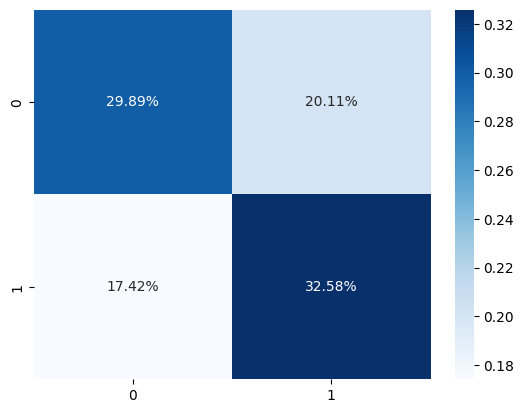

In [128]:
print('Accuracy for validating set is: ',(accuracy_score(val_targets_G,model_G.predict(X_val_G))*100))
cm = confusion_matrix(val_targets_G,model_G.predict(X_val_G), normalize='true')
sns.heatmap(cm/np.sum(cm),annot=True,fmt=".2%",cmap='Blues')
plt.show()

Accuracy for validating set is:  62.27544910179641
Confussion matrix over all the results is:


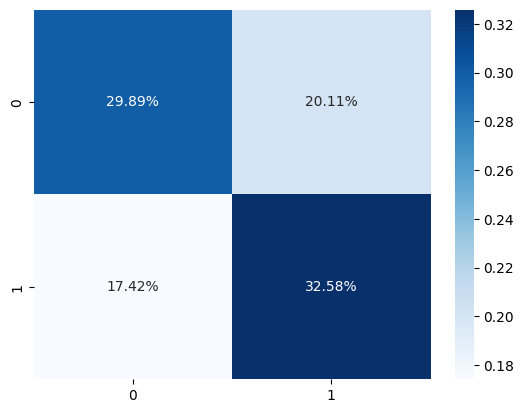

In [129]:
print('Accuracy for validating set is: ',(accuracy_score(val_targets_G,model_G.predict(X_val_G))*100))
cm = confusion_matrix(val_targets_G,model_G.predict(X_val_G), normalize='true')
sns.heatmap(cm/np.sum(cm),annot=True,fmt=".2%",cmap='Blues')
print('Confussion matrix over all the results is:')
plt.show()

In [130]:
test_preds_G=model_G.predict(X_test_G)
accuracy_score(test_preds_G,test_targets_G)  #Accuracy with test dataset

0.5970819304152637

In [131]:
#As long as tho model does not include hyperparameters, we will apply some imrpovement in the trunning stage.

# Neural Network

In [132]:
#from keras.models import Sequential
#Keras makes deep learning easy
#https://machinelearningmastery.com/how-to-configure-the-number-of-layers-and-nodes-in-a-neural-network/
#https://www.linkedin.com/pulse/choosing-number-hidden-layers-neurons-neural-networks-sachdev/
#model_NN = Sequential() #makes easy to add layers
#model_NN.add(Dense(13,input_shape=(149,), activation='relu'))#Rectify linear unit
#model_NN.add(Dropout(0.2))#lets dropout 20 percent of our conection randomly.
#Hidden_nodes= sqr(13*1)
#model_NN.add(Dense(Hidden_nodes, activation='relu'))
#model_NN.add(Dense(Hidden_nodes, activation='relu'))
#model_NN.add(Dense(1, activation='sigmoid'))#Creo es para el ultimo layer
#model_NN.compile(loss='binary_crossentropy', optimizer=Adam(lr=0.001), metrics = ['accuracy'])
 
#model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
#print(model.summary())

In [133]:
# Predicting the Test set results
#y_pred = model.predict(X_test)
#y_pred = (y_pred > 0.5)

# Making the Confusion Matrix
#from sklearn.metrics import confusion_matrix
#cm = confusion_matrix(y_test, y_pred)

#sns.heatmap(cm, annot=True)

In [134]:
#Fit with no early stopping or other callbacks
#history = model_NN.fit(X_train, y_train, verbose=1, epochs=100, batch_size=64,validation_data=(X_test, y_test))

In [135]:
#plot the training and validation accuracy and loss at each epoch
#loss = history.history['loss']
#val_loss = history.history['val_loss']
##epochs = range(1, len(loss) + 1)
#plt.plot(epochs, loss, 'y', label='Training loss')
#plt.plot(epochs, val_loss, 'r', label='Validation loss')
#plt.title('Training and validation loss')
#plt.xlabel('Epochs')
#plt.ylabel('Loss')
#plt.legend()
#plt.show()


#acc = history.history['accuracy']  #Use accuracy if acc doesn't work
#val_acc = history.history['val_accuracy']  #Use val_accuracy if acc doesn't work
#plt.plot(epochs, acc, 'y', label='Training acc')
#plt.plot(epochs, val_acc, 'r', label='Validation acc')
#plt.title('Training and validation accuracy')
#plt.xlabel('Epochs')
#plt.ylabel('Accuracy')
#plt.legend()
#plt.show()

# Scenario 2: Reducing features by doing feature selection

In [136]:
#AS long as normalizing manually and using the scaler function from sklearn give the same result, we will  use the normalized dataset
#by manual work.
#Here we are taking aside the target, to avoid affecting by normalization. 
columns_redu=df_rest.select_dtypes(include=[np.number]).columns.tolist()[:-1]
target=df_rest['Label']
normalized_redu=(df_rest[numeric_cols]-df_rest[numeric_cols].min())/(df_rest[numeric_cols].max()-df_rest[numeric_cols].min())
normalized_redu['Label']=target
dataframe=normalized_redu.corr()

In [137]:
normalized_redu.corr() #Check the correlation

,original_shape_Elongation,original_firstorder_Kurtosis,original_firstorder_Skewness,wavelet-LHL_glrlm_RunVariance,wavelet2-LHL_gldm_LargeDependenceEmphasis,wavelet2-LLH_gldm_LargeDependenceEmphasis,wavelet-LHL_gldm_LargeDependenceEmphasis,wavelet2-LHL_gldm_DependenceVariance,wavelet2-LHL_glrlm_RunVariance,wavelet-LHL_glrlm_LongRunEmphasis,...,wavelet-LLL_glszm_LargeAreaLowGrayLevelEmphasis,wavelet2-HHH_firstorder_RootMeanSquared,wavelet2-LLH_firstorder_Kurtosis,wavelet-HHL_glcm_Imc2,wavelet2-LHH_firstorder_RobustMeanAbsoluteDeviation,original_shape_SphericalDisproportion,wavelet2-HHL_glcm_Idmn,wavelet2-LHH_firstorder_RootMeanSquared,wavelet2-HLL_firstorder_Maximum,Label
original_shape_Elongation,1.000000,-0.157728,-0.129982,-0.027935,-0.002718,0.022697,0.048441,0.014654,-0.041520,0.008165,...,-0.062346,-0.014623,0.050018,-0.056311,-0.036797,-0.360294,-0.030738,-0.027682,-0.021997,-0.032919
original_firstorder_Kurtosis,-0.157728,1.000000,0.869611,-0.151952,-0.154487,-0.141599,-0.115337,-0.116763,-0.195293,-0.148536,...,0.036557,0.079540,-0.079033,0.003824,0.138577,0.325718,-0.030867,0.103156,-0.036610,-0.163841
original_firstorder_Skewness,-0.129982,0.869611,1.000000,-0.226308,-0.243797,-0.217088,-0.180155,-0.185866,-0.299874,-0.211905,...,-0.012302,0.096575,-0.115011,0.010955,0.143290,0.230066,-0.034228,0.132802,-0.065263,-0.177288
wavelet-LHL_glrlm_RunVariance,-0.027935,-0.151952,-0.226308,1.000000,0.835214,0.826354,0.896881,0.768187,0.834363,0.961106,...,0.086452,-0.082203,0.358498,0.206526,-0.100707,0.293371,0.190786,-0.188822,0.354493,0.237717
wavelet2-LHL_gldm_LargeDependenceEmphasis,-0.002718,-0.154487,-0.243797,0.835214,1.000000,0.832397,0.884616,0.940797,0.912446,0.822780,...,0.135337,-0.234098,0.241859,0.046671,-0.216945,0.325032,0.021081,-0.321950,0.230627,0.232284
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
original_shape_SphericalDisproportion,-0.360294,0.325718,0.230066,0.293371,0.325032,0.270475,0.313439,0.323871,0.276716,0.247604,...,0.187117,0.062811,0.140384,0.016874,0.113853,1.000000,0.069065,0.054867,0.207693,-0.073276
wavelet2-HHL_glcm_Idmn,-0.030738,-0.030867,-0.034228,0.190786,0.021081,0.313939,0.147824,0.051313,0.049115,0.199597,...,0.042801,0.535752,0.229595,0.570686,0.274828,0.069065,1.000000,0.286728,0.693443,0.077333
wavelet2-LHH_firstorder_RootMeanSquared,-0.027682,0.103156,0.132802,-0.188822,-0.321950,-0.207816,-0.237525,-0.297741,-0.268508,-0.212569,...,-0.035990,0.688454,0.044603,0.221137,0.896830,0.054867,0.286728,1.000000,0.251023,-0.088546
wavelet2-HLL_firstorder_Maximum,-0.021997,-0.036610,-0.065263,0.354493,0.230627,0.472928,0.329578,0.262118,0.220256,0.339958,...,0.053736,0.491352,0.287304,0.688068,0.294406,0.207693,0.693443,0.251023,1.000000,0.047379


In [138]:
#Plotting with some many features is not a good idea as we can see.
plt.figure(figsize=(200,200))
sns.heatmap(dataframe,annot=True)

<Axes: >

In [139]:
#Correlation with output variable
cor_target = abs(dataframe["Label"])
#Selecting highly correlated features, we just test different values so far.
relevant_features = cor_target[cor_target>0.2]
relevant_features.count()


47

In [140]:
relevant_features

wavelet-LHL_glrlm_RunVariance                          0.237717
wavelet2-LHL_gldm_LargeDependenceEmphasis              0.232284
wavelet2-LLH_gldm_LargeDependenceEmphasis              0.226022
wavelet-LHL_gldm_LargeDependenceEmphasis               0.225140
wavelet2-LHL_gldm_DependenceVariance                   0.203415
wavelet2-LHL_glrlm_RunVariance                         0.235203
wavelet-LHL_glrlm_LongRunEmphasis                      0.253660
wavelet-LHH_glrlm_LongRunEmphasis                      0.248344
wavelet-LHH_glrlm_RunPercentage                        0.236754
wavelet2-LLH_glrlm_RunVariance                         0.222227
wavelet-LHH_glrlm_RunLengthNonUniformityNormalized     0.226559
wavelet-HHH_glrlm_LongRunEmphasis                      0.232633
wavelet-LHH_glrlm_RunVariance                          0.228658
wavelet2-LLH_glrlm_LongRunEmphasis                     0.228745
wavelet2-LHL_glrlm_LongRunEmphasis                     0.241927
wavelet-HHH_glrlm_RunVariance           

In [141]:
#Checking if the features are correlated between each other.
new_dataset = normalized_redu.loc[:, relevant_features.index]
new_dataset

,wavelet-LHL_glrlm_RunVariance,wavelet2-LHL_gldm_LargeDependenceEmphasis,wavelet2-LLH_gldm_LargeDependenceEmphasis,wavelet-LHL_gldm_LargeDependenceEmphasis,wavelet2-LHL_gldm_DependenceVariance,wavelet2-LHL_glrlm_RunVariance,wavelet-LHL_glrlm_LongRunEmphasis,wavelet-LHH_glrlm_LongRunEmphasis,wavelet-LHH_glrlm_RunPercentage,wavelet2-LLH_glrlm_RunVariance,...,wavelet-LHH_firstorder_RobustMeanAbsoluteDeviation,wavelet-HHH_firstorder_RobustMeanAbsoluteDeviation,wavelet-LHH_firstorder_InterquartileRange,wavelet-HHL_glrlm_ShortRunEmphasis,wavelet-LHH_firstorder_MeanAbsoluteDeviation,wavelet-HHH_glrlm_RunEntropy,wavelet-LHH_firstorder_RootMeanSquared,wavelet-LHH_firstorder_90Percentile,wavelet-LHH_glrlm_ShortRunLowGrayLevelEmphasis,Label
0,0.246393,0.523875,0.572856,0.562194,0.694892,0.208769,0.213138,0.463612,0.263206,0.178776,...,0.156916,0.206493,0.176108,0.428609,0.142300,0.749359,0.134055,0.183797,0.498294,0
1,0.104909,0.411077,0.222520,0.364082,0.674761,0.127287,0.102379,0.360363,0.329376,0.052591,...,0.098605,0.179137,0.117979,0.571633,0.088639,0.696168,0.083456,0.137836,0.514683,0
2,0.237749,0.550124,0.550291,0.529857,0.467088,0.267165,0.208145,0.634723,0.170511,0.191404,...,0.132946,0.151269,0.150243,0.360718,0.122236,0.822758,0.117022,0.163103,0.459467,0
3,0.071974,0.242207,0.211163,0.291565,0.348265,0.059370,0.091643,0.260680,0.420404,0.042604,...,0.112603,0.169575,0.124700,0.644012,0.099231,0.629709,0.092446,0.147807,0.535894,0
4,0.042368,0.213376,0.154949,0.184522,0.356313,0.052668,0.052740,0.230062,0.455334,0.032848,...,0.086719,0.166035,0.104121,0.661210,0.080797,0.603855,0.078034,0.147238,0.543149,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3557,0.014555,0.017436,0.009608,0.024941,0.023203,0.011527,0.026068,0.098362,0.683456,0.008033,...,0.038962,0.022188,0.055201,0.767682,0.035026,0.399537,0.039342,0.117915,0.595131,1
3558,0.156548,0.383423,0.427313,0.425445,0.628523,0.142924,0.143765,0.559528,0.180943,0.124144,...,0.083629,0.112619,0.101823,0.375975,0.076505,0.843264,0.072938,0.122775,0.449515,1
3559,0.203718,0.512826,0.220466,0.560625,0.600126,0.174533,0.233783,0.390518,0.305094,0.051801,...,0.048465,0.030128,0.066509,0.579398,0.044190,0.681470,0.042998,0.103435,0.507519,1
3560,0.053013,0.142571,0.043139,0.165679,0.162946,0.048167,0.074237,0.222009,0.465605,0.018702,...,0.026704,0.038917,0.047254,0.687337,0.030601,0.514726,0.034944,0.090486,0.510648,1


In [142]:
corr_matrix=new_dataset.corr()
#As we can see some of the features are correlated between each other, so we will selected between them.
# get upper triangle of correlation matrix
upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(np.bool))
# find features with correlation greater than 0.95
to_drop = [column for column in upper.columns if any(upper[column] > 0.95)]
# drop highly correlated features
new_dataset.drop(to_drop, axis=1, inplace=True)
new_dataset
#We solve this issue thanks to: https://www.projectpro.io/recipes/drop-out-highly-correlated-features-in-python

C:\Users\32465\AppData\Local\Temp\ipykernel_21564\1206177950.py:4: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(np.bool))


,wavelet-LHL_glrlm_RunVariance,wavelet2-LHL_gldm_LargeDependenceEmphasis,wavelet2-LLH_gldm_LargeDependenceEmphasis,wavelet-LHL_gldm_LargeDependenceEmphasis,wavelet2-LHL_gldm_DependenceVariance,wavelet2-LHL_glrlm_RunVariance,wavelet-LHH_glrlm_LongRunEmphasis,wavelet-LHH_glrlm_RunPercentage,wavelet2-LLH_glrlm_RunVariance,wavelet-HHH_glrlm_LongRunEmphasis,...,wavelet-LLH_glrlm_LongRunLowGrayLevelEmphasis,original_glrlm_ShortRunEmphasis,wavelet-HHL_glrlm_RunLengthNonUniformityNormalized,wavelet-HHH_glrlm_LongRunLowGrayLevelEmphasis,wavelet-LHH_glrlm_RunEntropy,wavelet-HHH_firstorder_InterquartileRange,wavelet-LHH_firstorder_RobustMeanAbsoluteDeviation,wavelet-LHH_firstorder_90Percentile,wavelet-LHH_glrlm_ShortRunLowGrayLevelEmphasis,Label
0,0.246393,0.523875,0.572856,0.562194,0.694892,0.208769,0.463612,0.263206,0.178776,0.453112,...,0.206122,0.247304,0.217079,0.508526,0.750007,0.261450,0.156916,0.183797,0.498294,0
1,0.104909,0.411077,0.222520,0.364082,0.674761,0.127287,0.360363,0.329376,0.052591,0.335834,...,0.293330,0.276059,0.357284,0.423452,0.693023,0.229967,0.098605,0.137836,0.514683,0
2,0.237749,0.550124,0.550291,0.529857,0.467088,0.267165,0.634723,0.170511,0.191404,0.626136,...,0.267117,0.034484,0.173079,0.712857,0.833819,0.195913,0.132946,0.163103,0.459467,0
3,0.071974,0.242207,0.211163,0.291565,0.348265,0.059370,0.260680,0.420404,0.042604,0.237608,...,0.146672,0.469429,0.430697,0.331548,0.611407,0.214162,0.112603,0.147807,0.535894,0
4,0.042368,0.213376,0.154949,0.184522,0.356313,0.052668,0.230062,0.455334,0.032848,0.214158,...,0.134097,0.458144,0.448276,0.310218,0.578928,0.222152,0.086719,0.147238,0.543149,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3557,0.014555,0.017436,0.009608,0.024941,0.023203,0.011527,0.098362,0.683456,0.008033,0.079377,...,0.144846,0.752457,0.589747,0.186111,0.359088,0.040434,0.038962,0.117915,0.595131,1
3558,0.156548,0.383423,0.427313,0.425445,0.628523,0.142924,0.559528,0.180943,0.124144,0.558690,...,0.200106,0.237733,0.164459,0.626511,0.824271,0.150461,0.083629,0.122775,0.449515,1
3559,0.203718,0.512826,0.220466,0.560625,0.600126,0.174533,0.390518,0.305094,0.051801,0.301545,...,0.267214,0.349417,0.362616,0.393625,0.712979,0.051528,0.048465,0.103435,0.507519,1
3560,0.053013,0.142571,0.043139,0.165679,0.162946,0.048167,0.222009,0.465605,0.018702,0.139328,...,0.078583,0.566811,0.488229,0.251479,0.536862,0.060004,0.026704,0.090486,0.510648,1


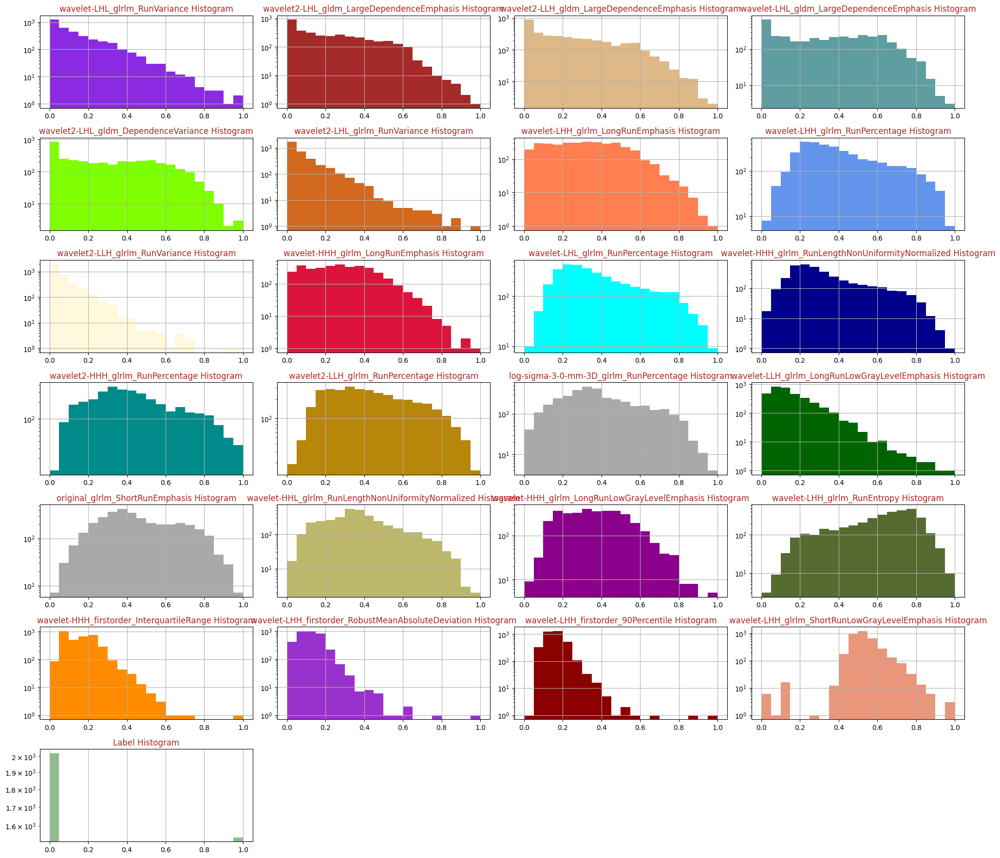

In [143]:
#We have 25 features, we will explore a little bit.
#Before training oagain ur models we will analyze the dataset trough plotting the different features.
#First each selected feature will show its quantities in all the dataset, we can think that if the samples of a feature
#has not homogenuos dispersion it could affect the target with major probabilities, for example:
#If we have a lot of samples near to 0 and just few near to 1, we could then compare with the target, 
#because for example may be probable that as smaller are the values the probability of having cancer is increasing.

colors = list(mcolors.CSS4_COLORS.keys())[10:]
def draw_histograms(dataframe, features, rows, cols):
    fig=plt.figure(figsize=(20,20))
    for i, feature in enumerate(features):
        ax=fig.add_subplot(rows,cols,i+1)
        dataframe[feature].hist(bins=20,ax=ax,facecolor=colors[i])
        ax.set_title(feature+" Histogram",color=colors[35])
        ax.set_yscale('log')
    fig.tight_layout() 
    plt.savefig('Histograms.png')
    plt.show()
draw_histograms(new_dataset,new_dataset.columns,8,4)


In [144]:
#Just to manage the data better.
negative_correlated=weight_df_LR.sort_values(by='weight').head(25)
positive_correlated=weight_df_LR.sort_values(by='weight').tail(25)

In [145]:

negative_correlated['Found negative feature']=negative_correlated['feature'].apply(lambda x: 1 if (x in relevant_features) else 0)
negative_correlated

,feature,weight,Found negative feature
67,wavelet-LHH_firstorder_MeanAbsoluteDeviation,-14.809778,1
75,log-sigma-3-0-mm-3D_glrlm_LongRunLowGrayLevelE...,-11.040948,0
41,wavelet-HHL_glrlm_RunLengthNonUniformityNormal...,-10.163570,1
8,wavelet2-LHL_glrlm_RunVariance,-9.819847,1
58,wavelet-HHH_firstorder_InterquartileRange,-9.620732,1
19,wavelet2-LHH_glrlm_LongRunEmphasis,-9.580907,1
78,wavelet-LHH_firstorder_RootMeanSquared,-7.783261,1
110,wavelet-LHH_glrlm_LongRunHighGrayLevelEmphasis,-7.745794,0
122,wavelet2-HHH_firstorder_InterquartileRange,-7.621996,0
15,wavelet-LHH_glrlm_RunVariance,-7.267218,1


In [146]:
(negative_correlated['Found negative feature']==1).sum()

14

In [147]:
positive_correlated['Found positive feature']=positive_correlated['feature'].apply(lambda x: 1 if (x in relevant_features) else 0)
positive_correlated

,feature,weight,Found positive feature
49,original_gldm_LargeDependenceHighGrayLevelEmph...,2.929073,0
45,log-sigma-3-0-mm-3D_gldm_LargeDependenceLowGra...,3.139721,0
93,original_gldm_SmallDependenceEmphasis,3.364391,0
28,wavelet2-LHH_glrlm_RunLengthNonUniformityNorma...,3.591040,1
140,wavelet2-HHH_firstorder_RootMeanSquared,3.671021,0
114,wavelet-HHH_glrlm_ShortRunLowGrayLevelEmphasis,3.846675,0
86,original_glszm_ZonePercentage,4.128264,0
126,wavelet2-LLL_glcm_Contrast,4.299683,0
104,wavelet-LLL_glrlm_RunVariance,4.462904,0
77,wavelet-HHL_glrlm_RunEntropy,4.467138,0


In [148]:
(positive_correlated['Found positive feature']==1).sum()

7

In [149]:
#Comparing with the most impacting features by weight found in our first model of LR (When we saved 25 most positive and 25 most negative),
# whith the total of features selected first (49), we found a total of 21 common features.
# Lets see if we have still some of them final 25.
new_dataset.columns.values

array(['wavelet-LHL_glrlm_RunVariance',
       'wavelet2-LHL_gldm_LargeDependenceEmphasis',
       'wavelet2-LLH_gldm_LargeDependenceEmphasis',
       'wavelet-LHL_gldm_LargeDependenceEmphasis',
       'wavelet2-LHL_gldm_DependenceVariance',
       'wavelet2-LHL_glrlm_RunVariance',
       'wavelet-LHH_glrlm_LongRunEmphasis',
       'wavelet-LHH_glrlm_RunPercentage',
       'wavelet2-LLH_glrlm_RunVariance',
       'wavelet-HHH_glrlm_LongRunEmphasis',
       'wavelet-LHL_glrlm_RunPercentage',
       'wavelet-HHH_glrlm_RunLengthNonUniformityNormalized',
       'wavelet2-HHH_glrlm_RunPercentage',
       'wavelet2-LLH_glrlm_RunPercentage',
       'log-sigma-3-0-mm-3D_glrlm_RunPercentage',
       'wavelet-LLH_glrlm_LongRunLowGrayLevelEmphasis',
       'original_glrlm_ShortRunEmphasis',
       'wavelet-HHL_glrlm_RunLengthNonUniformityNormalized',
       'wavelet-HHH_glrlm_LongRunLowGrayLevelEmphasis',
       'wavelet-LHH_glrlm_RunEntropy',
       'wavelet-HHH_firstorder_InterquartileRange',
 

In [150]:
negative_correlated['Found2 negative feature']=negative_correlated['feature'].apply(lambda x: 1 if (x in new_dataset.columns.values) else 0)
negative_correlated

,feature,weight,Found negative feature,Found2 negative feature
67,wavelet-LHH_firstorder_MeanAbsoluteDeviation,-14.809778,1,0
75,log-sigma-3-0-mm-3D_glrlm_LongRunLowGrayLevelE...,-11.040948,0,0
41,wavelet-HHL_glrlm_RunLengthNonUniformityNormal...,-10.163570,1,1
8,wavelet2-LHL_glrlm_RunVariance,-9.819847,1,1
58,wavelet-HHH_firstorder_InterquartileRange,-9.620732,1,1
19,wavelet2-LHH_glrlm_LongRunEmphasis,-9.580907,1,0
78,wavelet-LHH_firstorder_RootMeanSquared,-7.783261,1,0
110,wavelet-LHH_glrlm_LongRunHighGrayLevelEmphasis,-7.745794,0,0
122,wavelet2-HHH_firstorder_InterquartileRange,-7.621996,0,0
15,wavelet-LHH_glrlm_RunVariance,-7.267218,1,0


In [151]:
(negative_correlated['Found2 negative feature']==1).sum()

6

In [152]:
positive_correlated['Found2 positive feature']=positive_correlated['feature'].apply(lambda x: 1 if (x in new_dataset.columns.values) else 0)
positive_correlated

,feature,weight,Found positive feature,Found2 positive feature
49,original_gldm_LargeDependenceHighGrayLevelEmph...,2.929073,0,0
45,log-sigma-3-0-mm-3D_gldm_LargeDependenceLowGra...,3.139721,0,0
93,original_gldm_SmallDependenceEmphasis,3.364391,0,0
28,wavelet2-LHH_glrlm_RunLengthNonUniformityNorma...,3.591040,1,0
140,wavelet2-HHH_firstorder_RootMeanSquared,3.671021,0,0
114,wavelet-HHH_glrlm_ShortRunLowGrayLevelEmphasis,3.846675,0,0
86,original_glszm_ZonePercentage,4.128264,0,0
126,wavelet2-LLL_glcm_Contrast,4.299683,0,0
104,wavelet-LLL_glrlm_RunVariance,4.462904,0,0
77,wavelet-HHL_glrlm_RunEntropy,4.467138,0,0


In [153]:
(positive_correlated['Found2 positive feature']==1).sum()

2

In [154]:
sns.set_style('darkgrid')
matplotlib.rcParams['font.size']=14
matplotlib.rcParams['figure.figsize']=(5,3)
matplotlib.rcParams['figure.facecolor']='#00000000'


In [155]:
i=0
for x in negative_correlated['Found2 negative feature']:
    if x==1:
        print(negative_correlated['feature'].iloc[i])
    i+=1
#px.histogram(new_dataset,x=lambda x: negative_correlated['feature'] if (x in relevant_features),title=lambda x: negative_correlated['Feature Found'] if (x in relevant_features),color='Label')

wavelet-HHL_glrlm_RunLengthNonUniformityNormalized
wavelet2-LHL_glrlm_RunVariance
wavelet-HHH_firstorder_InterquartileRange
wavelet-LHH_glrlm_RunEntropy
wavelet-LHH_firstorder_90Percentile
wavelet-LHH_glrlm_RunPercentage


In [156]:
#We will analyze trhough a graph the first 3 (the most negative correlated).

In [157]:
px.histogram(new_dataset,x='wavelet-HHL_glrlm_RunLengthNonUniformityNormalized',title='wavelet-HHL_glrlm_RunLengthNonUniformityNormalized',color='Label')
#If the values of this features is between 0.35 and 0.37, the probability of finding a negative result for cancer es 62 against 38% of being positive.

In [158]:
px.histogram(new_dataset,x='wavelet2-LHL_glrlm_RunVariance',title='wavelet2-LHL_glrlm_RunVariance',color='Label')
#This features means a 34% of probability of being positive if the value is between 0.005 and 0.015,
#and a probability of 66% negative if the feature is in the same range of value.
#But it seems that if the value is more than 0.445 the probability of being positive is incresing.

In [159]:
px.histogram(new_dataset,x='wavelet-HHH_firstorder_InterquartileRange',title='wavelet-HHH_firstorder_InterquartileRange',color='Label')
#Here if the value of the feature is between 0.205 and 0.215 the probability of having a negative is 72%, against 28% of having
#a positive in the same range of feature value.

In [160]:
px.histogram(new_dataset,x='wavelet-LHH_glrlm_RunEntropy',title='wavelet-LHH_glrlm_RunEntropy',color='Label')

In [161]:
px.histogram(new_dataset,x='wavelet-LHH_firstorder_90Percentile',title='wavelet-LHH_firstorder_90Percentile',color='Label')

In [162]:
px.histogram(new_dataset,x='wavelet-LHH_glrlm_RunPercentage',title='wavelet-LHH_glrlm_RunPercentage',color='Label')

In [163]:
#Lets analize the most positive correlated.

In [164]:
i=0
for x in positive_correlated['Found2 positive feature']:
    if x==1:
        print(positive_correlated['feature'].iloc[i])
    i+=1
#px.histogram(new_dataset,x=lambda x: negative_correlated['feature'] if (x in relevant_features),title=lambda x: negative_correlated['Feature Found'] if (x in relevant_features),color='Label')

wavelet-LHL_glrlm_RunVariance
wavelet-LHH_glrlm_LongRunEmphasis


In [165]:
px.histogram(new_dataset,x='wavelet-LHL_glrlm_RunVariance',title='wavelet-LHL_glrlm_RunVariance',color='Label')
#This feature says that having a value between 0.01 and 0.03 the probability of being positive is 35´% against 65% of being negative 
#for the same value, butif the value is bigger that 0.6 the probability of positive is increasing.

In [166]:
px.histogram(new_dataset,x='wavelet-LHH_glrlm_LongRunEmphasis',title='wavelet-LHH_glrlm_LongRunEmphasis',color='Label')

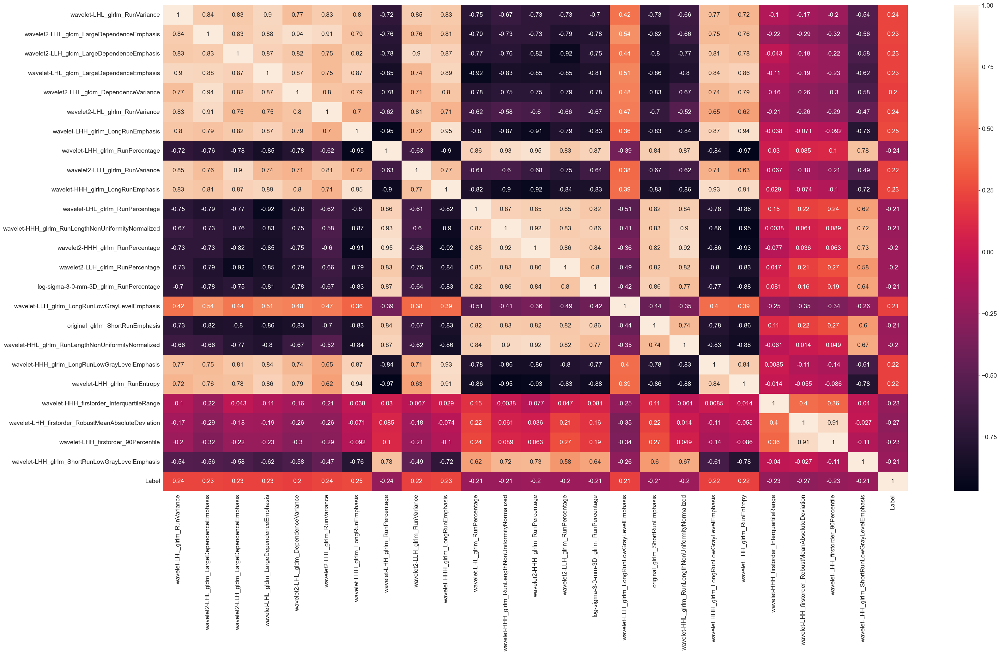

In [167]:
#Lets plot the correlation matrix with the final features selected.
#Plotting again the correlation matrix
plt.figure(figsize = (38,20))
sns.heatmap(new_dataset.corr(), annot = True)
plt.savefig('heatmap.png')
plt.show()

In [168]:
#Time to train again de models using the dataframe wit features selected

In [169]:
numeric_cols_new=new_dataset.select_dtypes(include=[np.number]).columns.tolist()[:-1]#Get aside the Label to avoid using as a input.
new_dataset[numeric_cols_new] #The target is not shown.

,wavelet-LHL_glrlm_RunVariance,wavelet2-LHL_gldm_LargeDependenceEmphasis,wavelet2-LLH_gldm_LargeDependenceEmphasis,wavelet-LHL_gldm_LargeDependenceEmphasis,wavelet2-LHL_gldm_DependenceVariance,wavelet2-LHL_glrlm_RunVariance,wavelet-LHH_glrlm_LongRunEmphasis,wavelet-LHH_glrlm_RunPercentage,wavelet2-LLH_glrlm_RunVariance,wavelet-HHH_glrlm_LongRunEmphasis,...,log-sigma-3-0-mm-3D_glrlm_RunPercentage,wavelet-LLH_glrlm_LongRunLowGrayLevelEmphasis,original_glrlm_ShortRunEmphasis,wavelet-HHL_glrlm_RunLengthNonUniformityNormalized,wavelet-HHH_glrlm_LongRunLowGrayLevelEmphasis,wavelet-LHH_glrlm_RunEntropy,wavelet-HHH_firstorder_InterquartileRange,wavelet-LHH_firstorder_RobustMeanAbsoluteDeviation,wavelet-LHH_firstorder_90Percentile,wavelet-LHH_glrlm_ShortRunLowGrayLevelEmphasis
0,0.246393,0.523875,0.572856,0.562194,0.694892,0.208769,0.463612,0.263206,0.178776,0.453112,...,0.194331,0.206122,0.247304,0.217079,0.508526,0.750007,0.261450,0.156916,0.183797,0.498294
1,0.104909,0.411077,0.222520,0.364082,0.674761,0.127287,0.360363,0.329376,0.052591,0.335834,...,0.373363,0.293330,0.276059,0.357284,0.423452,0.693023,0.229967,0.098605,0.137836,0.514683
2,0.237749,0.550124,0.550291,0.529857,0.467088,0.267165,0.634723,0.170511,0.191404,0.626136,...,0.053023,0.267117,0.034484,0.173079,0.712857,0.833819,0.195913,0.132946,0.163103,0.459467
3,0.071974,0.242207,0.211163,0.291565,0.348265,0.059370,0.260680,0.420404,0.042604,0.237608,...,0.449868,0.146672,0.469429,0.430697,0.331548,0.611407,0.214162,0.112603,0.147807,0.535894
4,0.042368,0.213376,0.154949,0.184522,0.356313,0.052668,0.230062,0.455334,0.032848,0.214158,...,0.300217,0.134097,0.458144,0.448276,0.310218,0.578928,0.222152,0.086719,0.147238,0.543149
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3557,0.014555,0.017436,0.009608,0.024941,0.023203,0.011527,0.098362,0.683456,0.008033,0.079377,...,0.595305,0.144846,0.752457,0.589747,0.186111,0.359088,0.040434,0.038962,0.117915,0.595131
3558,0.156548,0.383423,0.427313,0.425445,0.628523,0.142924,0.559528,0.180943,0.124144,0.558690,...,0.198512,0.200106,0.237733,0.164459,0.626511,0.824271,0.150461,0.083629,0.122775,0.449515
3559,0.203718,0.512826,0.220466,0.560625,0.600126,0.174533,0.390518,0.305094,0.051801,0.301545,...,0.399166,0.267214,0.349417,0.362616,0.393625,0.712979,0.051528,0.048465,0.103435,0.507519
3560,0.053013,0.142571,0.043139,0.165679,0.162946,0.048167,0.222009,0.465605,0.018702,0.139328,...,0.410948,0.078583,0.566811,0.488229,0.251479,0.536862,0.060004,0.026704,0.090486,0.510648


# Split the training, validation and testing set again.

In [170]:
train_val_new, test_new=train_test_split(new_dataset,test_size=0.25,random_state=42)
#with random_state every time that run will pick the same data to know if we are really improving in performance
#even make run many times.
train_new, val_new=train_test_split(train_val_new,test_size=0.25,random_state=42)
print('train_df shape:',train_new.shape)
print('val_df shape:',val_new.shape)
print('test_df shape:',test_new.shape)

train_df shape: (2003, 25)
val_df shape: (668, 25)
test_df shape: (891, 25)


In [171]:
input_cols_new=list(train_new.columns)[0:-1]
target_col_new='Label'
print(input_cols_new)#Checking the input features.

['wavelet-LHL_glrlm_RunVariance', 'wavelet2-LHL_gldm_LargeDependenceEmphasis', 'wavelet2-LLH_gldm_LargeDependenceEmphasis', 'wavelet-LHL_gldm_LargeDependenceEmphasis', 'wavelet2-LHL_gldm_DependenceVariance', 'wavelet2-LHL_glrlm_RunVariance', 'wavelet-LHH_glrlm_LongRunEmphasis', 'wavelet-LHH_glrlm_RunPercentage', 'wavelet2-LLH_glrlm_RunVariance', 'wavelet-HHH_glrlm_LongRunEmphasis', 'wavelet-LHL_glrlm_RunPercentage', 'wavelet-HHH_glrlm_RunLengthNonUniformityNormalized', 'wavelet2-HHH_glrlm_RunPercentage', 'wavelet2-LLH_glrlm_RunPercentage', 'log-sigma-3-0-mm-3D_glrlm_RunPercentage', 'wavelet-LLH_glrlm_LongRunLowGrayLevelEmphasis', 'original_glrlm_ShortRunEmphasis', 'wavelet-HHL_glrlm_RunLengthNonUniformityNormalized', 'wavelet-HHH_glrlm_LongRunLowGrayLevelEmphasis', 'wavelet-LHH_glrlm_RunEntropy', 'wavelet-HHH_firstorder_InterquartileRange', 'wavelet-LHH_firstorder_RobustMeanAbsoluteDeviation', 'wavelet-LHH_firstorder_90Percentile', 'wavelet-LHH_glrlm_ShortRunLowGrayLevelEmphasis']


# Logistic Regression with features selected.

In [172]:
#We will copy the datasets to modify them
train_inputs_new_LR=train_new[input_cols_new].copy()
train_targets_new_LR=train_new[target_col_new].copy()

val_inputs_new_LR=val_new[input_cols_new].copy()
val_targets_new_LR=val_new[target_col_new].copy()

test_inputs_new_LR=test_new[input_cols_new].copy()
test_targets_new_LR=test_new[target_col_new].copy()

In [173]:
model_new_LR=LogisticRegression(solver='liblinear', penalty = 'l2', C = 100)
model_new_LR.fit(train_inputs_new_LR[numeric_cols_new],train_targets_new_LR)

LogisticRegression(C=100, solver='liblinear')

In [174]:
print(numeric_cols_new)

['wavelet-LHL_glrlm_RunVariance', 'wavelet2-LHL_gldm_LargeDependenceEmphasis', 'wavelet2-LLH_gldm_LargeDependenceEmphasis', 'wavelet-LHL_gldm_LargeDependenceEmphasis', 'wavelet2-LHL_gldm_DependenceVariance', 'wavelet2-LHL_glrlm_RunVariance', 'wavelet-LHH_glrlm_LongRunEmphasis', 'wavelet-LHH_glrlm_RunPercentage', 'wavelet2-LLH_glrlm_RunVariance', 'wavelet-HHH_glrlm_LongRunEmphasis', 'wavelet-LHL_glrlm_RunPercentage', 'wavelet-HHH_glrlm_RunLengthNonUniformityNormalized', 'wavelet2-HHH_glrlm_RunPercentage', 'wavelet2-LLH_glrlm_RunPercentage', 'log-sigma-3-0-mm-3D_glrlm_RunPercentage', 'wavelet-LLH_glrlm_LongRunLowGrayLevelEmphasis', 'original_glrlm_ShortRunEmphasis', 'wavelet-HHL_glrlm_RunLengthNonUniformityNormalized', 'wavelet-HHH_glrlm_LongRunLowGrayLevelEmphasis', 'wavelet-LHH_glrlm_RunEntropy', 'wavelet-HHH_firstorder_InterquartileRange', 'wavelet-LHH_firstorder_RobustMeanAbsoluteDeviation', 'wavelet-LHH_firstorder_90Percentile', 'wavelet-LHH_glrlm_ShortRunLowGrayLevelEmphasis']


In [175]:
print(model_new_LR.coef_.tolist())#the weights assigned for each feature.

[[2.366182906433057, -1.6489117673875622, 3.426078651398656, 0.9620205948945962, -1.566638376380642, 1.4563058422863524, 2.3314037955987184, -4.468531058753256, -3.462210612689217, -1.8590279619166343, 3.496256635522879, -5.392739384497846, 0.40285884655117593, 2.651087337045613, 0.08266239330350268, 1.1082970531948055, 0.7153845879272864, -3.508603556700533, -0.6180130184680179, -5.711407194633275, -6.012593386082286, -8.520878467181173, -5.632742737580137, -2.204091897926529]]


In [176]:
#Make predictions and evaluating the model
X_train_new_LR=train_inputs_new_LR[numeric_cols_new]
X_val_new_LR=val_inputs_new_LR[numeric_cols_new]
X_test_new_LR=test_inputs_new_LR[numeric_cols_new]

In [177]:
train_preds_new_LR=model_new_LR.predict(X_train_new_LR)#Evaluate by providing only inputs of train set.

In [178]:
list(train_preds_new_LR)

[0,
 1,
 0,
 0,
 0,
 0,
 0,
 1,
 0,
 0,
 0,
 1,
 0,
 0,
 0,
 0,
 1,
 0,
 0,
 0,
 0,
 0,
 1,
 0,
 0,
 0,
 0,
 0,
 1,
 0,
 0,
 1,
 0,
 1,
 0,
 0,
 0,
 0,
 1,
 1,
 0,
 1,
 0,
 0,
 1,
 1,
 0,
 0,
 0,
 0,
 1,
 0,
 0,
 0,
 0,
 1,
 0,
 0,
 0,
 1,
 0,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 0,
 0,
 1,
 1,
 0,
 0,
 0,
 0,
 0,
 1,
 0,
 0,
 0,
 0,
 0,
 1,
 0,
 0,
 1,
 0,
 0,
 1,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 0,
 1,
 0,
 0,
 0,
 1,
 0,
 0,
 0,
 0,
 1,
 1,
 0,
 1,
 1,
 0,
 1,
 0,
 1,
 0,
 0,
 0,
 1,
 0,
 0,
 0,
 1,
 0,
 0,
 0,
 0,
 1,
 1,
 0,
 0,
 1,
 0,
 1,
 0,
 0,
 0,
 0,
 0,
 1,
 0,
 0,
 0,
 0,
 1,
 0,
 1,
 1,
 1,
 0,
 0,
 0,
 1,
 0,
 0,
 0,
 0,
 0,
 1,
 1,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 0,
 1,
 0,
 0,
 0,
 0,
 0,
 1,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 0,
 0,
 0,
 1,
 1,
 1,
 0,
 1,
 0,
 0,
 0,
 1,
 1,
 0,
 0,
 0,
 1,
 0,
 0,
 0,
 0,
 1,
 1,
 0,
 0,
 0,
 1,
 0,
 0,
 1,
 0,
 0,
 1,
 0,
 0,
 1,
 0,
 1,
 1,
 1,
 1,
 0,
 0,
 1,
 0,
 0,
 1,
 1,
 1,
 0,
 1,
 0,
 0,
 0,
 1,
 0,
 1,
 0,
 0,


In [179]:
train_targets_new_LR

1076    0
2169    1
3331    1
1431    0
470     0
       ..
260     0
294     0
3561    1
1561    0
8       0
Name: Label, Length: 2003, dtype: int64

In [180]:
accuracy_score(train_targets_new_LR,train_preds_new_LR)

0.7373939091362955

In [181]:
train_probs_new_LR=model_new_LR.predict_proba(X_train_new_LR)#How condifent is the prediction, but based in traing set,
train_probs_new_LR

array([[0.60818877, 0.39181123],
       [0.4498694 , 0.5501306 ],
       [0.83732156, 0.16267844],
       ...,
       [0.53792685, 0.46207315],
       [0.71982807, 0.28017193],
       [0.54252818, 0.45747182]])

In [182]:
model_new_LR.classes_

array([0, 1], dtype=int64)

In [183]:
confusion_matrix(train_targets_new_LR,train_preds_new_LR, normalize='true')

array([[0.84676007, 0.15323993],
       [0.40766551, 0.59233449]])

In [184]:
val_preds_new_LR=model_new_LR.predict(X_val_new_LR)#Evaluate by providing the validation set
accuracy_score(val_targets_new_LR,val_preds_new_LR)#For training with all features is 0.74

0.7080838323353293

In [185]:
print(classification_report(val_targets_new_LR,val_preds_new_LR))

              precision    recall  f1-score   support

           0       0.69      0.83      0.75       358
           1       0.74      0.56      0.64       310

    accuracy                           0.71       668
   macro avg       0.72      0.70      0.70       668
weighted avg       0.71      0.71      0.70       668



In [186]:
test_preds_new_LR=model_new_LR.predict(X_test_new_LR)#Evaluate by providing the test set
accuracy_score(test_targets_new_LR,test_preds_new_LR)#For training with all features is 0.77

0.7384960718294051

# Decision Tree classifier

In [187]:
#We will copy the datasets to modify them
train_inputs_new_DT=train_new[input_cols_new].copy()
train_targets_new_DT=train_new[target_col_new].copy()

val_inputs_new_DT=val_new[input_cols_new].copy()
val_targets_new_DT=val_new[target_col_new].copy()

test_inputs_new_DT=test_new[input_cols_new].copy()
test_targets_new_DT=test_new[target_col_new].copy()

In [188]:
model_new_DT=DecisionTreeClassifier(criterion='gini', 
    splitter='best', 
    max_depth=7, #from 4 to 7, improved the performance here.
    min_samples_split=2, 
    min_samples_leaf=1, 
    min_weight_fraction_leaf=0.0, 
    max_features=None, 
    random_state=42, 
    max_leaf_nodes=None, 
    min_impurity_decrease=0.0, 
    class_weight=None, 
    ccp_alpha=0.0)
model_new_DT.fit(train_inputs_new_DT,train_targets_new_DT)

DecisionTreeClassifier(max_depth=7, random_state=42)

In [189]:
#Make predictions and evaluating the model
X_train_new_DT=train_inputs_new_DT[numeric_cols_new]
X_val_new_DT=val_inputs_new_DT[numeric_cols_new]
X_test_new_DT=test_inputs_new_DT[numeric_cols_new]

In [190]:
#Evaluation
#Just to see again the training data

X_train_new_DT

,wavelet-LHL_glrlm_RunVariance,wavelet2-LHL_gldm_LargeDependenceEmphasis,wavelet2-LLH_gldm_LargeDependenceEmphasis,wavelet-LHL_gldm_LargeDependenceEmphasis,wavelet2-LHL_gldm_DependenceVariance,wavelet2-LHL_glrlm_RunVariance,wavelet-LHH_glrlm_LongRunEmphasis,wavelet-LHH_glrlm_RunPercentage,wavelet2-LLH_glrlm_RunVariance,wavelet-HHH_glrlm_LongRunEmphasis,...,log-sigma-3-0-mm-3D_glrlm_RunPercentage,wavelet-LLH_glrlm_LongRunLowGrayLevelEmphasis,original_glrlm_ShortRunEmphasis,wavelet-HHL_glrlm_RunLengthNonUniformityNormalized,wavelet-HHH_glrlm_LongRunLowGrayLevelEmphasis,wavelet-LHH_glrlm_RunEntropy,wavelet-HHH_firstorder_InterquartileRange,wavelet-LHH_firstorder_RobustMeanAbsoluteDeviation,wavelet-LHH_firstorder_90Percentile,wavelet-LHH_glrlm_ShortRunLowGrayLevelEmphasis
1076,0.032268,0.136765,0.177338,0.108217,0.134203,0.037565,0.209848,0.482035,0.032295,0.143118,...,0.558086,0.065710,0.537330,0.396641,0.238408,0.551085,0.087931,0.124743,0.146424,0.571550
2169,0.118840,0.393973,0.407647,0.416632,0.410673,0.102550,0.359080,0.316884,0.085043,0.301897,...,0.270525,0.122665,0.470043,0.292985,0.401389,0.693628,0.162514,0.067876,0.110566,0.473207
3331,0.055909,0.171279,0.265096,0.270243,0.181593,0.044141,0.178589,0.529225,0.039381,0.157012,...,0.349025,0.090143,0.591186,0.394265,0.278959,0.512093,0.167584,0.119200,0.153194,0.571758
1431,0.164698,0.175966,0.508441,0.489118,0.348108,0.050702,0.415222,0.283658,0.123329,0.430250,...,0.414713,0.091229,0.454824,0.244705,0.542699,0.731195,0.255519,0.156937,0.174797,0.507152
470,0.005842,0.005069,0.002049,0.002990,0.002927,0.008164,0.050033,0.681115,0.002981,0.012497,...,0.769715,0.028520,0.844561,0.801521,0.121847,0.083627,0.055002,0.110552,0.232505,0.423706
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
260,0.298395,0.376567,0.248483,0.602035,0.484933,0.133317,0.446401,0.262204,0.063544,0.396600,...,0.252230,0.282254,0.309454,0.348836,0.469703,0.751736,0.190726,0.078737,0.126321,0.493028
294,0.394308,0.577616,0.345766,0.639937,0.595872,0.317586,0.510317,0.223748,0.098559,0.490894,...,0.173650,0.124018,0.314931,0.331197,0.563604,0.786747,0.220962,0.090569,0.131441,0.477589
3561,0.063549,0.074194,0.060581,0.213431,0.193034,0.027006,0.318226,0.370159,0.019558,0.270664,...,0.335841,0.045684,0.564541,0.370239,0.410623,0.606611,0.218553,0.117237,0.183616,0.531418
1561,0.157610,0.336261,0.128241,0.456233,0.563723,0.099670,0.386934,0.326404,0.033240,0.332222,...,0.360905,0.139069,0.373526,0.359823,0.424488,0.691161,0.081139,0.193268,0.207443,0.528084


In [191]:
train_preds_new_DT=model_new_DT.predict(X_train_new_DT)
train_preds_new_DT

array([0, 1, 0, ..., 0, 0, 0], dtype=int64)

In [192]:
#To know how many 0 and 1 define the model.
pd.value_counts(train_preds_new_DT)

0    1419
1     584
dtype: int64

In [193]:
#Now we will compare how many 0 and 1 we have as prediction and how many we have in targets.
train_preds_new_DT

array([0, 1, 0, ..., 0, 0, 0], dtype=int64)

In [194]:
train_targets_new_DT

1076    0
2169    1
3331    1
1431    0
470     0
       ..
260     0
294     0
3561    1
1561    0
8       0
Name: Label, Length: 2003, dtype: int64

In [195]:
accuracy_score(train_preds_new_DT,train_targets_new_DT)#Using all features is 0.75

0.8097853220169745

In [196]:
#The probabilities for each prediction using decision tree, the confidence about the results, in training set.
train_probs_new=model_new_DT.predict_proba(X_train_new_DT)
train_probs_new

array([[0.84102564, 0.15897436],
       [0.        , 1.        ],
       [0.82926829, 0.17073171],
       ...,
       [0.63276836, 0.36723164],
       [0.82926829, 0.17073171],
       [0.58333333, 0.41666667]])

In [197]:
#We can make predictions and compute accuracy in one step using model.score.
model_new_DT.score(X_val_new_DT,val_targets_new_DT)#Using all features is 0.71

0.7200598802395209

In [198]:
val_preds_new_DT=model_new_DT.predict(X_val_new_DT)
accuracy_score(val_preds_new_DT,val_targets_new_DT)

0.7200598802395209

In [199]:
print(classification_report(val_targets_new_DT,val_preds_new_DT))

              precision    recall  f1-score   support

           0       0.68      0.90      0.77       358
           1       0.82      0.51      0.63       310

    accuracy                           0.72       668
   macro avg       0.75      0.71      0.70       668
weighted avg       0.74      0.72      0.71       668



In [200]:
model_new_DT.score(X_test_new_DT,test_targets_new_DT)#Using all features is 0.74

0.7418630751964085

# SVM with selected features

In [201]:
#We will copy the datasets to modify them
train_inputs_new_SVM=train_new[input_cols_new].copy()
train_targets_new_SVM=train_new[target_col_new].copy()

val_inputs_new_SVM=val_new[input_cols_new].copy()
val_targets_new_SVM=val_new[target_col_new].copy()

test_inputs_new_SVM=test_new[input_cols_new].copy()
test_targets_new_SVM=test_new[target_col_new].copy()

In [202]:
#Make predictions and evaluating the model
X_train_new_SVM=train_inputs_new_SVM[numeric_cols_new]
X_val_new_SVM=val_inputs_new_SVM[numeric_cols_new]
X_test_new_SVM=test_inputs_new_SVM[numeric_cols_new]

In [203]:
model_new_SVM = svm.SVC(kernel='rbf', gamma='auto', C=15)#We improved a little bit by going from 10 to 15 in iteration C.
model_new_SVM.fit(train_inputs_new_SVM[numeric_cols_new],train_targets_new_SVM)

train_preds_new_SVM=model_new_SVM.predict(X_train_new_SVM)
train_preds_new_SVM

array([0, 1, 0, ..., 0, 0, 0], dtype=int64)

In [204]:
accuracy_score(train_preds_new_SVM,train_targets_new_SVM)#Accuracy with training dataset.
#For all features it was 0.75

0.744882675986021

In [205]:
val_preds_new_SVM=model_new_SVM.predict(X_val_new_SVM)
accuracy_score(val_preds_new_SVM,val_targets_new_SVM)

0.7335329341317365

In [206]:
model_new_SVM.score(X_val_new_SVM,val_targets_new_SVM)#Accuracy with validation dataset.
#For all features it was 0.73

0.7335329341317365

In [207]:
print(classification_report(val_targets_new_SVM,val_preds_new_SVM))

              precision    recall  f1-score   support

           0       0.69      0.93      0.79       358
           1       0.86      0.51      0.64       310

    accuracy                           0.73       668
   macro avg       0.77      0.72      0.71       668
weighted avg       0.77      0.73      0.72       668



In [208]:
test_preds_new_SVM=model_new_SVM.predict(X_test_new_SVM)
accuracy_score(test_preds_new_SVM,test_targets_new_SVM)

0.7721661054994389

In [209]:
model_new_SVM.score(X_test_new_SVM,test_targets_new_SVM)#Accuracy with test dataset.
#For all features it was 0.77

0.7721661054994389

# Random Forest with selected features

In [210]:
#We will copy the datasets to modify them
train_inputs_new_RF=train_new[input_cols_new].copy()
train_targets_new_RF=train_new[target_col_new].copy()

val_inputs_new_RF=val_new[input_cols_new].copy()
val_targets_new_RF=val_new[target_col_new].copy()

test_inputs_new_RF=test_new[input_cols_new].copy()
test_targets_new_RF=test_new[target_col_new].copy()

In [211]:
#Make predictions and evaluating the model
X_train_new_RF=train_inputs_new_RF[numeric_cols_new]
X_val_new_RF=val_inputs_new_RF[numeric_cols_new]
X_test_new_RF=test_inputs_new_RF[numeric_cols_new]

In [212]:
model_new_RF = RandomForestClassifier(n_estimators=33, max_depth=6,min_samples_split=5, max_leaf_nodes=12, random_state=42) #We played a little bit to have better results given the fact that we are training with less features.  
model_new_RF.fit(X_train_new_RF,train_targets_new_RF)

RandomForestClassifier(max_depth=6, max_leaf_nodes=12, min_samples_split=5,
                       n_estimators=33, random_state=42)

In [213]:
train_preds_new_RF=model_new_RF.predict(X_train_new_RF)
train_preds_new_RF

array([0, 1, 0, ..., 0, 0, 1], dtype=int64)

In [214]:
accuracy_score(train_preds_new_RF,train_targets_new_RF)

0.7618572141787319

In [215]:
val_preds_new_RF=model_new_RF.predict(X_val_new_RF)
accuracy_score(val_preds_new_SVM,val_targets_new_RF)

0.7335329341317365

In [216]:
#For validation set
print(classification_report(val_targets_new_RF,val_preds_new_RF))

              precision    recall  f1-score   support

           0       0.68      0.92      0.78       358
           1       0.84      0.50      0.63       310

    accuracy                           0.72       668
   macro avg       0.76      0.71      0.70       668
weighted avg       0.75      0.72      0.71       668



In [217]:
test_preds_new_RF=model_new_RF.predict(X_test_new_RF)
accuracy_score(test_preds_new_RF,test_targets_new_RF)

0.7609427609427609

# Bayesian Classifier

In [218]:
#Bayesian Classifier
from sklearn.naive_bayes import GaussianNB
from sklearn import metrics
from sklearn.metrics import confusion_matrix

In [219]:
#We will copy the datasets to modify them
train_inputs_new_G=train_new[input_cols_new].copy()
train_targets_new_G=train_new[target_col_new].copy()

val_inputs_new_G=val_new[input_cols_new].copy()
val_targets_new_G=val_new[target_col_new].copy()

test_inputs_new_G=test_new[input_cols_new].copy()
test_targets_new_G=test_new[target_col_new].copy()

In [220]:
#Make predictions and evaluating the model
X_train_new_G=train_inputs_new_G[numeric_cols_new]
X_val_new_G=val_inputs_new_G[numeric_cols_new]
X_test_new_G=test_inputs_new_G[numeric_cols_new]

In [221]:
model_new_G = GaussianNB()
model_new_G.fit(train_inputs_new_G, train_targets_new_G) #without feature selection

GaussianNB()

In [222]:
train_preds_new_G=model_new_G.predict(X_train_new_G)
accuracy_score(train_preds_new_G,train_targets_new_G)#Accuracy with training dataset, overfitting.

0.6315526709935098

In [223]:
val_preds_new_G=model_new_RF.predict(X_val_new_G)
accuracy_score(val_preds_new_G,val_targets_new_G)

0.7230538922155688

In [224]:
#For validation set
print(classification_report(val_targets_new_G,val_preds_new_G))

              precision    recall  f1-score   support

           0       0.68      0.92      0.78       358
           1       0.84      0.50      0.63       310

    accuracy                           0.72       668
   macro avg       0.76      0.71      0.70       668
weighted avg       0.75      0.72      0.71       668



In [225]:
test_preds_new_G=model_new_G.predict(X_test_new_G)
accuracy_score(test_preds_new_G,test_targets_new_G)

0.6240179573512907

# Tunning process

As long as we do not improve the model performance we will tunn.

# Logistic Regression

In [226]:
# C is an inverse measure of regularization and an important hyperparmeter to tune!

from sklearn.model_selection import GridSearchCV

LR_tun = LogisticRegression()
LR_param_grid = {
    'C': [0.001, 0.01, 0.1, 1, 10, 100, 1000],
    'penalty': ['l1', 'l2'],
    # 'max_iter': list(range(100,800,100)),
    'solver': ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga']
}
LR_search = GridSearchCV(LR_tun, param_grid=LR_param_grid, refit = True, verbose = 3, cv=5)

# fitting the model for grid search 
LR_search.fit(normalized_redu[numeric_cols] ,normalized_redu['Label'])
LR_search.best_params_
# summarize
print('Mean Accuracy: %.3f' % LR_search.best_score_)
print('Config: %s' % LR_search.best_params_)

Fitting 5 folds for each of 70 candidates, totalling 350 fits
[CV 1/5] END C=0.001, penalty=l1, solver=newton-cg;, score=nan total time=   0.0s
[CV 2/5] END C=0.001, penalty=l1, solver=newton-cg;, score=nan total time=   0.0s
[CV 3/5] END C=0.001, penalty=l1, solver=newton-cg;, score=nan total time=   0.0s
[CV 4/5] END C=0.001, penalty=l1, solver=newton-cg;, score=nan total time=   0.0s
[CV 5/5] END C=0.001, penalty=l1, solver=newton-cg;, score=nan total time=   0.0s
[CV 1/5] END ...C=0.001, penalty=l1, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END ...C=0.001, penalty=l1, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END ...C=0.001, penalty=l1, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END ...C=0.001, penalty=l1, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END ...C=0.001, penalty=l1, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END C=0.001, penalty=l1, solver=liblinear;, score=0.567 total time=   0.0s
[CV 2/5] END C=0.001, penalty=l1, solve

[CV 3/5] END C=0.1, penalty=l1, solver=liblinear;, score=0.521 total time=   0.0s
[CV 4/5] END C=0.1, penalty=l1, solver=liblinear;, score=0.685 total time=   0.0s
[CV 5/5] END C=0.1, penalty=l1, solver=liblinear;, score=0.705 total time=   0.0s
[CV 1/5] END .......C=0.1, penalty=l1, solver=sag;, score=nan total time=   0.0s
[CV 2/5] END .......C=0.1, penalty=l1, solver=sag;, score=nan total time=   0.0s
[CV 3/5] END .......C=0.1, penalty=l1, solver=sag;, score=nan total time=   0.0s
[CV 4/5] END .......C=0.1, penalty=l1, solver=sag;, score=nan total time=   0.0s
[CV 5/5] END .......C=0.1, penalty=l1, solver=sag;, score=nan total time=   0.0s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 1/5] END ....C=0.1, penalty=l1, solver=saga;, score=0.811 total time=   0.8s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 2/5] END ....C=0.1, penalty=l1, solver=saga;, score=0.679 total time=   0.9s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 3/5] END ....C=0.1, penalty=l1, solver=saga;, score=0.525 total time=   0.8s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 4/5] END ....C=0.1, penalty=l1, solver=saga;, score=0.695 total time=   0.9s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 5/5] END ....C=0.1, penalty=l1, solver=saga;, score=0.712 total time=   0.8s
[CV 1/5] END C=0.1, penalty=l2, solver=newton-cg;, score=0.815 total time=   0.1s
[CV 2/5] END C=0.1, penalty=l2, solver=newton-cg;, score=0.712 total time=   0.1s
[CV 3/5] END C=0.1, penalty=l2, solver=newton-cg;, score=0.583 total time=   0.0s
[CV 4/5] END C=0.1, penalty=l2, solver=newton-cg;, score=0.676 total time=   0.0s
[CV 5/5] END C=0.1, penalty=l2, solver=newton-cg;, score=0.721 total time=   0.0s
[CV 1/5] END ...C=0.1, penalty=l2, solver=lbfgs;, score=0.815 total time=   0.0s
[CV 2/5] END ...C=0.1, penalty=l2, solver=lbfgs;, score=0.712 total time=   0.0s
[CV 3/5] END ...C=0.1, penalty=l2, solver=lbfgs;, score=0.583 total time=   0.0s
[CV 4/5] END ...C=0.1, penalty=l2, solver=lbfgs;, score=0.676 total time=   0.0s
[CV 5/5] END ...C=0.1, penalty=l2, solver=lbfgs;, score=0.721 total time=   0.0s
[CV 1/5] END C=0.1, penalty=l2, solver=liblinear;, score=0.806 total time=   0.0s
[CV 2/5] END C=0.1, pe

C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 1/5] END ....C=0.1, penalty=l2, solver=saga;, score=0.813 total time=   0.6s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 2/5] END ....C=0.1, penalty=l2, solver=saga;, score=0.712 total time=   0.6s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 3/5] END ....C=0.1, penalty=l2, solver=saga;, score=0.583 total time=   0.6s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 4/5] END ....C=0.1, penalty=l2, solver=saga;, score=0.676 total time=   0.6s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 5/5] END ....C=0.1, penalty=l2, solver=saga;, score=0.723 total time=   0.6s
[CV 1/5] END ...C=1, penalty=l1, solver=newton-cg;, score=nan total time=   0.0s
[CV 2/5] END ...C=1, penalty=l1, solver=newton-cg;, score=nan total time=   0.0s
[CV 3/5] END ...C=1, penalty=l1, solver=newton-cg;, score=nan total time=   0.0s
[CV 4/5] END ...C=1, penalty=l1, solver=newton-cg;, score=nan total time=   0.0s
[CV 5/5] END ...C=1, penalty=l1, solver=newton-cg;, score=nan total time=   0.0s
[CV 1/5] END .......C=1, penalty=l1, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END .......C=1, penalty=l1, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END .......C=1, penalty=l1, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END .......C=1, penalty=l1, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END .......C=1, penalty=l1, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END .C=1, penalty=l1, solver=liblinear;, score=0.872 total time=   1.7s
[CV 2/5] END .C=1, penalty=l

C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 1/5] END ......C=1, penalty=l1, solver=saga;, score=0.875 total time=   0.8s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 2/5] END ......C=1, penalty=l1, solver=saga;, score=0.757 total time=   0.8s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 3/5] END ......C=1, penalty=l1, solver=saga;, score=0.555 total time=   0.8s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 4/5] END ......C=1, penalty=l1, solver=saga;, score=0.659 total time=   0.8s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 5/5] END ......C=1, penalty=l1, solver=saga;, score=0.737 total time=   0.8s
[CV 1/5] END .C=1, penalty=l2, solver=newton-cg;, score=0.863 total time=   0.1s
[CV 2/5] END .C=1, penalty=l2, solver=newton-cg;, score=0.757 total time=   0.1s
[CV 3/5] END .C=1, penalty=l2, solver=newton-cg;, score=0.565 total time=   0.1s
[CV 4/5] END .C=1, penalty=l2, solver=newton-cg;, score=0.660 total time=   0.1s
[CV 5/5] END .C=1, penalty=l2, solver=newton-cg;, score=0.740 total time=   0.1s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



[CV 1/5] END .....C=1, penalty=l2, solver=lbfgs;, score=0.864 total time=   0.0s
[CV 2/5] END .....C=1, penalty=l2, solver=lbfgs;, score=0.759 total time=   0.0s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



[CV 3/5] END .....C=1, penalty=l2, solver=lbfgs;, score=0.565 total time=   0.0s
[CV 4/5] END .....C=1, penalty=l2, solver=lbfgs;, score=0.662 total time=   0.0s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



[CV 5/5] END .....C=1, penalty=l2, solver=lbfgs;, score=0.733 total time=   0.0s
[CV 1/5] END .C=1, penalty=l2, solver=liblinear;, score=0.867 total time=   0.0s
[CV 2/5] END .C=1, penalty=l2, solver=liblinear;, score=0.759 total time=   0.0s
[CV 3/5] END .C=1, penalty=l2, solver=liblinear;, score=0.563 total time=   0.0s
[CV 4/5] END .C=1, penalty=l2, solver=liblinear;, score=0.664 total time=   0.0s
[CV 5/5] END .C=1, penalty=l2, solver=liblinear;, score=0.739 total time=   0.0s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 1/5] END .......C=1, penalty=l2, solver=sag;, score=0.864 total time=   0.4s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 2/5] END .......C=1, penalty=l2, solver=sag;, score=0.760 total time=   0.4s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 3/5] END .......C=1, penalty=l2, solver=sag;, score=0.569 total time=   0.4s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 4/5] END .......C=1, penalty=l2, solver=sag;, score=0.660 total time=   0.4s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 5/5] END .......C=1, penalty=l2, solver=sag;, score=0.736 total time=   0.5s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 1/5] END ......C=1, penalty=l2, solver=saga;, score=0.865 total time=   0.5s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 2/5] END ......C=1, penalty=l2, solver=saga;, score=0.759 total time=   0.5s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 3/5] END ......C=1, penalty=l2, solver=saga;, score=0.566 total time=   0.5s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 4/5] END ......C=1, penalty=l2, solver=saga;, score=0.660 total time=   0.5s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 5/5] END ......C=1, penalty=l2, solver=saga;, score=0.739 total time=   0.5s
[CV 1/5] END ..C=10, penalty=l1, solver=newton-cg;, score=nan total time=   0.0s
[CV 2/5] END ..C=10, penalty=l1, solver=newton-cg;, score=nan total time=   0.0s
[CV 3/5] END ..C=10, penalty=l1, solver=newton-cg;, score=nan total time=   0.0s
[CV 4/5] END ..C=10, penalty=l1, solver=newton-cg;, score=nan total time=   0.0s
[CV 5/5] END ..C=10, penalty=l1, solver=newton-cg;, score=nan total time=   0.0s
[CV 1/5] END ......C=10, penalty=l1, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END ......C=10, penalty=l1, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END ......C=10, penalty=l1, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END ......C=10, penalty=l1, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END ......C=10, penalty=l1, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END C=10, penalty=l1, solver=liblinear;, score=0.886 total time=  10.9s
[CV 2/5] END C=10, penalty=l

C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 1/5] END .....C=10, penalty=l1, solver=saga;, score=0.871 total time=   0.8s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 2/5] END .....C=10, penalty=l1, solver=saga;, score=0.764 total time=   0.8s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 3/5] END .....C=10, penalty=l1, solver=saga;, score=0.565 total time=   0.8s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 4/5] END .....C=10, penalty=l1, solver=saga;, score=0.647 total time=   0.8s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 5/5] END .....C=10, penalty=l1, solver=saga;, score=0.740 total time=   0.9s
[CV 1/5] END C=10, penalty=l2, solver=newton-cg;, score=0.871 total time=   0.2s
[CV 2/5] END C=10, penalty=l2, solver=newton-cg;, score=0.764 total time=   0.2s
[CV 3/5] END C=10, penalty=l2, solver=newton-cg;, score=0.567 total time=   0.2s
[CV 4/5] END C=10, penalty=l2, solver=newton-cg;, score=0.657 total time=   0.2s
[CV 5/5] END C=10, penalty=l2, solver=newton-cg;, score=0.736 total time=   0.2s
[CV 1/5] END ....C=10, penalty=l2, solver=lbfgs;, score=0.871 total time=   0.0s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



[CV 2/5] END ....C=10, penalty=l2, solver=lbfgs;, score=0.770 total time=   0.0s
[CV 3/5] END ....C=10, penalty=l2, solver=lbfgs;, score=0.572 total time=   0.0s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



[CV 4/5] END ....C=10, penalty=l2, solver=lbfgs;, score=0.656 total time=   0.0s
[CV 5/5] END ....C=10, penalty=l2, solver=lbfgs;, score=0.733 total time=   0.0s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



[CV 1/5] END C=10, penalty=l2, solver=liblinear;, score=0.868 total time=   0.1s
[CV 2/5] END C=10, penalty=l2, solver=liblinear;, score=0.764 total time=   0.1s
[CV 3/5] END C=10, penalty=l2, solver=liblinear;, score=0.572 total time=   0.1s
[CV 4/5] END C=10, penalty=l2, solver=liblinear;, score=0.653 total time=   0.1s
[CV 5/5] END C=10, penalty=l2, solver=liblinear;, score=0.739 total time=   0.1s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 1/5] END ......C=10, penalty=l2, solver=sag;, score=0.871 total time=   0.5s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 2/5] END ......C=10, penalty=l2, solver=sag;, score=0.766 total time=   0.5s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 3/5] END ......C=10, penalty=l2, solver=sag;, score=0.567 total time=   0.5s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 4/5] END ......C=10, penalty=l2, solver=sag;, score=0.654 total time=   0.5s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 5/5] END ......C=10, penalty=l2, solver=sag;, score=0.736 total time=   0.5s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 1/5] END .....C=10, penalty=l2, solver=saga;, score=0.871 total time=   0.5s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 2/5] END .....C=10, penalty=l2, solver=saga;, score=0.767 total time=   0.5s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 3/5] END .....C=10, penalty=l2, solver=saga;, score=0.566 total time=   0.5s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 4/5] END .....C=10, penalty=l2, solver=saga;, score=0.647 total time=   0.5s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 5/5] END .....C=10, penalty=l2, solver=saga;, score=0.739 total time=   0.5s
[CV 1/5] END .C=100, penalty=l1, solver=newton-cg;, score=nan total time=   0.0s
[CV 2/5] END .C=100, penalty=l1, solver=newton-cg;, score=nan total time=   0.0s
[CV 3/5] END .C=100, penalty=l1, solver=newton-cg;, score=nan total time=   0.0s
[CV 4/5] END .C=100, penalty=l1, solver=newton-cg;, score=nan total time=   0.0s
[CV 5/5] END .C=100, penalty=l1, solver=newton-cg;, score=nan total time=   0.0s
[CV 1/5] END .....C=100, penalty=l1, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END .....C=100, penalty=l1, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END .....C=100, penalty=l1, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END .....C=100, penalty=l1, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END .....C=100, penalty=l1, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END C=100, penalty=l1, solver=liblinear;, score=0.874 total time=  44.4s
[CV 2/5] END C=100, penalty

C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 1/5] END ....C=100, penalty=l1, solver=saga;, score=0.871 total time=   1.0s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 2/5] END ....C=100, penalty=l1, solver=saga;, score=0.764 total time=   1.1s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 3/5] END ....C=100, penalty=l1, solver=saga;, score=0.570 total time=   1.2s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 4/5] END ....C=100, penalty=l1, solver=saga;, score=0.650 total time=   1.1s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 5/5] END ....C=100, penalty=l1, solver=saga;, score=0.743 total time=   1.1s
[CV 1/5] END C=100, penalty=l2, solver=newton-cg;, score=0.879 total time=   0.3s
[CV 2/5] END C=100, penalty=l2, solver=newton-cg;, score=0.762 total time=   0.4s
[CV 3/5] END C=100, penalty=l2, solver=newton-cg;, score=0.565 total time=   0.3s
[CV 4/5] END C=100, penalty=l2, solver=newton-cg;, score=0.654 total time=   0.3s
[CV 5/5] END C=100, penalty=l2, solver=newton-cg;, score=0.730 total time=   0.3s
[CV 1/5] END ...C=100, penalty=l2, solver=lbfgs;, score=0.872 total time=   0.0s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



[CV 2/5] END ...C=100, penalty=l2, solver=lbfgs;, score=0.770 total time=   0.0s
[CV 3/5] END ...C=100, penalty=l2, solver=lbfgs;, score=0.577 total time=   0.0s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



[CV 4/5] END ...C=100, penalty=l2, solver=lbfgs;, score=0.649 total time=   0.0s
[CV 5/5] END ...C=100, penalty=l2, solver=lbfgs;, score=0.726 total time=   0.1s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



[CV 1/5] END C=100, penalty=l2, solver=liblinear;, score=0.878 total time=   0.3s
[CV 2/5] END C=100, penalty=l2, solver=liblinear;, score=0.762 total time=   0.4s
[CV 3/5] END C=100, penalty=l2, solver=liblinear;, score=0.566 total time=   0.3s
[CV 4/5] END C=100, penalty=l2, solver=liblinear;, score=0.654 total time=   0.3s
[CV 5/5] END C=100, penalty=l2, solver=liblinear;, score=0.737 total time=   0.5s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 1/5] END .....C=100, penalty=l2, solver=sag;, score=0.875 total time=   0.6s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 2/5] END .....C=100, penalty=l2, solver=sag;, score=0.766 total time=   0.6s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 3/5] END .....C=100, penalty=l2, solver=sag;, score=0.573 total time=   0.5s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 4/5] END .....C=100, penalty=l2, solver=sag;, score=0.659 total time=   0.5s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 5/5] END .....C=100, penalty=l2, solver=sag;, score=0.730 total time=   0.6s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 1/5] END ....C=100, penalty=l2, solver=saga;, score=0.870 total time=   0.5s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 2/5] END ....C=100, penalty=l2, solver=saga;, score=0.763 total time=   0.5s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 3/5] END ....C=100, penalty=l2, solver=saga;, score=0.569 total time=   0.6s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 4/5] END ....C=100, penalty=l2, solver=saga;, score=0.652 total time=   0.6s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 5/5] END ....C=100, penalty=l2, solver=saga;, score=0.743 total time=   0.5s
[CV 1/5] END C=1000, penalty=l1, solver=newton-cg;, score=nan total time=   0.0s
[CV 2/5] END C=1000, penalty=l1, solver=newton-cg;, score=nan total time=   0.0s
[CV 3/5] END C=1000, penalty=l1, solver=newton-cg;, score=nan total time=   0.0s
[CV 4/5] END C=1000, penalty=l1, solver=newton-cg;, score=nan total time=   0.0s
[CV 5/5] END C=1000, penalty=l1, solver=newton-cg;, score=nan total time=   0.0s
[CV 1/5] END ....C=1000, penalty=l1, solver=lbfgs;, score=nan total time=   0.0s
[CV 2/5] END ....C=1000, penalty=l1, solver=lbfgs;, score=nan total time=   0.0s
[CV 3/5] END ....C=1000, penalty=l1, solver=lbfgs;, score=nan total time=   0.0s
[CV 4/5] END ....C=1000, penalty=l1, solver=lbfgs;, score=nan total time=   0.0s
[CV 5/5] END ....C=1000, penalty=l1, solver=lbfgs;, score=nan total time=   0.0s
[CV 1/5] END C=1000, penalty=l1, solver=liblinear;, score=0.872 total time=  46.3s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning:

Liblinear failed to converge, increase the number of iterations.



[CV 2/5] END C=1000, penalty=l1, solver=liblinear;, score=0.755 total time=  39.9s
[CV 3/5] END C=1000, penalty=l1, solver=liblinear;, score=0.565 total time=  33.4s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning:

Liblinear failed to converge, increase the number of iterations.



[CV 4/5] END C=1000, penalty=l1, solver=liblinear;, score=0.663 total time=  37.1s
[CV 5/5] END C=1000, penalty=l1, solver=liblinear;, score=0.732 total time=  40.1s
[CV 1/5] END ......C=1000, penalty=l1, solver=sag;, score=nan total time=   0.0s
[CV 2/5] END ......C=1000, penalty=l1, solver=sag;, score=nan total time=   0.0s
[CV 3/5] END ......C=1000, penalty=l1, solver=sag;, score=nan total time=   0.0s
[CV 4/5] END ......C=1000, penalty=l1, solver=sag;, score=nan total time=   0.0s
[CV 5/5] END ......C=1000, penalty=l1, solver=sag;, score=nan total time=   0.0s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 1/5] END ...C=1000, penalty=l1, solver=saga;, score=0.871 total time=   1.1s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 2/5] END ...C=1000, penalty=l1, solver=saga;, score=0.763 total time=   1.1s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 3/5] END ...C=1000, penalty=l1, solver=saga;, score=0.570 total time=   1.1s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 4/5] END ...C=1000, penalty=l1, solver=saga;, score=0.652 total time=   1.2s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 5/5] END ...C=1000, penalty=l1, solver=saga;, score=0.742 total time=   1.1s
[CV 1/5] END C=1000, penalty=l2, solver=newton-cg;, score=0.871 total time=   0.6s
[CV 2/5] END C=1000, penalty=l2, solver=newton-cg;, score=0.759 total time=   0.6s
[CV 3/5] END C=1000, penalty=l2, solver=newton-cg;, score=0.560 total time=   0.7s
[CV 4/5] END C=1000, penalty=l2, solver=newton-cg;, score=0.662 total time=   0.5s
[CV 5/5] END C=1000, penalty=l2, solver=newton-cg;, score=0.735 total time=   0.6s
[CV 1/5] END ..C=1000, penalty=l2, solver=lbfgs;, score=0.877 total time=   0.1s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



[CV 2/5] END ..C=1000, penalty=l2, solver=lbfgs;, score=0.769 total time=   0.0s
[CV 3/5] END ..C=1000, penalty=l2, solver=lbfgs;, score=0.572 total time=   0.0s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



[CV 4/5] END ..C=1000, penalty=l2, solver=lbfgs;, score=0.649 total time=   0.0s
[CV 5/5] END ..C=1000, penalty=l2, solver=lbfgs;, score=0.726 total time=   0.1s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



[CV 1/5] END C=1000, penalty=l2, solver=liblinear;, score=0.872 total time=   0.7s
[CV 2/5] END C=1000, penalty=l2, solver=liblinear;, score=0.759 total time=   0.8s
[CV 3/5] END C=1000, penalty=l2, solver=liblinear;, score=0.560 total time=   0.7s
[CV 4/5] END C=1000, penalty=l2, solver=liblinear;, score=0.662 total time=   0.5s
[CV 5/5] END C=1000, penalty=l2, solver=liblinear;, score=0.735 total time=   0.8s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 1/5] END ....C=1000, penalty=l2, solver=sag;, score=0.875 total time=   0.4s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 2/5] END ....C=1000, penalty=l2, solver=sag;, score=0.766 total time=   0.4s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 3/5] END ....C=1000, penalty=l2, solver=sag;, score=0.574 total time=   0.4s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 4/5] END ....C=1000, penalty=l2, solver=sag;, score=0.659 total time=   0.4s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 5/5] END ....C=1000, penalty=l2, solver=sag;, score=0.729 total time=   0.4s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 1/5] END ...C=1000, penalty=l2, solver=saga;, score=0.871 total time=   0.5s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 2/5] END ...C=1000, penalty=l2, solver=saga;, score=0.764 total time=   0.5s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 3/5] END ...C=1000, penalty=l2, solver=saga;, score=0.570 total time=   0.6s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



[CV 4/5] END ...C=1000, penalty=l2, solver=saga;, score=0.652 total time=   0.5s


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

C:\Users\32465\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning:


105 fits failed out of a total of 350.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
35 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\32465\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py", line 680, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py", line 1461, in fit
    solver = _check_solver(self.solver,

[CV 5/5] END ...C=1000, penalty=l2, solver=saga;, score=0.743 total time=   0.6s
Mean Accuracy: 0.721
Config: {'C': 100, 'penalty': 'l2', 'solver': 'sag'}


C:\Users\32465\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



In [227]:
#From the results above, seems that our model with Logistic regression using the 25 selected features will not improve, unfortunately
#the PC did not support the process with all the features.

# Decision Trees

In [228]:
#DT_param_grid = {
    #'criterion': ['gini', 'entropy'],
    #'max_depth' : range(2,32,1),
    #'min_samples_leaf' : range(1,10,1),
    #'min_samples_split': range(2,10,1),
   # 'splitter' : ['best']
#} 
DT_param_grid = {
    'criterion': ['gini'],
    'max_depth' : range(2,10,1),
    'min_samples_leaf' : range(1,10,1),
    'min_samples_split': range(2,10,1),
   'splitter' : ['best']
} 

In [229]:
DT_search = GridSearchCV(estimator=DecisionTreeClassifier(),
                     param_grid=DT_param_grid,
                     cv=5,
                    n_jobs =-1)

In [230]:
DT_search.fit(normalized_redu[numeric_cols] ,normalized_redu['Label'])


GridSearchCV(cv=5, estimator=DecisionTreeClassifier(), n_jobs=-1,
             param_grid={'criterion': ['gini'], 'max_depth': range(2, 10),
                         'min_samples_leaf': range(1, 10),
                         'min_samples_split': range(2, 10),
                         'splitter': ['best']})

In [231]:
print('Mean Accuracy: %.3f' % DT_search.best_score_)
print('Config: %s' % DT_search.best_params_)

Mean Accuracy: 0.692
Config: {'criterion': 'gini', 'max_depth': 9, 'min_samples_leaf': 5, 'min_samples_split': 8, 'splitter': 'best'}


In [232]:
#Our results with the entire dataset were better.

# SVM 

In [233]:
from sklearn.svm import SVC


In [234]:
svc = SVC()
SVM_param_grid = {
    'kernel' : ['linear','rbf'],
    'C' : [0.1, 1, 10]
}
#We will do the gridsearch with cross validation technique 5.
SVM_search = GridSearchCV(svc, SVM_param_grid, cv = 5)
SVM_search.fit(normalized_redu[numeric_cols] ,normalized_redu['Label'])



GridSearchCV(cv=5, estimator=SVC(),
             param_grid={'C': [0.1, 1, 10], 'kernel': ['linear', 'rbf']})

In [235]:
print('Mean Accuracy: %.3f' % SVM_search.best_score_)
print('Config: %s' % SVM_search.best_params_)

Mean Accuracy: 0.734
Config: {'C': 10, 'kernel': 'rbf'}


In [236]:
#In this case seems that our Grid could improve our model with selected features, therefore, we will tried with the dataset with all the features also.
SVM_search.fit(train_inputs_SVM ,train_targets_SVM)

GridSearchCV(cv=5, estimator=SVC(),
             param_grid={'C': [0.1, 1, 10], 'kernel': ['linear', 'rbf']})

In [237]:
print('Mean Accuracy: %.3f' % SVM_search.best_score_)
print('Config: %s' % SVM_search.best_params_)

Mean Accuracy: 0.755
Config: {'C': 10, 'kernel': 'rbf'}


# Random Forest

In [238]:
# The 2 most important hyperparameters are: max_depth and n_estimators 
# n_estimators: number of individual decision tree in the ensemble
# max_depth: maximum depth allowed for each decision tree in the ensemble 

RF_tun = RandomForestClassifier()
parameters = {
    'n_estimators' : [5, 50, 250],
    'max_depth' : [2, 4, 8, 16, 32, None]
}

RF_search = GridSearchCV(RF_tun, parameters, cv=5)
RF_search.fit(normalized_redu[numeric_cols] ,normalized_redu['Label'])


GridSearchCV(cv=5, estimator=RandomForestClassifier(),
             param_grid={'max_depth': [2, 4, 8, 16, 32, None],
                         'n_estimators': [5, 50, 250]})

In [239]:
print('Mean Accuracy: %.3f' % RF_search.best_score_)
print('Config: %s' % RF_search.best_params_)

Mean Accuracy: 0.735
Config: {'max_depth': 32, 'n_estimators': 250}


In [240]:
#As long as we have the best results with Random Forest, we will try grid search in the training set with all the fatures.
RF_search.fit(train_inputs_RF ,train_targets_RF)

GridSearchCV(cv=5, estimator=RandomForestClassifier(),
             param_grid={'max_depth': [2, 4, 8, 16, 32, None],
                         'n_estimators': [5, 50, 250]})

In [241]:
print('Mean Accuracy: %.3f' % RF_search.best_score_)
print('Config: %s' % RF_search.best_params_) #We will otain the same accuracy.

Mean Accuracy: 0.772
Config: {'max_depth': 16, 'n_estimators': 250}


# Naive Bayes

In [242]:
GaussianNB().get_params().keys()
#We make some research about var_smothing because GaussianNB does not have visible hyperparameters as other models,
#byt doing var_smoothing we could see if it is posible to improve the performance of this model.

dict_keys(['priors', 'var_smoothing'])

In [243]:
G_tun = GaussianNB()

params_G = {'var_smoothing': np.logspace(0,-9, num=100)}
G_param_grid = GridSearchCV(estimator=G_tun, 
                 param_grid=params_G , 
                 cv=5, #Any cross validation technique.
                 verbose=1, 
                 scoring='accuracy') 
G_param_grid.fit(normalized_redu[numeric_cols] ,normalized_redu['Label'])
print('Mean Accuracy: %.3f' % G_param_grid.best_score_)
print('Config: %s' % G_param_grid.best_params_)

Fitting 5 folds for each of 100 candidates, totalling 500 fits
Mean Accuracy: 0.614
Config: {'var_smoothing': 3.511191734215127e-05}


# Applying PCA

In [244]:
#We will copy the datasets to modify them without any concern. For Random Forest
train_inputs_PCA_RF=train_df[input_cols].copy()
train_targets_PCA_RF=train_df[target_col].copy()

val_inputs_PCA_RF=val_df[input_cols].copy()
val_targets_PCA_RF=val_df[target_col].copy()

test_inputs_PCA_RF=test_df[input_cols].copy()
test_targets_PCA_RF=test_df[target_col].copy()

#We will copy the datasets to modify them without any concern. For Logistic Regression
train_inputs_PCA_LR=train_df[input_cols].copy()
train_targets_PCA_LR=train_df[target_col].copy()

val_inputs_PCA_LR=val_df[input_cols].copy()
val_targets_PCA_LR=val_df[target_col].copy()

test_inputs_PCA_LR=test_df[input_cols].copy()
test_targets_PCA_LR=test_df[target_col].copy()

In [245]:
# Applying PCA function on training
# and testing set of X component
#It works on the condition that while the data in a higher dimensional space is mapped to data in a lower dimension space, 
#the variance of the data in the lower dimensional space should be maximum. 
from sklearn.decomposition import PCA
 
pca = PCA(.95)

from sklearn.model_selection import train_test_split
#For Random Forest
X_train_PCA_RF = pca.fit_transform(train_inputs_PCA_RF)
X_val_PCA_RF = pca.transform(val_inputs_PCA_RF)
X_test_PCA_RF = pca.transform(test_inputs_PCA_RF)
#For Logistic Regression
X_train_PCA_LR = pca.fit_transform(train_inputs_PCA_LR)
X_val_PCA_LR = pca.transform(val_inputs_PCA_LR)
X_test_PCA_LR = pca.transform(test_inputs_PCA_LR)
 
explained_variance = pca.explained_variance_ratio_

With Random Forest

In [246]:
model_PCA_RF = RandomForestClassifier(random_state=42)      
model_PCA_RF.fit(X_train_PCA_RF,train_targets_PCA_RF)

RandomForestClassifier(random_state=42)

In [247]:
train_preds_PCA_RF=model_PCA_RF.predict(X_train_PCA_RF)
train_preds_PCA_RF

array([0, 1, 1, ..., 1, 0, 0], dtype=int64)

In [248]:
accuracy_score(train_preds_PCA_RF,train_targets_PCA_RF)#Accuracy with training dataset, overfitting.

1.0

In [249]:
val_preds_PCA_RF=model_PCA_RF.predict(X_val_PCA_RF)
accuracy_score(val_preds_PCA_RF,val_targets_PCA_RF)

0.7245508982035929

In [250]:
#For validation set
print('Classification report for validation set')
print(classification_report(val_targets_PCA_RF,val_preds_PCA_RF))

Classification report for validation set
              precision    recall  f1-score   support

           0       0.70      0.85      0.77       358
           1       0.77      0.58      0.66       310

    accuracy                           0.72       668
   macro avg       0.73      0.71      0.71       668
weighted avg       0.73      0.72      0.72       668



In [251]:
test_preds_PCA_RF=model_PCA_RF.predict(X_test_PCA_RF)
accuracy_score(test_preds_PCA_RF,test_targets_PCA_RF)

0.7519640852974186

Now Logistic Regression with PCA

In [252]:
model_PCA_LR=LogisticRegression(solver='liblinear', penalty = 'l2', C = 100)
    
model_PCA_LR.fit(X_train_PCA_LR,train_targets_PCA_LR)

LogisticRegression(C=100, solver='liblinear')

In [253]:
train_preds_PCA_LR=model_PCA_LR.predict(X_train_PCA_LR)
train_preds_PCA_LR

array([0, 1, 0, ..., 1, 0, 1], dtype=int64)

In [254]:
accuracy_score(train_preds_PCA_LR,train_targets_PCA_LR)#Accuracy with training dataset, overfitting.

0.7333999001497753

In [255]:
val_preds_PCA_LR=model_PCA_LR.predict(X_val_PCA_LR)
accuracy_score(val_preds_PCA_LR,val_targets_PCA_LR)

0.7275449101796407

In [256]:
#For validation set
print('Classification report for validation set')
print(classification_report(val_targets_PCA_LR,val_preds_PCA_LR))

Classification report for validation set
              precision    recall  f1-score   support

           0       0.71      0.83      0.77       358
           1       0.76      0.61      0.67       310

    accuracy                           0.73       668
   macro avg       0.73      0.72      0.72       668
weighted avg       0.73      0.73      0.72       668



In [257]:
test_preds_PCA_LR=model_PCA_LR.predict(X_test_PCA_LR)
accuracy_score(test_preds_PCA_LR,test_targets_PCA_LR)

0.7429854096520763

# Although in theory we already now that by groupyng the samples according to ID, we would have a very reduce dataset, se do it to compare results

In [258]:
df_Mean['Patient ID']

0        1
1        1
2        1
3        2
4        2
        ..
3557    96
3558    96
3559    96
3560    96
3561    96
Name: Patient ID, Length: 3562, dtype: int64

In [259]:
df_rest

,original_shape_Elongation,original_firstorder_Kurtosis,original_firstorder_Skewness,wavelet-LHL_glrlm_RunVariance,wavelet2-LHL_gldm_LargeDependenceEmphasis,wavelet2-LLH_gldm_LargeDependenceEmphasis,wavelet-LHL_gldm_LargeDependenceEmphasis,wavelet2-LHL_gldm_DependenceVariance,wavelet2-LHL_glrlm_RunVariance,wavelet-LHL_glrlm_LongRunEmphasis,...,wavelet-LLL_glszm_LargeAreaLowGrayLevelEmphasis,wavelet2-HHH_firstorder_RootMeanSquared,wavelet2-LLH_firstorder_Kurtosis,wavelet-HHL_glcm_Imc2,wavelet2-LHH_firstorder_RobustMeanAbsoluteDeviation,original_shape_SphericalDisproportion,wavelet2-HHL_glcm_Idmn,wavelet2-LHH_firstorder_RootMeanSquared,wavelet2-HLL_firstorder_Maximum,Label
0,0.647935,0.347386,0.483427,0.246393,0.523875,0.572856,0.562194,0.694892,0.208769,0.213138,...,0.040427,0.120865,0.077050,0.248931,0.068252,0.257965,0.914185,0.067492,0.207713,0
1,0.740719,0.257030,0.394454,0.104909,0.411077,0.222520,0.364082,0.674761,0.127287,0.102379,...,0.000323,0.077075,0.069708,0.011325,0.054280,0.105061,0.495763,0.048711,0.027632,0
2,0.604322,0.319409,0.378588,0.237749,0.550124,0.550291,0.529857,0.467088,0.267165,0.208145,...,0.636218,0.132566,0.089165,0.297037,0.062854,0.274669,0.963087,0.063055,0.237693,0
3,0.363880,0.361586,0.474899,0.071974,0.242207,0.211163,0.291565,0.348265,0.059370,0.091643,...,0.001490,0.093676,0.081909,0.025670,0.053887,0.154981,0.527741,0.051980,0.029544,0
4,0.813234,0.346942,0.484439,0.042368,0.213376,0.154949,0.184522,0.356313,0.052668,0.052740,...,0.000665,0.075847,0.036533,0.018253,0.044263,0.100246,0.503155,0.039238,0.031789,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3557,0.193591,0.387751,0.515480,0.014555,0.017436,0.009608,0.024941,0.023203,0.011527,0.026068,...,0.000223,0.031002,0.050876,0.026926,0.022047,0.195908,0.598221,0.043711,0.035920,1
3558,0.483669,0.306355,0.452316,0.156548,0.383423,0.427313,0.425445,0.628523,0.142924,0.143765,...,0.004544,0.118949,0.093819,0.587706,0.053980,0.227915,0.958770,0.052653,0.424309,1
3559,0.432556,0.414641,0.553306,0.203718,0.512826,0.220466,0.560625,0.600126,0.174533,0.233783,...,0.003397,0.019402,0.085132,0.030843,0.038238,0.272384,0.444693,0.034998,0.017422,1
3560,0.608817,0.271966,0.368920,0.053013,0.142571,0.043139,0.165679,0.162946,0.048167,0.074237,...,0.000145,0.025269,0.041202,0.078155,0.025616,0.144781,0.442866,0.032420,0.017941,1


In [260]:
df_micro=df_rest

In [261]:

df_micro.insert(loc = 0,
          column = 'ID',
          value = df_Mean['Patient ID'])

In [262]:
df_micro

,ID,original_shape_Elongation,original_firstorder_Kurtosis,original_firstorder_Skewness,wavelet-LHL_glrlm_RunVariance,wavelet2-LHL_gldm_LargeDependenceEmphasis,wavelet2-LLH_gldm_LargeDependenceEmphasis,wavelet-LHL_gldm_LargeDependenceEmphasis,wavelet2-LHL_gldm_DependenceVariance,wavelet2-LHL_glrlm_RunVariance,...,wavelet-LLL_glszm_LargeAreaLowGrayLevelEmphasis,wavelet2-HHH_firstorder_RootMeanSquared,wavelet2-LLH_firstorder_Kurtosis,wavelet-HHL_glcm_Imc2,wavelet2-LHH_firstorder_RobustMeanAbsoluteDeviation,original_shape_SphericalDisproportion,wavelet2-HHL_glcm_Idmn,wavelet2-LHH_firstorder_RootMeanSquared,wavelet2-HLL_firstorder_Maximum,Label
0,1,0.647935,0.347386,0.483427,0.246393,0.523875,0.572856,0.562194,0.694892,0.208769,...,0.040427,0.120865,0.077050,0.248931,0.068252,0.257965,0.914185,0.067492,0.207713,0
1,1,0.740719,0.257030,0.394454,0.104909,0.411077,0.222520,0.364082,0.674761,0.127287,...,0.000323,0.077075,0.069708,0.011325,0.054280,0.105061,0.495763,0.048711,0.027632,0
2,1,0.604322,0.319409,0.378588,0.237749,0.550124,0.550291,0.529857,0.467088,0.267165,...,0.636218,0.132566,0.089165,0.297037,0.062854,0.274669,0.963087,0.063055,0.237693,0
3,2,0.363880,0.361586,0.474899,0.071974,0.242207,0.211163,0.291565,0.348265,0.059370,...,0.001490,0.093676,0.081909,0.025670,0.053887,0.154981,0.527741,0.051980,0.029544,0
4,2,0.813234,0.346942,0.484439,0.042368,0.213376,0.154949,0.184522,0.356313,0.052668,...,0.000665,0.075847,0.036533,0.018253,0.044263,0.100246,0.503155,0.039238,0.031789,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3557,96,0.193591,0.387751,0.515480,0.014555,0.017436,0.009608,0.024941,0.023203,0.011527,...,0.000223,0.031002,0.050876,0.026926,0.022047,0.195908,0.598221,0.043711,0.035920,1
3558,96,0.483669,0.306355,0.452316,0.156548,0.383423,0.427313,0.425445,0.628523,0.142924,...,0.004544,0.118949,0.093819,0.587706,0.053980,0.227915,0.958770,0.052653,0.424309,1
3559,96,0.432556,0.414641,0.553306,0.203718,0.512826,0.220466,0.560625,0.600126,0.174533,...,0.003397,0.019402,0.085132,0.030843,0.038238,0.272384,0.444693,0.034998,0.017422,1
3560,96,0.608817,0.271966,0.368920,0.053013,0.142571,0.043139,0.165679,0.162946,0.048167,...,0.000145,0.025269,0.041202,0.078155,0.025616,0.144781,0.442866,0.032420,0.017941,1


In [263]:
df_micro=df_micro.groupby('ID').mean()#We found the mean of each feature per patient.

In [264]:
input_cols_micro=list(df_micro.columns)[0:-1]#Taking out the label to confirm that we will not be an input data and provoque overfitting.
target_col_micro='Label'
print(input_cols_micro)#Just checking once again the features.

['original_shape_Elongation', 'original_firstorder_Kurtosis', 'original_firstorder_Skewness', 'wavelet-LHL_glrlm_RunVariance', 'wavelet2-LHL_gldm_LargeDependenceEmphasis', 'wavelet2-LLH_gldm_LargeDependenceEmphasis', 'wavelet-LHL_gldm_LargeDependenceEmphasis', 'wavelet2-LHL_gldm_DependenceVariance', 'wavelet2-LHL_glrlm_RunVariance', 'wavelet-LHL_glrlm_LongRunEmphasis', 'wavelet-LHH_glrlm_LongRunEmphasis', 'wavelet-LHH_glrlm_RunPercentage', 'wavelet2-LLH_glrlm_RunVariance', 'wavelet-LHH_glrlm_RunLengthNonUniformityNormalized', 'wavelet-HHH_glrlm_LongRunEmphasis', 'wavelet-LHH_glrlm_RunVariance', 'wavelet2-LLH_glrlm_LongRunEmphasis', 'wavelet2-LHL_glrlm_LongRunEmphasis', 'wavelet-HHH_glrlm_RunVariance', 'wavelet2-LHH_glrlm_LongRunEmphasis', 'wavelet2-LHH_glrlm_RunPercentage', 'wavelet-LHL_glrlm_RunPercentage', 'wavelet-HHH_glrlm_RunLengthNonUniformityNormalized', 'wavelet2-HHH_glrlm_RunLengthNonUniformityNormalized', 'wavelet2-HHH_glrlm_RunPercentage', 'wavelet-LHH_glrlm_LongRunLowGrayLe

In [265]:
df_micro

,original_shape_Elongation,original_firstorder_Kurtosis,original_firstorder_Skewness,wavelet-LHL_glrlm_RunVariance,wavelet2-LHL_gldm_LargeDependenceEmphasis,wavelet2-LLH_gldm_LargeDependenceEmphasis,wavelet-LHL_gldm_LargeDependenceEmphasis,wavelet2-LHL_gldm_DependenceVariance,wavelet2-LHL_glrlm_RunVariance,wavelet-LHL_glrlm_LongRunEmphasis,...,wavelet-LLL_glszm_LargeAreaLowGrayLevelEmphasis,wavelet2-HHH_firstorder_RootMeanSquared,wavelet2-LLH_firstorder_Kurtosis,wavelet-HHL_glcm_Imc2,wavelet2-LHH_firstorder_RobustMeanAbsoluteDeviation,original_shape_SphericalDisproportion,wavelet2-HHL_glcm_Idmn,wavelet2-LHH_firstorder_RootMeanSquared,wavelet2-HLL_firstorder_Maximum,Label
ID,,,,,,,,,,,,,,,,,,,,,
1,0.664325,0.307942,0.418823,0.196350,0.495025,0.448556,0.485377,0.612247,0.201074,0.174554,...,0.225656,0.110169,0.078641,0.185764,0.061796,0.212565,0.791011,0.059753,0.157679,0.0
2,0.724832,0.287307,0.413210,0.136186,0.258907,0.303733,0.375494,0.344537,0.086654,0.151237,...,0.001068,0.094419,0.100062,0.077455,0.060940,0.115753,0.598612,0.058964,0.073900,0.0
3,0.628015,0.316888,0.442372,0.120793,0.231715,0.251629,0.318225,0.302647,0.083963,0.120583,...,0.002795,0.090552,0.093574,0.139357,0.065240,0.200927,0.596182,0.066421,0.096018,0.0
4,0.722699,0.268009,0.372884,0.212695,0.419577,0.401178,0.467803,0.519918,0.195679,0.192333,...,0.001708,0.084403,0.102975,0.082708,0.054505,0.121173,0.597326,0.051799,0.079552,0.0
5,0.681273,0.316419,0.451037,0.099055,0.199407,0.229001,0.282586,0.267806,0.067148,0.106313,...,0.002614,0.119884,0.080225,0.145354,0.068672,0.141977,0.650167,0.076798,0.085789,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
92,0.544124,0.304072,0.442855,0.225125,0.364428,0.376835,0.445161,0.438908,0.183688,0.216809,...,0.006334,0.074332,0.087298,0.204205,0.045630,0.182306,0.710302,0.044575,0.146255,1.0
93,0.587617,0.293342,0.425058,0.130867,0.233775,0.277540,0.335438,0.342101,0.081242,0.137131,...,0.001312,0.125695,0.078060,0.265764,0.079822,0.140944,0.731936,0.086085,0.178908,1.0
94,0.646603,0.303110,0.448785,0.098498,0.166176,0.177310,0.284044,0.233953,0.053245,0.114529,...,0.000487,0.081880,0.075296,0.193662,0.052836,0.124646,0.655758,0.060592,0.103192,1.0


In [266]:
train_val_micro, test_micro=train_test_split(df_micro,test_size=0.25,random_state=42)
#with random_state every time that run will pick the same data to know if we are really improving in performance
#even making run many times.
train_micro, val_micro=train_test_split(train_val_micro,test_size=0.25,random_state=42)
print('train_micro shape:',train_micro.shape)
print('val_micro shape:',val_micro.shape)
print('test_micro shape:',test_micro.shape)

train_micro shape: (54, 149)
val_micro shape: (18, 149)
test_micro shape: (24, 149)


In [267]:
#check if the input features are correct.
input_cols_micro=list(train_micro.columns)[0:-1]#Taking out the label to confirm that we will not be an input data and provoque overfitting.
target_col_micro='Label'
print(input_cols_micro)#Just checking once again the features.

['original_shape_Elongation', 'original_firstorder_Kurtosis', 'original_firstorder_Skewness', 'wavelet-LHL_glrlm_RunVariance', 'wavelet2-LHL_gldm_LargeDependenceEmphasis', 'wavelet2-LLH_gldm_LargeDependenceEmphasis', 'wavelet-LHL_gldm_LargeDependenceEmphasis', 'wavelet2-LHL_gldm_DependenceVariance', 'wavelet2-LHL_glrlm_RunVariance', 'wavelet-LHL_glrlm_LongRunEmphasis', 'wavelet-LHH_glrlm_LongRunEmphasis', 'wavelet-LHH_glrlm_RunPercentage', 'wavelet2-LLH_glrlm_RunVariance', 'wavelet-LHH_glrlm_RunLengthNonUniformityNormalized', 'wavelet-HHH_glrlm_LongRunEmphasis', 'wavelet-LHH_glrlm_RunVariance', 'wavelet2-LLH_glrlm_LongRunEmphasis', 'wavelet2-LHL_glrlm_LongRunEmphasis', 'wavelet-HHH_glrlm_RunVariance', 'wavelet2-LHH_glrlm_LongRunEmphasis', 'wavelet2-LHH_glrlm_RunPercentage', 'wavelet-LHL_glrlm_RunPercentage', 'wavelet-HHH_glrlm_RunLengthNonUniformityNormalized', 'wavelet2-HHH_glrlm_RunLengthNonUniformityNormalized', 'wavelet2-HHH_glrlm_RunPercentage', 'wavelet-LHH_glrlm_LongRunLowGrayLe

In [268]:
#We will copy the datasets to modify them without any concern.
train_inputs_micro=train_df[input_cols_micro].copy()
train_targets_micro=train_df[target_col_micro].copy()

val_inputs_micro=val_df[input_cols_micro].copy()
val_targets_micro=val_df[target_col_micro].copy()

test_inputs_micro=test_df[input_cols_micro].copy()
test_targets_micro=test_df[target_col_micro].copy()

#We will copy the datasets to modify them without any concern.
train_inputs_micro_LR=train_df[input_cols_micro].copy()
train_targets_micro_LR=train_df[target_col_micro].copy()

val_inputs_micro_LR=val_df[input_cols_micro].copy()
val_targets_micro_LR=val_df[target_col_micro].copy()

test_inputs_micro_LR=test_df[input_cols_micro].copy()
test_targets_micro_LR=test_df[target_col_micro].copy()

In [269]:
#Make predictions and evaluating the model
X_train_micro=train_inputs_micro[numeric_cols]
X_val_micro=val_inputs_micro[numeric_cols]
X_test_micro=test_inputs_micro[numeric_cols]

In [270]:
#Make predictions and evaluating the model
X_train_micro_LR=train_inputs_micro_LR[numeric_cols]
X_val_micro_LR=val_inputs_micro_LR[numeric_cols]
X_test_micro_LR=test_inputs_micro_LR[numeric_cols]

For Random Forest

In [271]:
model_micro = RandomForestClassifier(random_state=42)      
model_micro.fit(X_train_micro,train_targets_micro)

RandomForestClassifier(random_state=42)

In [272]:
train_preds_micro=model_micro.predict(X_train_micro)
train_preds_micro

array([0, 1, 1, ..., 1, 0, 0], dtype=int64)

In [273]:
accuracy_score(train_preds_micro,train_targets_micro)

1.0

In [274]:
val_preds_micro=model_micro.predict(X_val_micro)
accuracy_score(val_preds_micro,val_targets_micro)

0.7574850299401198

In [275]:
#For validation set
print('Classification report for validation set')
print(classification_report(val_targets_micro,val_preds_micro))

Classification report for validation set
              precision    recall  f1-score   support

           0       0.72      0.88      0.80       358
           1       0.82      0.61      0.70       310

    accuracy                           0.76       668
   macro avg       0.77      0.75      0.75       668
weighted avg       0.77      0.76      0.75       668



Accuracy for validating set is:  75.74850299401199


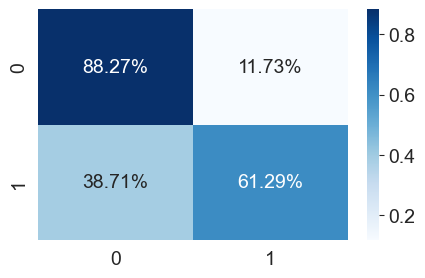

In [276]:
print('Accuracy for validating set is: ',(accuracy_score(val_targets_micro,model_micro.predict(X_val_micro))*100))
cm = confusion_matrix(val_targets_micro,model_micro.predict(X_val_micro), normalize='true')
sns.heatmap(cm,annot=True,fmt=".2%",cmap='Blues')
plt.show()

Accuracy for validating set is:  75.74850299401199
Confussion matrix over all the results is:


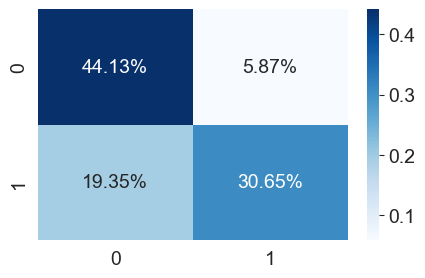

In [277]:
print('Accuracy for validating set is: ',(accuracy_score(val_targets_micro,model_micro.predict(X_val_micro))*100))
cm = confusion_matrix(val_targets_micro,model_micro.predict(X_val_micro), normalize='true')
sns.heatmap(cm/np.sum(cm),annot=True,fmt=".2%",cmap='Blues')
print('Confussion matrix over all the results is:')
plt.show()

In [278]:
test_preds_micro=model_micro.predict(X_test_micro)
accuracy_score(test_preds_micro,test_targets_micro)

0.7901234567901234

In [279]:
model_micro = RandomForestClassifier(n_estimators=35, max_depth=5,min_samples_split=7, max_leaf_nodes=10, random_state=42)   
model_micro.fit(X_train_micro,train_targets_micro)

RandomForestClassifier(max_depth=5, max_leaf_nodes=10, min_samples_split=7,
                       n_estimators=35, random_state=42)

In [280]:
train_preds_micro=model_micro.predict(X_train_micro)
train_preds_micro

array([0, 1, 0, ..., 0, 0, 0], dtype=int64)

In [281]:
accuracy_score(train_preds_micro,train_targets_micro)

0.7623564653020469

In [282]:
val_preds_micro=model_micro.predict(X_val_micro)
accuracy_score(val_preds_micro,val_targets_micro)

0.7290419161676647

In [283]:
#For validation set
print('Classification report for validation set')
print(classification_report(val_targets_micro,val_preds_micro))

Classification report for validation set
              precision    recall  f1-score   support

           0       0.68      0.92      0.78       358
           1       0.84      0.51      0.64       310

    accuracy                           0.73       668
   macro avg       0.76      0.71      0.71       668
weighted avg       0.76      0.73      0.72       668



In [284]:
test_preds_micro=model_RF.predict(X_test_micro)
accuracy_score(test_preds_micro,test_targets_micro)

0.7687991021324355

Logistic Regression

In [286]:
model_micro_LR=LogisticRegression(solver='liblinear', penalty = 'l2', C = 100)
    
model_micro_LR.fit(X_train_micro_LR,train_targets_micro_LR)


LogisticRegression(C=100, solver='liblinear')

In [289]:
train_preds_micro_LR=model_micro_LR.predict(X_train_micro_LR)
train_preds_micro_LR


array([0, 1, 0, ..., 1, 0, 1], dtype=int64)

In [290]:
accuracy_score(train_preds_micro_LR,train_preds_micro_LR)#Accuracy with training dataset, overfitting.

1.0

In [291]:
val_preds_micro_LR=model_micro_LR.predict(X_val_micro_LR)
accuracy_score(val_preds_micro_LR,val_targets_micro_LR)

0.7425149700598802

In [292]:
#For validation set
print('Classification report for validation set')
print(classification_report(val_targets_micro_LR,val_preds_micro_LR))

Classification report for validation set
              precision    recall  f1-score   support

           0       0.73      0.82      0.77       358
           1       0.76      0.65      0.70       310

    accuracy                           0.74       668
   macro avg       0.74      0.74      0.74       668
weighted avg       0.74      0.74      0.74       668



Accuracy for validation set is:  74.25149700598801
Confussion matrix


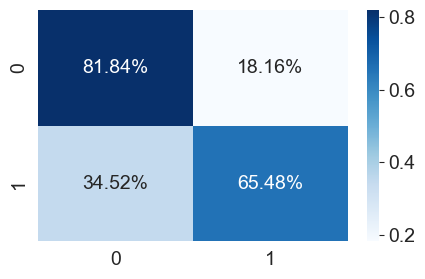

In [296]:
#We got 74% of accuracy for validation test, so lest draw its confussion matrix
print('Accuracy for validation set is: ',(accuracy_score(val_targets_micro_LR,val_preds_micro_LR))*100)
cm = confusion_matrix(val_targets_micro_LR,val_preds_micro_LR, normalize='true')
sns.heatmap(cm,annot=True,fmt=".2%",cmap='Blues')#2 decimals.
print('Confussion matrix')
plt.show()

In [295]:
test_preds_micro_LR=model_micro_LR.predict(X_test_micro_LR)
accuracy_score(test_preds_micro_LR,test_targets_micro_LR)

0.7732884399551067